# Creating Images with AI: A Diffusion Model

## Step 1: Setting Up Our Tools
First, let's install and import all the tools we need. Run this cell and wait for it to complete.

In [51]:
# Install required packages
%pip install einops
print("Package installation complete.")

# Import libraries
# --- Core PyTorch libraries ---
import torch  # Main deep learning framework
import torch.nn.functional as F  # Neural network functions like activation functions
import torch.nn as nn  # Neural network building blocks (layers)
from torch.optim import Adam  # Optimization algorithm for training

# --- Data handling ---
from torch.utils.data import Dataset, DataLoader, random_split   # For organizing and loading our data
import torchvision  # Library for computer vision datasets and models
import torchvision.transforms as transforms  # For preprocessing images

# --- Tensor manipulation ---
import random  # For random operations
from einops.layers.torch import Rearrange  # For reshaping tensors in neural networks
from einops import rearrange  # For elegant tensor reshaping operations
import numpy as np  # For numerical operations on arrays

# --- System utilities ---
import os  # For operating system interactions (used for CPU count)

# --- Visualization tools ---
import matplotlib.pyplot as plt  # For plotting images and graphs
from PIL import Image  # For image processing
from torchvision.utils import save_image, make_grid  # For saving and displaying image grids

# Set up device (GPU or CPU)
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
print(f"We'll be using: {device}")

# Check if actually using GPU
if device.type == "cuda":
    print(f"GPU name: {torch.cuda.get_device_name(0)}")
    print(f"GPU memory: {torch.cuda.get_device_properties(0).total_memory / 1e9:.2f} GB")
else:
    print("Note: Training will be much slower on CPU. Consider using Google Colab with GPU enabled.")

Package installation complete.
We'll be using: cuda
GPU name: NVIDIA A100-SXM4-40GB
GPU memory: 42.47 GB



###  REPRODUCIBILITY AND DEVICE SETUP

In [52]:
# Step 4: Set random seeds for reproducibility
SEED = 42  # Universal seed value for reproducibility
torch.manual_seed(SEED)          # PyTorch random number generator
np.random.seed(SEED)             # NumPy random number generator
random.seed(SEED)                # Python's built-in random number generator

print(f"Random seeds set to {SEED} for reproducible results")

# Configure CUDA for GPU operations if available
if torch.cuda.is_available():
    torch.cuda.manual_seed(SEED)       # GPU random number generator
    torch.cuda.manual_seed_all(SEED)   # All GPUs random number generator

    # Ensure deterministic GPU operations
    # Note: This slightly reduces performance but ensures results are reproducible
    torch.backends.cudnn.deterministic = True
    torch.backends.cudnn.benchmark = False

    try:
        # Check available GPU memory
        gpu_memory = torch.cuda.get_device_properties(0).total_memory / 1e9  # Convert to GB
        print(f"Available GPU Memory: {gpu_memory:.1f} GB")

        # Add recommendation based on memory
        if gpu_memory < 4:
            print("Warning: Low GPU memory. Consider reducing batch size if you encounter OOM errors.")
    except Exception as e:
        print(f"Could not check GPU memory: {e}")
else:
    print("No GPU detected. Training will be much slower on CPU.")
    print("If you're using Colab, go to Runtime > Change runtime type and select GPU.")

Random seeds set to 42 for reproducible results
Available GPU Memory: 42.5 GB


In [53]:
IMG_SIZE = 28
IMG_CH = 1
N_CLASSES = 10
BATCH_SIZE = 32
EPOCHS = 30

transform = transforms.Compose([
    transforms.ToTensor(),
    transforms.Normalize((0.5,), (0.5,))
])

# Load training dataset
dataset = torchvision.datasets.FashionMNIST(
    root='./data',
    train=True,
    download=True,
    transform=transform
)

# Load test dataset
test_dataset = torchvision.datasets.FashionMNIST(
    root='./data',
    train=False,             # Test set
    download=True,
    transform=transform
)


In [54]:
# Validating Dataset Selection
if 'dataset' and 'test_dataset' not in locals():
    raise ValueError(
        "Dataset not found! Please load the Fashion-MNIST dataset first using:\n"
        "dataset = torchvision.datasets.FashionMNIST(root='./data', train=True, download=True, transform=transform)"
    )


# Validate GPU memory requirements
if torch.cuda.is_available():
    print("CUDA is available")
    print(f"Total GPU memory: {torch.cuda.get_device_properties(0).total_memory:,} bytes")
    print(f"Total GPU memory: {torch.cuda.get_device_properties(0).total_memory / 1024**3:.2f} GB")
    print(f"GPU name: {torch.cuda.get_device_properties(0).name}")
else:
    print("CUDA is not available")


CUDA is available
Total GPU memory: 42,474,471,424 bytes
Total GPU memory: 39.56 GB
GPU name: NVIDIA A100-SXM4-40GB


In [55]:
# Check sample batch properties
sample_batch = DataLoader(dataset, batch_size=1)
image, label = next(iter(sample_batch))
print(f"Image shape: {image.shape}")
print(f"Label: {label}")
if hasattr(image, 'dtype'):
    print(f"Image dtype: {image.dtype}")
    print(f"Image min: {image.min()}, max: {image.max()}")

# Train-validation split (80% train, 20% validation)
train_size = int(0.8 * len(dataset))
val_size = len(dataset) - train_size

train_dataset, val_dataset = random_split(dataset, [train_size, val_size])

# Create dataloaders for training and validation
NUM_WORKERS = 8
train_dataloader = DataLoader(train_dataset, batch_size=BATCH_SIZE, shuffle=True, num_workers=NUM_WORKERS)
val_dataloader = DataLoader(val_dataset, batch_size=BATCH_SIZE, shuffle=True, num_workers=NUM_WORKERS)

Image shape: torch.Size([1, 1, 28, 28])
Label: tensor([9])
Image dtype: torch.float32
Image min: -1.0, max: 1.0


## Step 2: Building Our Model Components

Now we'll create the building blocks of our AI model. Think of these like LEGO pieces that we'll put together to make our number generator:

- GELUConvBlock: The basic building block that processes images
- DownBlock: Makes images smaller while finding important features
- UpBlock: Makes images bigger again while keeping the important features
- Other blocks: Help the model understand time and what number to generate

In [56]:
# Basic building block that processes images
class GELUConvBlock(nn.Module):
    def __init__(self, in_ch, out_ch, group_size):
        super(GELUConvBlock, self).__init__()
        self.block = nn.Sequential(
            nn.Conv2d(in_ch, out_ch, kernel_size=3, stride=1, padding=1, bias=False),
            nn.GroupNorm(num_groups=group_size, num_channels=out_ch),
            nn.GELU()
        )
        # Check that group_size is compatible with out_ch
        if out_ch % group_size != 0:
            print(f"Warning: out_ch ({out_ch}) is not divisible by group_size ({group_size})")
            # Adjust group_size to be compatible
            group_size = min(group_size, out_ch)
            while out_ch % group_size != 0:
                group_size -= 1
            print(f"Adjusted group_size to {group_size}")

        self.block = nn.Sequential(
            nn.Conv2d(in_ch, out_ch, kernel_size=3, stride=1, padding=1, bias=False),
            nn.GroupNorm(num_groups=group_size, num_channels=out_ch),
            nn.GELU()
        )

    def forward(self, x):
        return self.block(x)

In [57]:
# Rearranges pixels to downsample the image (2x reduction in spatial dimensions) and increases channels by 4x
class RearrangePoolBlock(nn.Module):
    # Removed in_chs and group_size as it only performs rearrangement
    def __init__(self):
        super().__init__()
        # Rearrange from [b, c, h, w] to [b, c * p1 * p2, h // p1, w // p2]
        # with p1=2, p2=2, this becomes [b, c * 4, h // 2, w // 2]
        self.rearrange = Rearrange('b c (h p1) (w p2) -> b (c p1 p2) h w', p1=2, p2=2)

    def forward(self, x):
        # Apply rearrange to downsample spatial dimensions and increase channels
        x = self.rearrange(x)
        # The channel reduction will be handled by a convolution in the DownBlock after pooling
        return x

In [58]:
#Let's implement the downsampling block for our U-Net architecture:
class DownBlock(nn.Module):
    def __init__(self, in_chs, out_chs, group_size):
        super().__init__()

        self.conv_blocks = nn.Sequential(
            GELUConvBlock(in_chs, out_chs, group_size),  # First conv block changes channel dimensions
            GELUConvBlock(out_chs, out_chs, group_size),  # Second conv block processes features
        )
        # The pooling block now only performs spatial rearrangement and channel increase (4x)
        self.pool = RearrangePoolBlock() # Use the updated RearrangePoolBlock

        # Add a convolution after pooling to reduce the channels to the desired out_chs
        # The input channels will be out_chs * 4 (from pooling), output will be out_chs
        self.channel_reduction_conv = GELUConvBlock(out_chs * 4, out_chs, group_size)


        # Log the configuration for debugging
        print(f"Created DownBlock: in_chs={in_chs}, out_chs={out_chs}, spatial_reduction=2x")

    def forward(self, x):
        # Apply convolutions
        skip = self.conv_blocks(x) # This is the feature map before pooling (used for skip connection)
        # Remove debug print: print(f"DownBlock: skip shape after conv_blocks {skip.shape}")
        # Apply pooling for the main path (spatial reduction, channel increase)
        pooled_x_rearranged = self.pool(skip) # pooled_x_rearranged has skip.channels * 4 channels
        # Remove debug print: print(f"DownBlock: pooled_x_rearranged shape after pool {pooled_x_rearranged.shape}")
        # Apply convolution to reduce channels after pooling
        pooled_x = self.channel_reduction_conv(pooled_x_rearranged) # pooled_x has out_chs channels
        # Remove debug print: print(f"DownBlock: pooled_x shape after channel reduction {pooled_x.shape}")

        # Return the downsampled feature map and the feature map before pooling (for skip connection)
        return pooled_x, skip # Return pooled_x and skip (at higher spatial resolution relative to pooled_x)

In [59]:
class RearrangeUpsampleBlock(nn.Module):
    def __init__(self, channels, group_size):
        super().__init__()
        self.channels = channels
        self.group_size = group_size

    def forward(self, x):
        return nn.functional.interpolate(x, scale_factor=2, mode='nearest')


#Now let's implement the upsampling block for our U-Net architecture:
class UpBlock(nn.Module):
    def __init__(self, in_chs, skip_chs, out_chs, group_size):
        super().__init__()
        self.upsample = RearrangeUpsampleBlock(in_chs, group_size)
        combined_chs = in_chs + skip_chs
        self.conv1 = GELUConvBlock(combined_chs, out_chs, group_size)
        self.conv2 = GELUConvBlock(out_chs, out_chs, group_size)
        print(f"Created UpBlock: in_chs={in_chs}, skip_chs={skip_chs}, out_chs={out_chs}")

    def forward(self, x, skip):
        x = self.upsample(x)
        x = torch.cat([x, skip], dim=1)
        x = self.conv1(x)
        x = self.conv2(x)
        return x



In [60]:
# Here we implement the time embedding block for our U-Net architecture:
# Helps the model understand time steps in diffusion process
class SinusoidalPositionEmbedBlock(nn.Module):
    def __init__(self, dim):
        super().__init__()
        self.dim = dim

    def forward(self, time):
        device = time.device
        half_dim = self.dim // 2
        embeddings = torch.log(torch.tensor(10000.0, device=device)) / (half_dim - 1)
        embeddings = torch.exp(torch.arange(half_dim, device=device) * -embeddings)
        embeddings = time[:, None] * embeddings[None, :]
        embeddings = torch.cat((embeddings.sin(), embeddings.cos()), dim=-1)
        return embeddings



In [61]:
# Helps the model understand which number/image to draw (class conditioning)
class EmbedBlock(nn.Module):
    def __init__(self, input_dim, emb_dim):
        super().__init__()
        self.input_dim = input_dim
        # The embedding layer expects Long or Int tensor as input
        self.embedding = nn.Embedding(input_dim, emb_dim)

        # Create embedding layers with GELU activation
        # Two-layer MLP to create rich embeddings
        self.model = nn.Sequential(
            nn.Linear(emb_dim, emb_dim), # Changed input dim here
            nn.GELU(),
            nn.Linear(emb_dim, emb_dim),
            nn.GELU(),
            # Unflatten to add spatial dimensions for broadcasting with feature maps
            # Reshapes from [B, emb_dim] to [B, emb_dim, 1, 1] for broadcasting
            nn.Unflatten(dim=1, unflattened_size=(emb_dim, 1, 1))
        )

        # Initialize weights properly
        self._init_weights()

        print(f"Created EmbedBlock: input_dim={input_dim}, emb_dim={emb_dim}")

    def _init_weights(self):
        for module in self.modules():
            if isinstance(module, nn.Linear):
                # Xavier/Glorot initialization for linear layers
                nn.init.xavier_uniform_(module.weight)
                if module.bias is not None:
                    nn.init.zeros_(module.bias)

    def forward(self, x):
        # Handle different input formats and ensure input is Long type for embedding
        if x.dim() == 1:  # Class indices [B]
            x = x.long() # Ensure it's Long type
        elif x.dim() == 2 and x.shape[1] == 1:  # Class indices [B, 1]
            x = x.squeeze(1).long() # Ensure it's Long type after squeezing
        else: # Assume one-hot encoding or other format, try to get indices
            try:
                # If it's one-hot, convert to indices
                x = torch.argmax(x, dim=-1).long()
            except Exception as e:
                raise TypeError(f"EmbedBlock received unexpected input shape/type: {x.shape}, {x.dtype}. Error: {e}")


        # Ensure input has correct shape for embedding layer
        x = x.view(-1) # Embedding layer expects [B]

        # Generate embeddings using the embedding layer first
        embedded_x = self.embedding(x) # [B, emb_dim]

        # Pass the embeddings through the MLP
        return self.model(embedded_x)

In [62]:
class UNet(nn.Module):
    def __init__(self, T, img_ch, img_size, down_chs, t_embed_dim, c_embed_dim):
        super().__init__()

        # Project time and class embeddings to match the channel dimension of the feature map
        # at the point where they are added (which is down_chs[-1])
        self.time_embed_proj = nn.Linear(t_embed_dim, down_chs[-1])
        self.class_embed_proj = nn.Linear(c_embed_dim, down_chs[-1])

        # Time embedding
        self.time_mlp = nn.Sequential(
            SinusoidalPositionEmbedBlock(t_embed_dim),
            nn.Linear(t_embed_dim, t_embed_dim),
            nn.GELU()
        )

        # Class embedding
        self.class_mlp = EmbedBlock(N_CLASSES, c_embed_dim)

        # Initial convolution
        self.init_conv = GELUConvBlock(img_ch, down_chs[0], group_size=8)

        # Downsampling path
        self.downs = nn.ModuleList()
        # The downsampling blocks reduce spatial dimensions and increase channels
        for i in range(len(down_chs) - 1):
            self.downs.append(DownBlock(down_chs[i], down_chs[i+1], group_size=8))

        # Middle blocks (2x conv)
        self.middle = nn.Sequential(
            GELUConvBlock(down_chs[-1], down_chs[-1], group_size=8),
            GELUConvBlock(down_chs[-1], down_chs[-1], group_size=8)
        )

        # Upsampling path
        self.ups = nn.ModuleList()
        num_down_levels = len(down_chs) - 1
        for i in range(num_down_levels):
            in_ch = down_chs[num_down_levels - i] # Channels from the level below (or middle block for i=0)
            skip_ch = down_chs[num_down_levels - i] # Channels from the corresponding skip
            out_ch = down_chs[num_down_levels - 1 - i] # Output channels for this stage
            self.ups.append(UpBlock(in_ch, skip_ch, out_ch, group_size=8))


        # Final projection
        self.final_conv = nn.Conv2d(down_chs[0], img_ch, kernel_size=1)

        print(f"Created UNet with {len(down_chs)} scale levels")
        print(f"Channel dimensions: {down_chs}")

    def forward(self, x, t, c, c_mask):
        # Time embedding
        t_embed = self.time_mlp(t)  # [B, t_embed_dim]

        # Class embedding
        # Ensure class labels are correctly formatted for the EmbedBlock
        if c.dim() > 1 and c.size(1) > 1:
             c = torch.argmax(c, dim=1) # Convert one-hot to class index if needed
        c = c.long()

        c_embed = self.class_mlp(c)  # [B, c_embed_dim, 1, 1]
        c_mask = c_mask.view(-1, 1, 1, 1) # Reshape mask to match c_embed dimensions
        c_embed = c_embed * c_mask # Mask if doing class-conditional generation

        t_embed = self.time_embed_proj(t_embed)
        c_embed = self.class_embed_proj(c_embed.squeeze(-1).squeeze(-1)).unsqueeze(-1).unsqueeze(-1)

        skips = []
        current_features = self.init_conv(x) # Initial conv output (32 channels) - input to the first down block
        for i, down in enumerate(self.downs):
            pooled_features, skip_features = down(current_features) # down returns (pooled_x, skip)
            skips.append(skip_features.clone()) # Add a clone of the skip connection before pooling
            current_features = pooled_features # Update current_features to the pooled output

        x = current_features

        # Middle processing
        x = self.middle(x) # x is still 128 channels
        print(f"Shapes before adding embeddings: x shape {x.shape}, t_embed shape {t_embed.shape}, c_embed shape {c_embed.shape}")

        # Explicitly reshape t_embed for broadcasting
        t_embed_reshaped = t_embed.unsqueeze(-1).unsqueeze(-1) # Reshape [B, C] to [B, C, 1, 1]
        print(f"t_embed_reshaped shape: {t_embed_reshaped.shape}")

        # Add embeddings
        x = x + t_embed_reshaped
        print(f"Shape after adding t_embed_reshaped: {x.shape}")
        x = x + c_embed
        print(f"Shape after adding c_embed: {x.shape}")
        for i, up in enumerate(self.ups):
            skip = skips[-(i+1)] # Get skips in reverse order: skips[-1], skips[-2], ...
            # Remove debug print: print(f"UNet forward (Up loop i={i}): x shape before UpBlock {x.shape}, skip shape {skip.shape}")
            x = up(x, skip) # Pass current features and the corresponding skip to the up block

        return self.final_conv(x) # final_conv takes 32 channels, outputs img_ch

## Step 3: Setting Up The Diffusion Process

Now we'll create the process of adding and removing noise from images. Think of it like:
1. Adding fog: Slowly making the image more and more blurry until you can't see it
2. Removing fog: Teaching the AI to gradually make the image clearer
3. Controlling the process: Making sure we can generate specific numbers we want

In [63]:
# Set up the noise schedule
n_steps = 50  # How many steps to go from clear image to noise
beta_start = 0.00085  # Starting noise level (small)
beta_end = 0.012      # Ending noise level (larger)

# Create schedule of gradually increasing noise levels
beta = torch.linspace(beta_start, beta_end, n_steps).clamp(0.0001, 0.9999).to(device)

# Calculate important values used in diffusion equations
alpha = 1 - beta  # Portion of original image to keep at each step
alpha_bar = torch.cumprod(alpha, dim=0)  # Cumulative product of alphas
sqrt_alpha_bar = torch.sqrt(alpha_bar)  # For scaling the original image
sqrt_one_minus_alpha_bar = torch.sqrt(1 - alpha_bar)  # For scaling the noise


In [64]:
# Function to add noise to images (forward diffusion process)
def add_noise(x_0, t):
    noise = torch.randn_like(x_0)  # Gaussian noise
    sqrt_alpha_bar_t = sqrt_alpha_bar[t].reshape(-1, 1, 1, 1)
    sqrt_one_minus_alpha_bar_t = sqrt_one_minus_alpha_bar[t].reshape(-1, 1, 1, 1)
    x_t = sqrt_alpha_bar_t * x_0 + sqrt_one_minus_alpha_bar_t * noise
    return x_t, noise

In [65]:
# Function to remove noise from images (reverse diffusion process)
@torch.no_grad()  # Don't track gradients during sampling (inference only)
def remove_noise(x_t, t, model, c, c_mask):
    # Predict the noise in the image using our model
    predicted_noise = model(x_t, t, c, c_mask)

    # Get noise schedule values for the current timestep - ensure these are defined
    alpha_t = alpha[t].reshape(-1, 1, 1, 1)
    beta_t = beta[t].reshape(-1, 1, 1, 1)
    alpha_bar_t = alpha_bar[t].reshape(-1, 1, 1, 1) # Reordered slightly
    sqrt_alpha_bar_t = sqrt_alpha_bar[t].reshape(-1, 1, 1, 1)
    sqrt_one_minus_alpha_bar_t = sqrt_one_minus_alpha_bar[t].reshape(-1, 1, 1, 1)


    # Special case: if we're at the first timestep (t=0), we're done
    if t[0] == 0:
        # At t=0, there is no noise to remove, the image is generated
        return x_t
    else:
        # Calculate the predicted previous noisy image (x_{t-1})
        # based on the model's noise prediction and the diffusion equation
        mean = (1 / torch.sqrt(alpha_t)) * (
            x_t - (beta_t / sqrt_one_minus_alpha_bar_t) * predicted_noise
        )
        # Add a small amount of noise for stochasticity (except at the last step)
        # This noise term is present in the reverse diffusion equation
        # We need to define 'z' here as a new noise sample for the reverse step
        z = torch.randn_like(x_t) # Sample new noise
        return mean + torch.sqrt(beta_t) * z # Use the new noise sample z

In [66]:
def show_noise_progression(image, num_steps=5):
    """
    Visualization function to show how noise progressively affects an image.

    Args:
        image (torch.Tensor): Original clean image [C, H, W]
        num_steps (int): Number of noise levels to show
    """
    plt.figure(figsize=(15, 3))
    plt.subplot(1, num_steps, 1)

    # Show original image
    if IMG_CH == 1:  # Grayscale
        plt.imshow(image[0].cpu(), cmap='gray')
    else:  # RGB
        img = image.permute(1, 2, 0).cpu()
        if img.min() < 0:
            img = (img + 1) / 2
        plt.imshow(img)
    plt.title('Original')
    plt.axis('off')

    for i in range(1, num_steps):
        # Get timestep
        t_idx = int((i / num_steps) * n_steps)
        t = torch.tensor([t_idx], device=device)

        # Add noise at this step
        noisy_image, _ = add_noise(image.unsqueeze(0), t)

        plt.subplot(1, num_steps, i+1)
        if IMG_CH == 1:
            plt.imshow(noisy_image[0][0].cpu(), cmap='gray')
        else:
            img = noisy_image[0].permute(1, 2, 0).cpu()
            if img.min() < 0:
                img = (img + 1) / 2
            plt.imshow(img)
        plt.title(f'{int((i / num_steps) * 100)}% Noise')
        plt.axis('off')

    plt.tight_layout()
    plt.show()


## Step 4: Training Our Model

Now we'll teach our AI to generate images. This process:
1. Takes a clear image
2. Adds random noise to it
3. Asks our AI to predict what noise was added
4. Helps our AI learn from its mistakes

This will take a while, but we'll see progress as it learns!

In [67]:
# Create our model and move it to GPU if available
model = UNet(
    T=n_steps,                 # Number of diffusion time steps
    img_ch=IMG_CH,             # Number of channels in our images (1 for grayscale, 3 for RGB)
    img_size=IMG_SIZE,         # Size of input images (28 for MNIST, 32 for CIFAR-10)
    down_chs=(32, 64, 128),    # Channel dimensions for each downsampling level
    t_embed_dim=32,             # Dimension for time step embeddings
    c_embed_dim=N_CLASSES      # Number of classes for conditioning
).to(device)

# Print model summary
print(f"\n{'='*50}")
print(f"MODEL ARCHITECTURE SUMMARY")
print(f"{'='*50}")
print(f"Input resolution: {IMG_SIZE}x{IMG_SIZE}")
print(f"Input channels: {IMG_CH}")
print(f"Time steps: {n_steps}")
print(f"Condition classes: {N_CLASSES}")
print(f"GPU acceleration: {'Yes' if device.type == 'cuda' else 'No'}")

def count_parameters(model):
    total = sum(p.numel() for p in model.parameters())
    trainable = sum(p.numel() for p in model.parameters() if p.requires_grad)
    print(f"\nTotal parameters: {total:,}")
    print(f"Trainable parameters: {trainable:,}")

def estimate_model_memory(model):
    param_count = sum(p.numel() for p in model.parameters())
    bytes_per_param = 4  # assuming float32
    total_MB = param_count * bytes_per_param / (1024 ** 2)
    print(f"Estimated model size: {total_MB:.2f} MB")

count_parameters(model)
estimate_model_memory(model)

def check_dataset_stats(dataloader, num_batches=1):
    all_vals = []
    for i, (images, labels) in enumerate(dataloader):
        if i >= num_batches:
            break
        all_vals.append(images)

    batch = torch.cat(all_vals, dim=0)
    print(f"Image min: {batch.min().item():.4f}")
    print(f"Image max: {batch.max().item():.4f}")
    print(f"Image dtype: {batch.dtype}")

initial_lr = 0.0001  # Starting learning rate
weight_decay = 1e-5  # L2 regularization to prevent overfitting

optimizer = Adam(
    model.parameters(),
    lr=initial_lr,
    weight_decay=weight_decay
)

scheduler = torch.optim.lr_scheduler.ReduceLROnPlateau(
    optimizer,
    mode='min',              # Reduce LR when monitored value stops decreasing
    factor=0.5,              # Multiply LR by this factor
    patience=10,              # Number of epochs with no improvement after which LR will be reduced
    min_lr=1e-6              # Lower bound on the learning rate
)

# STUDENT EXPERIMENT:
# Try different channel configurations and see how they affect:
# 1. Model size (parameter count)
# 2. Training time
# 3. Generated image quality
#
# Suggestions:
# - Smaller: down_chs=(16, 32, 64)
# - Larger: down_chs=(64, 128, 256, 512)

Created EmbedBlock: input_dim=10, emb_dim=10
Created DownBlock: in_chs=32, out_chs=64, spatial_reduction=2x
Created DownBlock: in_chs=64, out_chs=128, spatial_reduction=2x
Created UpBlock: in_chs=128, skip_chs=128, out_chs=64
Created UpBlock: in_chs=64, skip_chs=64, out_chs=32
Created UNet with 3 scale levels
Channel dimensions: (32, 64, 128)

MODEL ARCHITECTURE SUMMARY
Input resolution: 28x28
Input channels: 1
Time steps: 50
Condition classes: 10
GPU acceleration: Yes

Total parameters: 1,548,513
Trainable parameters: 1,548,513
Estimated model size: 5.91 MB


In [68]:
# Define helper functions needed for training and evaluation
def validate_model_parameters(model):
    """
    Counts model parameters and estimates memory usage.
    """
    total_params = sum(p.numel() for p in model.parameters())
    trainable_params = sum(p.numel() for p in model.parameters() if p.requires_grad)

    print(f"Total parameters: {total_params:,}")
    print(f"Trainable parameters: {trainable_params:,}")

    # Estimate memory requirements (very approximate)
    param_memory = total_params * 4 / (1024 ** 2)  # MB for params (float32)
    grad_memory = trainable_params * 4 / (1024 ** 2)  # MB for gradients
    buffer_memory = param_memory * 2  # Optimizer state, forward activations, etc.

    print(f"Estimated GPU memory usage: {param_memory + grad_memory + buffer_memory:.1f} MB")

# Define helper functions for verifying data ranges
def verify_data_range(dataloader, name="Dataset"):
    """
    Verifies the range and integrity of the data.
    """
    batch = next(iter(dataloader))[0]
    print(f"\n{name} range check:")
    print(f"Shape: {batch.shape}")
    print(f"Data type: {batch.dtype}")
    print(f"Min value: {batch.min().item():.2f}")
    print(f"Max value: {batch.max().item():.2f}")
    print(f"Contains NaN: {torch.isnan(batch).any().item()}")
    print(f"Contains Inf: {torch.isinf(batch).any().item()}")

# Define helper functions for generating samples during training
def generate_samples(model, n_samples=10):
    """
    Generates sample images using the model for visualization during training.
    """
    model.eval()
    with torch.no_grad():
        samples = []
        for class_label in range(min(n_samples, N_CLASSES)):
            x = torch.randn(1, IMG_CH, IMG_SIZE, IMG_SIZE).to(device)

            c = torch.tensor([class_label]).to(device)
            c_one_hot = F.one_hot(c, N_CLASSES).float().to(device)
            c_mask = torch.ones_like(c.unsqueeze(-1)).to(device)

            for t in range(n_steps - 1, -1, -1):
                t_batch = torch.full((1,), t).to(device)
                x = remove_noise(x, t_batch, model, c_one_hot, c_mask)

            samples.append(x)

        samples = torch.cat(samples, dim=0)
        grid = make_grid(samples, nrow=min(n_samples, 5), normalize=True)

        plt.figure(figsize=(10, 4))

        if IMG_CH == 1:
            plt.imshow(grid[0].cpu(), cmap='gray')
        else:
            plt.imshow(grid.permute(1, 2, 0).cpu())

        plt.axis('off')
        plt.title('Generated FashionMNIST Samples')
        plt.show()

# Define helper functions for safely saving models
def safe_save_model(model, path, optimizer=None, epoch=None, best_loss=None):
    """
    Safely saves model with error handling and backup.
    """
    try:
        save_dict = {
            'model_state_dict': model.state_dict(),
        }

        if optimizer is not None:
            save_dict['optimizer_state_dict'] = optimizer.state_dict()
        if epoch is not None:
            save_dict['epoch'] = epoch
        if best_loss is not None:
            save_dict['best_loss'] = best_loss

        if os.path.exists(path):
            backup_path = path + '.backup'
            try:
                os.replace(path, backup_path)
                print(f"Created backup at {backup_path}")
            except Exception as e:
                print(f"Warning: Could not create backup - {e}")

        torch.save(save_dict, path)
        print(f"Model successfully saved to {path}")

    except Exception as e:
        print(f"Error saving model: {e}")
        print("Attempting emergency save...")

        try:
            emergency_path = path + '.emergency'
            torch.save(model.state_dict(), emergency_path)
            print(f"Emergency save successful: {emergency_path}")
        except:
            print("Emergency save failed. Could not save model.")


In [69]:
def train_step(x, c):
    t = torch.randint(0, n_steps, (x.shape[0],), device=device)
    x_t, noise = add_noise(x, t)

    # Fix label format
    if c.dim() > 1 and c.size(1) > 1:
        c = torch.argmax(c, dim=1)
    c = c.long().to(device)

    # Create a mask of ones (no masking)
    c_mask = torch.ones((c.shape[0], 1), device=device)

    predicted_noise = model(x_t, t, c, c_mask)
    loss = F.mse_loss(predicted_noise, noise)
    return loss


STARTING TRAINING

Epoch 1/30
--------------------
Shapes before adding embeddings: x shape torch.Size([32, 128, 7, 7]), t_embed shape torch.Size([32, 128]), c_embed shape torch.Size([32, 128, 1, 1])
t_embed_reshaped shape: torch.Size([32, 128, 1, 1])
Shape after adding t_embed_reshaped: torch.Size([32, 128, 7, 7])
Shape after adding c_embed: torch.Size([32, 128, 7, 7])
  Step 0/1500, Loss: 1.2003
Shapes before adding embeddings: x shape torch.Size([32, 128, 7, 7]), t_embed shape torch.Size([32, 128]), c_embed shape torch.Size([32, 128, 1, 1])
t_embed_reshaped shape: torch.Size([32, 128, 1, 1])
Shape after adding t_embed_reshaped: torch.Size([32, 128, 7, 7])
Shape after adding c_embed: torch.Size([32, 128, 7, 7])
Shapes before adding embeddings: x shape torch.Size([32, 128, 7, 7]), t_embed shape torch.Size([32, 128]), c_embed shape torch.Size([32, 128, 1, 1])
t_embed_reshaped shape: torch.Size([32, 128, 1, 1])
Shape after adding t_embed_reshaped: torch.Size([32, 128, 7, 7])
Shape afte

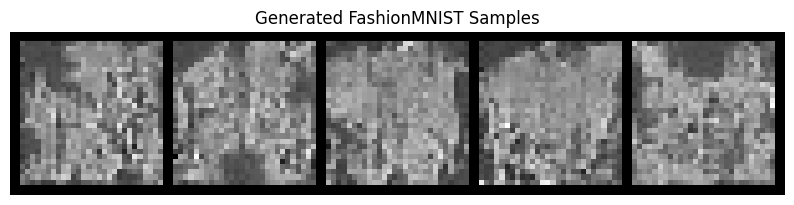

Shapes before adding embeddings: x shape torch.Size([32, 128, 7, 7]), t_embed shape torch.Size([32, 128]), c_embed shape torch.Size([32, 128, 1, 1])
t_embed_reshaped shape: torch.Size([32, 128, 1, 1])
Shape after adding t_embed_reshaped: torch.Size([32, 128, 7, 7])
Shape after adding c_embed: torch.Size([32, 128, 7, 7])
Shapes before adding embeddings: x shape torch.Size([32, 128, 7, 7]), t_embed shape torch.Size([32, 128]), c_embed shape torch.Size([32, 128, 1, 1])
t_embed_reshaped shape: torch.Size([32, 128, 1, 1])
Shape after adding t_embed_reshaped: torch.Size([32, 128, 7, 7])
Shape after adding c_embed: torch.Size([32, 128, 7, 7])
Shapes before adding embeddings: x shape torch.Size([32, 128, 7, 7]), t_embed shape torch.Size([32, 128]), c_embed shape torch.Size([32, 128, 1, 1])
t_embed_reshaped shape: torch.Size([32, 128, 1, 1])
Shape after adding t_embed_reshaped: torch.Size([32, 128, 7, 7])
Shape after adding c_embed: torch.Size([32, 128, 7, 7])
Shapes before adding embeddings: x

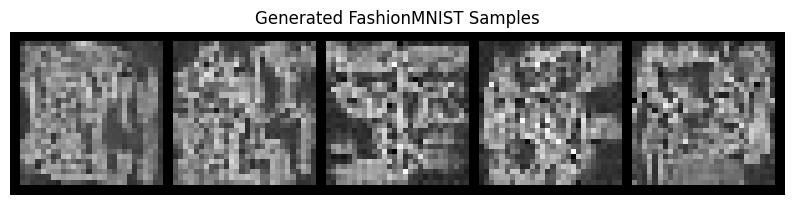

Streaming output truncated to the last 5000 lines.
Shape after adding t_embed_reshaped: torch.Size([32, 128, 7, 7])
Shape after adding c_embed: torch.Size([32, 128, 7, 7])
Shapes before adding embeddings: x shape torch.Size([32, 128, 7, 7]), t_embed shape torch.Size([32, 128]), c_embed shape torch.Size([32, 128, 1, 1])
t_embed_reshaped shape: torch.Size([32, 128, 1, 1])
Shape after adding t_embed_reshaped: torch.Size([32, 128, 7, 7])
Shape after adding c_embed: torch.Size([32, 128, 7, 7])
Shapes before adding embeddings: x shape torch.Size([32, 128, 7, 7]), t_embed shape torch.Size([32, 128]), c_embed shape torch.Size([32, 128, 1, 1])
t_embed_reshaped shape: torch.Size([32, 128, 1, 1])
Shape after adding t_embed_reshaped: torch.Size([32, 128, 7, 7])
Shape after adding c_embed: torch.Size([32, 128, 7, 7])
Shapes before adding embeddings: x shape torch.Size([32, 128, 7, 7]), t_embed shape torch.Size([32, 128]), c_embed shape torch.Size([32, 128, 1, 1])
t_embed_reshaped shape: torch.Size(

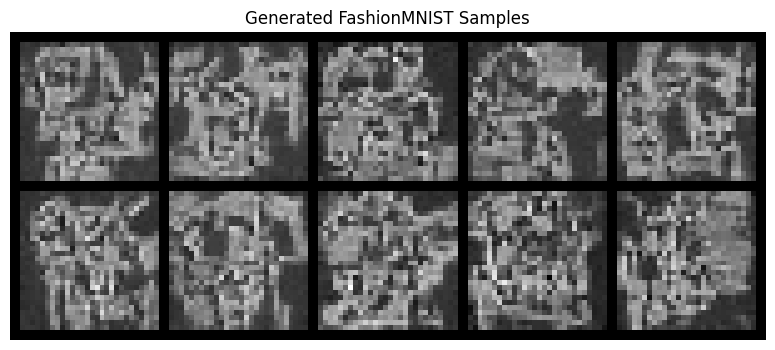

Created backup at best_diffusion_model.pt.backup
Model successfully saved to best_diffusion_model.pt
✓ New best model saved! (Val Loss: 0.1733)

Epoch 2/30
--------------------
Shapes before adding embeddings: x shape torch.Size([32, 128, 7, 7]), t_embed shape torch.Size([32, 128]), c_embed shape torch.Size([32, 128, 1, 1])
t_embed_reshaped shape: torch.Size([32, 128, 1, 1])
Shape after adding t_embed_reshaped: torch.Size([32, 128, 7, 7])
Shape after adding c_embed: torch.Size([32, 128, 7, 7])
  Step 0/1500, Loss: 0.1689
Shapes before adding embeddings: x shape torch.Size([32, 128, 7, 7]), t_embed shape torch.Size([32, 128]), c_embed shape torch.Size([32, 128, 1, 1])
t_embed_reshaped shape: torch.Size([32, 128, 1, 1])
Shape after adding t_embed_reshaped: torch.Size([32, 128, 7, 7])
Shape after adding c_embed: torch.Size([32, 128, 7, 7])
Shapes before adding embeddings: x shape torch.Size([32, 128, 7, 7]), t_embed shape torch.Size([32, 128]), c_embed shape torch.Size([32, 128, 1, 1])
t_

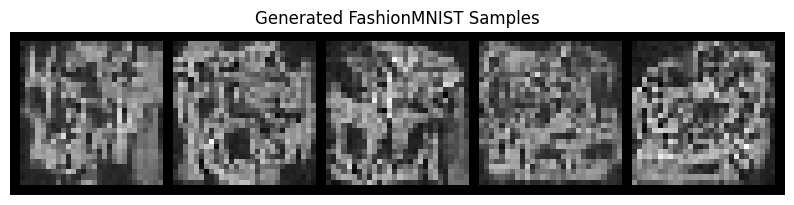

Shapes before adding embeddings: x shape torch.Size([32, 128, 7, 7]), t_embed shape torch.Size([32, 128]), c_embed shape torch.Size([32, 128, 1, 1])
t_embed_reshaped shape: torch.Size([32, 128, 1, 1])
Shape after adding t_embed_reshaped: torch.Size([32, 128, 7, 7])
Shape after adding c_embed: torch.Size([32, 128, 7, 7])
Shapes before adding embeddings: x shape torch.Size([32, 128, 7, 7]), t_embed shape torch.Size([32, 128]), c_embed shape torch.Size([32, 128, 1, 1])
t_embed_reshaped shape: torch.Size([32, 128, 1, 1])
Shape after adding t_embed_reshaped: torch.Size([32, 128, 7, 7])
Shape after adding c_embed: torch.Size([32, 128, 7, 7])
Shapes before adding embeddings: x shape torch.Size([32, 128, 7, 7]), t_embed shape torch.Size([32, 128]), c_embed shape torch.Size([32, 128, 1, 1])
t_embed_reshaped shape: torch.Size([32, 128, 1, 1])
Shape after adding t_embed_reshaped: torch.Size([32, 128, 7, 7])
Shape after adding c_embed: torch.Size([32, 128, 7, 7])
Shapes before adding embeddings: x

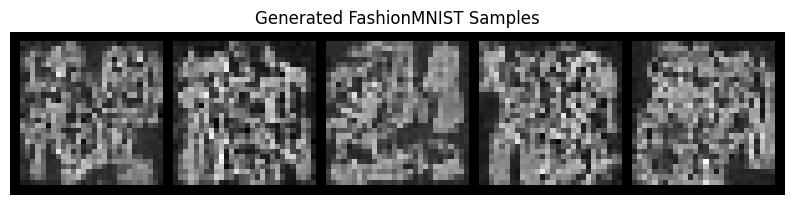

Streaming output truncated to the last 5000 lines.
Shape after adding c_embed: torch.Size([32, 128, 7, 7])
Shapes before adding embeddings: x shape torch.Size([32, 128, 7, 7]), t_embed shape torch.Size([32, 128]), c_embed shape torch.Size([32, 128, 1, 1])
t_embed_reshaped shape: torch.Size([32, 128, 1, 1])
Shape after adding t_embed_reshaped: torch.Size([32, 128, 7, 7])
Shape after adding c_embed: torch.Size([32, 128, 7, 7])
Shapes before adding embeddings: x shape torch.Size([32, 128, 7, 7]), t_embed shape torch.Size([32, 128]), c_embed shape torch.Size([32, 128, 1, 1])
t_embed_reshaped shape: torch.Size([32, 128, 1, 1])
Shape after adding t_embed_reshaped: torch.Size([32, 128, 7, 7])
Shape after adding c_embed: torch.Size([32, 128, 7, 7])
Shapes before adding embeddings: x shape torch.Size([32, 128, 7, 7]), t_embed shape torch.Size([32, 128]), c_embed shape torch.Size([32, 128, 1, 1])
t_embed_reshaped shape: torch.Size([32, 128, 1, 1])
Shape after adding t_embed_reshaped: torch.Size(

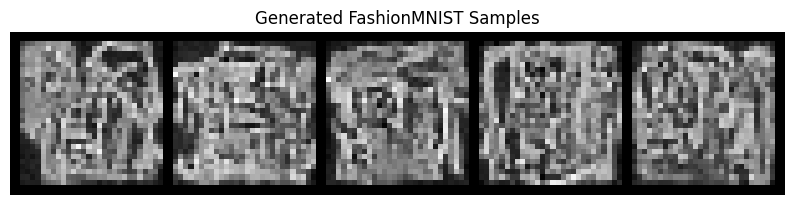

Shapes before adding embeddings: x shape torch.Size([32, 128, 7, 7]), t_embed shape torch.Size([32, 128]), c_embed shape torch.Size([32, 128, 1, 1])
t_embed_reshaped shape: torch.Size([32, 128, 1, 1])
Shape after adding t_embed_reshaped: torch.Size([32, 128, 7, 7])
Shape after adding c_embed: torch.Size([32, 128, 7, 7])
Shapes before adding embeddings: x shape torch.Size([32, 128, 7, 7]), t_embed shape torch.Size([32, 128]), c_embed shape torch.Size([32, 128, 1, 1])
t_embed_reshaped shape: torch.Size([32, 128, 1, 1])
Shape after adding t_embed_reshaped: torch.Size([32, 128, 7, 7])
Shape after adding c_embed: torch.Size([32, 128, 7, 7])
Shapes before adding embeddings: x shape torch.Size([32, 128, 7, 7]), t_embed shape torch.Size([32, 128]), c_embed shape torch.Size([32, 128, 1, 1])
t_embed_reshaped shape: torch.Size([32, 128, 1, 1])
Shape after adding t_embed_reshaped: torch.Size([32, 128, 7, 7])
Shape after adding c_embed: torch.Size([32, 128, 7, 7])
Shapes before adding embeddings: x

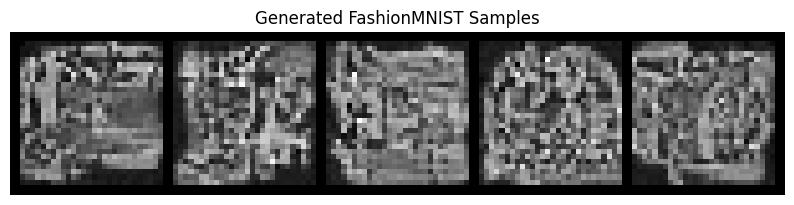

Streaming output truncated to the last 5000 lines.
Shape after adding t_embed_reshaped: torch.Size([32, 128, 7, 7])
Shape after adding c_embed: torch.Size([32, 128, 7, 7])
Shapes before adding embeddings: x shape torch.Size([32, 128, 7, 7]), t_embed shape torch.Size([32, 128]), c_embed shape torch.Size([32, 128, 1, 1])
t_embed_reshaped shape: torch.Size([32, 128, 1, 1])
Shape after adding t_embed_reshaped: torch.Size([32, 128, 7, 7])
Shape after adding c_embed: torch.Size([32, 128, 7, 7])
Shapes before adding embeddings: x shape torch.Size([32, 128, 7, 7]), t_embed shape torch.Size([32, 128]), c_embed shape torch.Size([32, 128, 1, 1])
t_embed_reshaped shape: torch.Size([32, 128, 1, 1])
Shape after adding t_embed_reshaped: torch.Size([32, 128, 7, 7])
Shape after adding c_embed: torch.Size([32, 128, 7, 7])
Shapes before adding embeddings: x shape torch.Size([32, 128, 7, 7]), t_embed shape torch.Size([32, 128]), c_embed shape torch.Size([32, 128, 1, 1])
t_embed_reshaped shape: torch.Size(

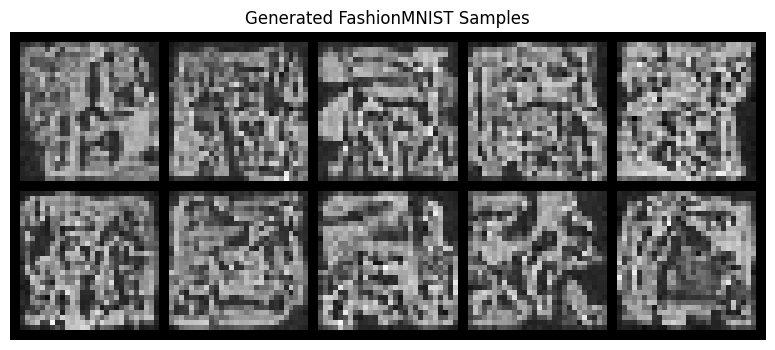

Created backup at best_diffusion_model.pt.backup
Model successfully saved to best_diffusion_model.pt
✓ New best model saved! (Val Loss: 0.1541)

Epoch 4/30
--------------------
Shapes before adding embeddings: x shape torch.Size([32, 128, 7, 7]), t_embed shape torch.Size([32, 128]), c_embed shape torch.Size([32, 128, 1, 1])
t_embed_reshaped shape: torch.Size([32, 128, 1, 1])
Shape after adding t_embed_reshaped: torch.Size([32, 128, 7, 7])
Shape after adding c_embed: torch.Size([32, 128, 7, 7])
  Step 0/1500, Loss: 0.1675
Shapes before adding embeddings: x shape torch.Size([32, 128, 7, 7]), t_embed shape torch.Size([32, 128]), c_embed shape torch.Size([32, 128, 1, 1])
t_embed_reshaped shape: torch.Size([32, 128, 1, 1])
Shape after adding t_embed_reshaped: torch.Size([32, 128, 7, 7])
Shape after adding c_embed: torch.Size([32, 128, 7, 7])
Shapes before adding embeddings: x shape torch.Size([32, 128, 7, 7]), t_embed shape torch.Size([32, 128]), c_embed shape torch.Size([32, 128, 1, 1])
t_

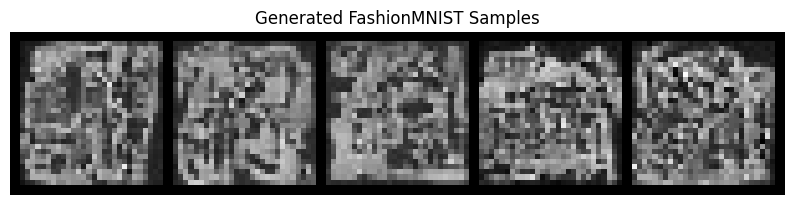

Shapes before adding embeddings: x shape torch.Size([32, 128, 7, 7]), t_embed shape torch.Size([32, 128]), c_embed shape torch.Size([32, 128, 1, 1])
t_embed_reshaped shape: torch.Size([32, 128, 1, 1])
Shape after adding t_embed_reshaped: torch.Size([32, 128, 7, 7])
Shape after adding c_embed: torch.Size([32, 128, 7, 7])
Shapes before adding embeddings: x shape torch.Size([32, 128, 7, 7]), t_embed shape torch.Size([32, 128]), c_embed shape torch.Size([32, 128, 1, 1])
t_embed_reshaped shape: torch.Size([32, 128, 1, 1])
Shape after adding t_embed_reshaped: torch.Size([32, 128, 7, 7])
Shape after adding c_embed: torch.Size([32, 128, 7, 7])
Shapes before adding embeddings: x shape torch.Size([32, 128, 7, 7]), t_embed shape torch.Size([32, 128]), c_embed shape torch.Size([32, 128, 1, 1])
t_embed_reshaped shape: torch.Size([32, 128, 1, 1])
Shape after adding t_embed_reshaped: torch.Size([32, 128, 7, 7])
Shape after adding c_embed: torch.Size([32, 128, 7, 7])
Shapes before adding embeddings: x

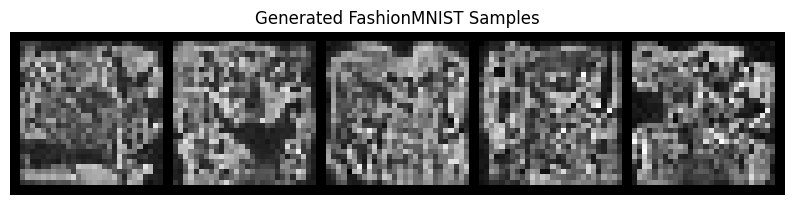

Streaming output truncated to the last 5000 lines.
Shape after adding c_embed: torch.Size([32, 128, 7, 7])
Shapes before adding embeddings: x shape torch.Size([32, 128, 7, 7]), t_embed shape torch.Size([32, 128]), c_embed shape torch.Size([32, 128, 1, 1])
t_embed_reshaped shape: torch.Size([32, 128, 1, 1])
Shape after adding t_embed_reshaped: torch.Size([32, 128, 7, 7])
Shape after adding c_embed: torch.Size([32, 128, 7, 7])
Shapes before adding embeddings: x shape torch.Size([32, 128, 7, 7]), t_embed shape torch.Size([32, 128]), c_embed shape torch.Size([32, 128, 1, 1])
t_embed_reshaped shape: torch.Size([32, 128, 1, 1])
Shape after adding t_embed_reshaped: torch.Size([32, 128, 7, 7])
Shape after adding c_embed: torch.Size([32, 128, 7, 7])
Shapes before adding embeddings: x shape torch.Size([32, 128, 7, 7]), t_embed shape torch.Size([32, 128]), c_embed shape torch.Size([32, 128, 1, 1])
t_embed_reshaped shape: torch.Size([32, 128, 1, 1])
Shape after adding t_embed_reshaped: torch.Size(

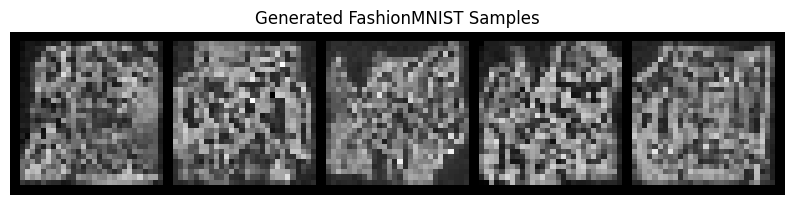

Shapes before adding embeddings: x shape torch.Size([32, 128, 7, 7]), t_embed shape torch.Size([32, 128]), c_embed shape torch.Size([32, 128, 1, 1])
t_embed_reshaped shape: torch.Size([32, 128, 1, 1])
Shape after adding t_embed_reshaped: torch.Size([32, 128, 7, 7])
Shape after adding c_embed: torch.Size([32, 128, 7, 7])
Shapes before adding embeddings: x shape torch.Size([32, 128, 7, 7]), t_embed shape torch.Size([32, 128]), c_embed shape torch.Size([32, 128, 1, 1])
t_embed_reshaped shape: torch.Size([32, 128, 1, 1])
Shape after adding t_embed_reshaped: torch.Size([32, 128, 7, 7])
Shape after adding c_embed: torch.Size([32, 128, 7, 7])
Shapes before adding embeddings: x shape torch.Size([32, 128, 7, 7]), t_embed shape torch.Size([32, 128]), c_embed shape torch.Size([32, 128, 1, 1])
t_embed_reshaped shape: torch.Size([32, 128, 1, 1])
Shape after adding t_embed_reshaped: torch.Size([32, 128, 7, 7])
Shape after adding c_embed: torch.Size([32, 128, 7, 7])
Shapes before adding embeddings: x

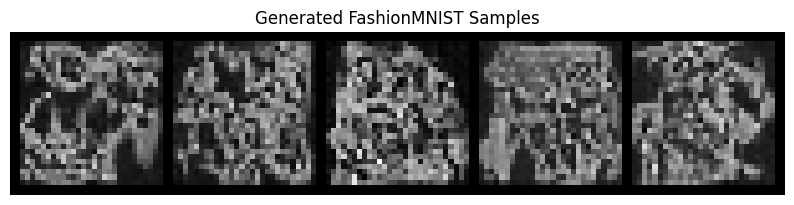

Streaming output truncated to the last 5000 lines.
Shape after adding t_embed_reshaped: torch.Size([32, 128, 7, 7])
Shape after adding c_embed: torch.Size([32, 128, 7, 7])
Shapes before adding embeddings: x shape torch.Size([32, 128, 7, 7]), t_embed shape torch.Size([32, 128]), c_embed shape torch.Size([32, 128, 1, 1])
t_embed_reshaped shape: torch.Size([32, 128, 1, 1])
Shape after adding t_embed_reshaped: torch.Size([32, 128, 7, 7])
Shape after adding c_embed: torch.Size([32, 128, 7, 7])
Shapes before adding embeddings: x shape torch.Size([32, 128, 7, 7]), t_embed shape torch.Size([32, 128]), c_embed shape torch.Size([32, 128, 1, 1])
t_embed_reshaped shape: torch.Size([32, 128, 1, 1])
Shape after adding t_embed_reshaped: torch.Size([32, 128, 7, 7])
Shape after adding c_embed: torch.Size([32, 128, 7, 7])
Shapes before adding embeddings: x shape torch.Size([32, 128, 7, 7]), t_embed shape torch.Size([32, 128]), c_embed shape torch.Size([32, 128, 1, 1])
t_embed_reshaped shape: torch.Size(

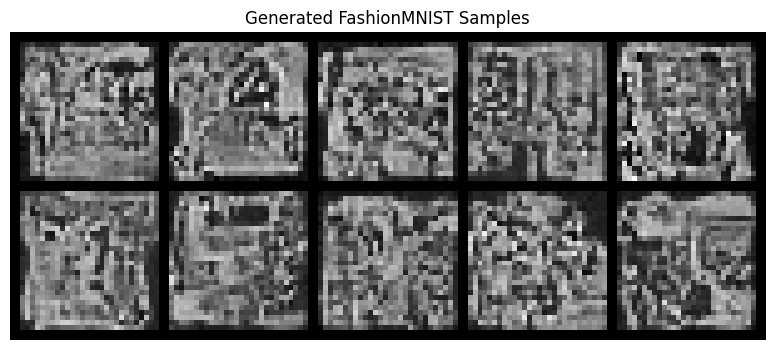

Created backup at best_diffusion_model.pt.backup
Model successfully saved to best_diffusion_model.pt
✓ New best model saved! (Val Loss: 0.1486)

Epoch 6/30
--------------------
Shapes before adding embeddings: x shape torch.Size([32, 128, 7, 7]), t_embed shape torch.Size([32, 128]), c_embed shape torch.Size([32, 128, 1, 1])
t_embed_reshaped shape: torch.Size([32, 128, 1, 1])
Shape after adding t_embed_reshaped: torch.Size([32, 128, 7, 7])
Shape after adding c_embed: torch.Size([32, 128, 7, 7])
  Step 0/1500, Loss: 0.1416
Shapes before adding embeddings: x shape torch.Size([32, 128, 7, 7]), t_embed shape torch.Size([32, 128]), c_embed shape torch.Size([32, 128, 1, 1])
t_embed_reshaped shape: torch.Size([32, 128, 1, 1])
Shape after adding t_embed_reshaped: torch.Size([32, 128, 7, 7])
Shape after adding c_embed: torch.Size([32, 128, 7, 7])
Shapes before adding embeddings: x shape torch.Size([32, 128, 7, 7]), t_embed shape torch.Size([32, 128]), c_embed shape torch.Size([32, 128, 1, 1])
t_

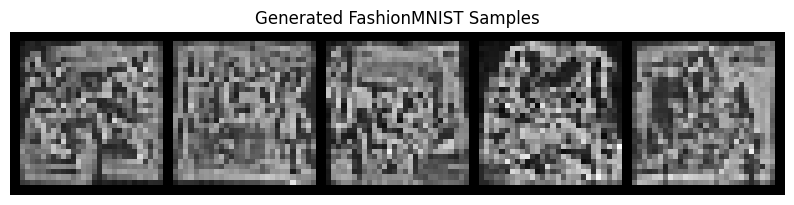

Shapes before adding embeddings: x shape torch.Size([32, 128, 7, 7]), t_embed shape torch.Size([32, 128]), c_embed shape torch.Size([32, 128, 1, 1])
t_embed_reshaped shape: torch.Size([32, 128, 1, 1])
Shape after adding t_embed_reshaped: torch.Size([32, 128, 7, 7])
Shape after adding c_embed: torch.Size([32, 128, 7, 7])
Shapes before adding embeddings: x shape torch.Size([32, 128, 7, 7]), t_embed shape torch.Size([32, 128]), c_embed shape torch.Size([32, 128, 1, 1])
t_embed_reshaped shape: torch.Size([32, 128, 1, 1])
Shape after adding t_embed_reshaped: torch.Size([32, 128, 7, 7])
Shape after adding c_embed: torch.Size([32, 128, 7, 7])
Shapes before adding embeddings: x shape torch.Size([32, 128, 7, 7]), t_embed shape torch.Size([32, 128]), c_embed shape torch.Size([32, 128, 1, 1])
t_embed_reshaped shape: torch.Size([32, 128, 1, 1])
Shape after adding t_embed_reshaped: torch.Size([32, 128, 7, 7])
Shape after adding c_embed: torch.Size([32, 128, 7, 7])
Shapes before adding embeddings: x

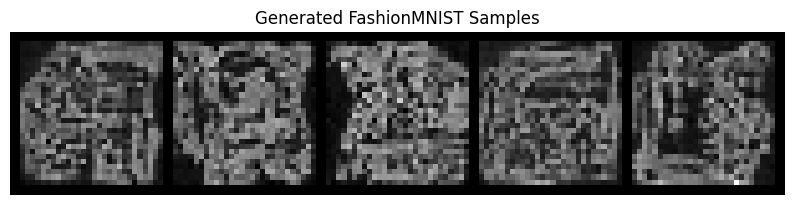

Streaming output truncated to the last 5000 lines.
Shape after adding c_embed: torch.Size([32, 128, 7, 7])
Shapes before adding embeddings: x shape torch.Size([32, 128, 7, 7]), t_embed shape torch.Size([32, 128]), c_embed shape torch.Size([32, 128, 1, 1])
t_embed_reshaped shape: torch.Size([32, 128, 1, 1])
Shape after adding t_embed_reshaped: torch.Size([32, 128, 7, 7])
Shape after adding c_embed: torch.Size([32, 128, 7, 7])
Shapes before adding embeddings: x shape torch.Size([32, 128, 7, 7]), t_embed shape torch.Size([32, 128]), c_embed shape torch.Size([32, 128, 1, 1])
t_embed_reshaped shape: torch.Size([32, 128, 1, 1])
Shape after adding t_embed_reshaped: torch.Size([32, 128, 7, 7])
Shape after adding c_embed: torch.Size([32, 128, 7, 7])
Shapes before adding embeddings: x shape torch.Size([32, 128, 7, 7]), t_embed shape torch.Size([32, 128]), c_embed shape torch.Size([32, 128, 1, 1])
t_embed_reshaped shape: torch.Size([32, 128, 1, 1])
Shape after adding t_embed_reshaped: torch.Size(

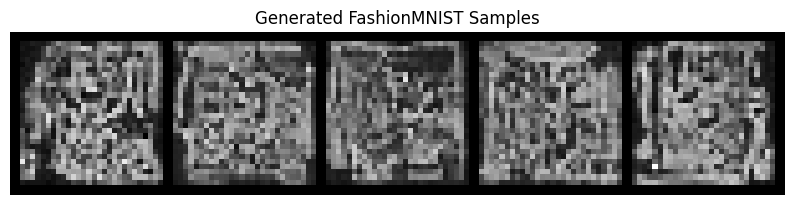

Shapes before adding embeddings: x shape torch.Size([32, 128, 7, 7]), t_embed shape torch.Size([32, 128]), c_embed shape torch.Size([32, 128, 1, 1])
t_embed_reshaped shape: torch.Size([32, 128, 1, 1])
Shape after adding t_embed_reshaped: torch.Size([32, 128, 7, 7])
Shape after adding c_embed: torch.Size([32, 128, 7, 7])
Shapes before adding embeddings: x shape torch.Size([32, 128, 7, 7]), t_embed shape torch.Size([32, 128]), c_embed shape torch.Size([32, 128, 1, 1])
t_embed_reshaped shape: torch.Size([32, 128, 1, 1])
Shape after adding t_embed_reshaped: torch.Size([32, 128, 7, 7])
Shape after adding c_embed: torch.Size([32, 128, 7, 7])
Shapes before adding embeddings: x shape torch.Size([32, 128, 7, 7]), t_embed shape torch.Size([32, 128]), c_embed shape torch.Size([32, 128, 1, 1])
t_embed_reshaped shape: torch.Size([32, 128, 1, 1])
Shape after adding t_embed_reshaped: torch.Size([32, 128, 7, 7])
Shape after adding c_embed: torch.Size([32, 128, 7, 7])
Shapes before adding embeddings: x

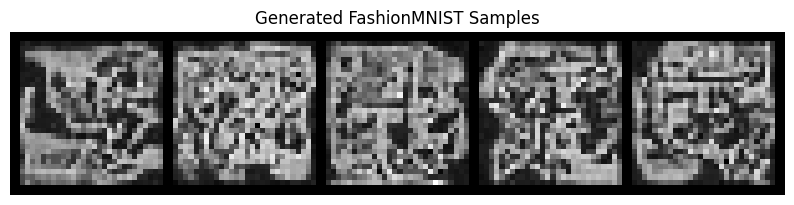

Streaming output truncated to the last 5000 lines.
Shape after adding t_embed_reshaped: torch.Size([32, 128, 7, 7])
Shape after adding c_embed: torch.Size([32, 128, 7, 7])
Shapes before adding embeddings: x shape torch.Size([32, 128, 7, 7]), t_embed shape torch.Size([32, 128]), c_embed shape torch.Size([32, 128, 1, 1])
t_embed_reshaped shape: torch.Size([32, 128, 1, 1])
Shape after adding t_embed_reshaped: torch.Size([32, 128, 7, 7])
Shape after adding c_embed: torch.Size([32, 128, 7, 7])
Shapes before adding embeddings: x shape torch.Size([32, 128, 7, 7]), t_embed shape torch.Size([32, 128]), c_embed shape torch.Size([32, 128, 1, 1])
t_embed_reshaped shape: torch.Size([32, 128, 1, 1])
Shape after adding t_embed_reshaped: torch.Size([32, 128, 7, 7])
Shape after adding c_embed: torch.Size([32, 128, 7, 7])
Shapes before adding embeddings: x shape torch.Size([32, 128, 7, 7]), t_embed shape torch.Size([32, 128]), c_embed shape torch.Size([32, 128, 1, 1])
t_embed_reshaped shape: torch.Size(

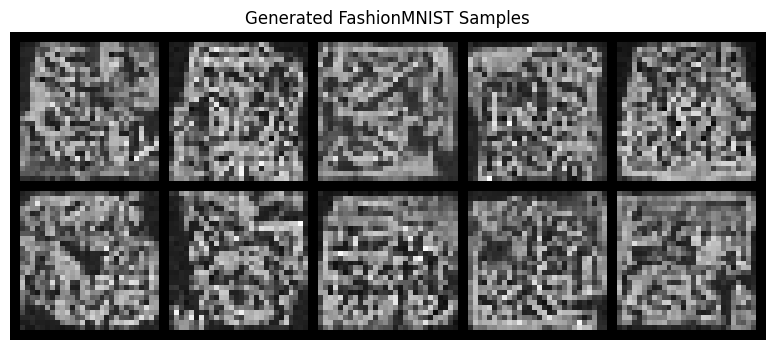

Created backup at best_diffusion_model.pt.backup
Model successfully saved to best_diffusion_model.pt
✓ New best model saved! (Val Loss: 0.1455)

Epoch 8/30
--------------------
Shapes before adding embeddings: x shape torch.Size([32, 128, 7, 7]), t_embed shape torch.Size([32, 128]), c_embed shape torch.Size([32, 128, 1, 1])
t_embed_reshaped shape: torch.Size([32, 128, 1, 1])
Shape after adding t_embed_reshaped: torch.Size([32, 128, 7, 7])
Shape after adding c_embed: torch.Size([32, 128, 7, 7])
  Step 0/1500, Loss: 0.1579
Shapes before adding embeddings: x shape torch.Size([32, 128, 7, 7]), t_embed shape torch.Size([32, 128]), c_embed shape torch.Size([32, 128, 1, 1])
t_embed_reshaped shape: torch.Size([32, 128, 1, 1])
Shape after adding t_embed_reshaped: torch.Size([32, 128, 7, 7])
Shape after adding c_embed: torch.Size([32, 128, 7, 7])
Shapes before adding embeddings: x shape torch.Size([32, 128, 7, 7]), t_embed shape torch.Size([32, 128]), c_embed shape torch.Size([32, 128, 1, 1])
t_

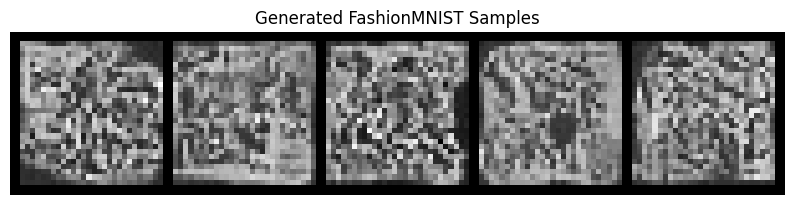

Shapes before adding embeddings: x shape torch.Size([32, 128, 7, 7]), t_embed shape torch.Size([32, 128]), c_embed shape torch.Size([32, 128, 1, 1])
t_embed_reshaped shape: torch.Size([32, 128, 1, 1])
Shape after adding t_embed_reshaped: torch.Size([32, 128, 7, 7])
Shape after adding c_embed: torch.Size([32, 128, 7, 7])
Shapes before adding embeddings: x shape torch.Size([32, 128, 7, 7]), t_embed shape torch.Size([32, 128]), c_embed shape torch.Size([32, 128, 1, 1])
t_embed_reshaped shape: torch.Size([32, 128, 1, 1])
Shape after adding t_embed_reshaped: torch.Size([32, 128, 7, 7])
Shape after adding c_embed: torch.Size([32, 128, 7, 7])
Shapes before adding embeddings: x shape torch.Size([32, 128, 7, 7]), t_embed shape torch.Size([32, 128]), c_embed shape torch.Size([32, 128, 1, 1])
t_embed_reshaped shape: torch.Size([32, 128, 1, 1])
Shape after adding t_embed_reshaped: torch.Size([32, 128, 7, 7])
Shape after adding c_embed: torch.Size([32, 128, 7, 7])
Shapes before adding embeddings: x

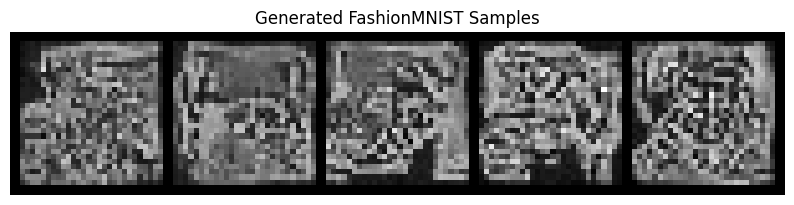

Streaming output truncated to the last 5000 lines.
Shape after adding c_embed: torch.Size([32, 128, 7, 7])
Shapes before adding embeddings: x shape torch.Size([32, 128, 7, 7]), t_embed shape torch.Size([32, 128]), c_embed shape torch.Size([32, 128, 1, 1])
t_embed_reshaped shape: torch.Size([32, 128, 1, 1])
Shape after adding t_embed_reshaped: torch.Size([32, 128, 7, 7])
Shape after adding c_embed: torch.Size([32, 128, 7, 7])
Shapes before adding embeddings: x shape torch.Size([32, 128, 7, 7]), t_embed shape torch.Size([32, 128]), c_embed shape torch.Size([32, 128, 1, 1])
t_embed_reshaped shape: torch.Size([32, 128, 1, 1])
Shape after adding t_embed_reshaped: torch.Size([32, 128, 7, 7])
Shape after adding c_embed: torch.Size([32, 128, 7, 7])
Shapes before adding embeddings: x shape torch.Size([32, 128, 7, 7]), t_embed shape torch.Size([32, 128]), c_embed shape torch.Size([32, 128, 1, 1])
t_embed_reshaped shape: torch.Size([32, 128, 1, 1])
Shape after adding t_embed_reshaped: torch.Size(

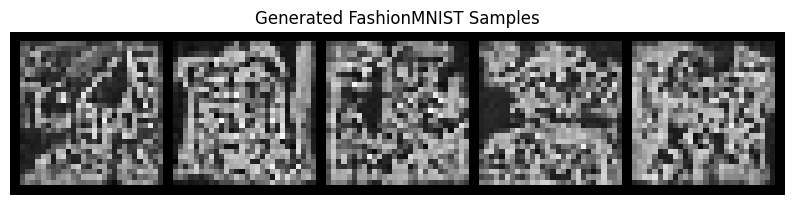

Shapes before adding embeddings: x shape torch.Size([32, 128, 7, 7]), t_embed shape torch.Size([32, 128]), c_embed shape torch.Size([32, 128, 1, 1])
t_embed_reshaped shape: torch.Size([32, 128, 1, 1])
Shape after adding t_embed_reshaped: torch.Size([32, 128, 7, 7])
Shape after adding c_embed: torch.Size([32, 128, 7, 7])
Shapes before adding embeddings: x shape torch.Size([32, 128, 7, 7]), t_embed shape torch.Size([32, 128]), c_embed shape torch.Size([32, 128, 1, 1])
t_embed_reshaped shape: torch.Size([32, 128, 1, 1])
Shape after adding t_embed_reshaped: torch.Size([32, 128, 7, 7])
Shape after adding c_embed: torch.Size([32, 128, 7, 7])
Shapes before adding embeddings: x shape torch.Size([32, 128, 7, 7]), t_embed shape torch.Size([32, 128]), c_embed shape torch.Size([32, 128, 1, 1])
t_embed_reshaped shape: torch.Size([32, 128, 1, 1])
Shape after adding t_embed_reshaped: torch.Size([32, 128, 7, 7])
Shape after adding c_embed: torch.Size([32, 128, 7, 7])
Shapes before adding embeddings: x

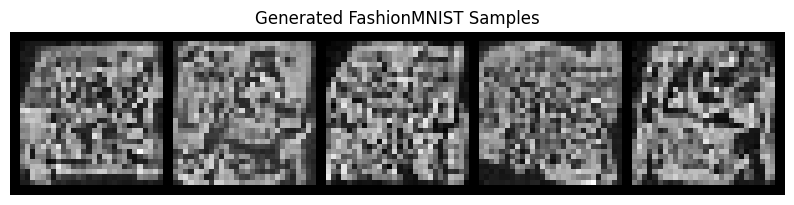

Streaming output truncated to the last 5000 lines.
Shape after adding t_embed_reshaped: torch.Size([32, 128, 7, 7])
Shape after adding c_embed: torch.Size([32, 128, 7, 7])
Shapes before adding embeddings: x shape torch.Size([32, 128, 7, 7]), t_embed shape torch.Size([32, 128]), c_embed shape torch.Size([32, 128, 1, 1])
t_embed_reshaped shape: torch.Size([32, 128, 1, 1])
Shape after adding t_embed_reshaped: torch.Size([32, 128, 7, 7])
Shape after adding c_embed: torch.Size([32, 128, 7, 7])
Shapes before adding embeddings: x shape torch.Size([32, 128, 7, 7]), t_embed shape torch.Size([32, 128]), c_embed shape torch.Size([32, 128, 1, 1])
t_embed_reshaped shape: torch.Size([32, 128, 1, 1])
Shape after adding t_embed_reshaped: torch.Size([32, 128, 7, 7])
Shape after adding c_embed: torch.Size([32, 128, 7, 7])
Shapes before adding embeddings: x shape torch.Size([32, 128, 7, 7]), t_embed shape torch.Size([32, 128]), c_embed shape torch.Size([32, 128, 1, 1])
t_embed_reshaped shape: torch.Size(

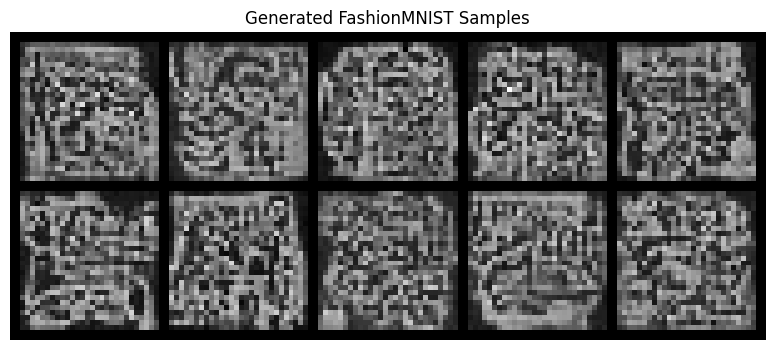

No improvement for 1/10 epochs

Epoch 10/30
--------------------
Shapes before adding embeddings: x shape torch.Size([32, 128, 7, 7]), t_embed shape torch.Size([32, 128]), c_embed shape torch.Size([32, 128, 1, 1])
t_embed_reshaped shape: torch.Size([32, 128, 1, 1])
Shape after adding t_embed_reshaped: torch.Size([32, 128, 7, 7])
Shape after adding c_embed: torch.Size([32, 128, 7, 7])
  Step 0/1500, Loss: 0.1489
Shapes before adding embeddings: x shape torch.Size([32, 128, 7, 7]), t_embed shape torch.Size([32, 128]), c_embed shape torch.Size([32, 128, 1, 1])
t_embed_reshaped shape: torch.Size([32, 128, 1, 1])
Shape after adding t_embed_reshaped: torch.Size([32, 128, 7, 7])
Shape after adding c_embed: torch.Size([32, 128, 7, 7])
Shapes before adding embeddings: x shape torch.Size([32, 128, 7, 7]), t_embed shape torch.Size([32, 128]), c_embed shape torch.Size([32, 128, 1, 1])
t_embed_reshaped shape: torch.Size([32, 128, 1, 1])
Shape after adding t_embed_reshaped: torch.Size([32, 128, 7, 7

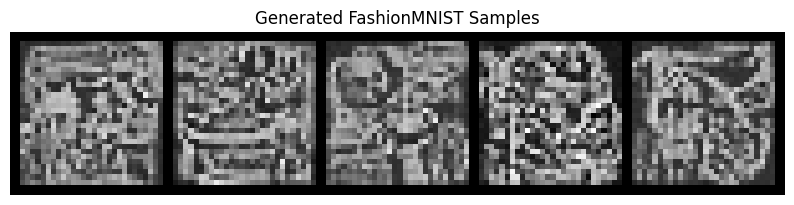

Shapes before adding embeddings: x shape torch.Size([32, 128, 7, 7]), t_embed shape torch.Size([32, 128]), c_embed shape torch.Size([32, 128, 1, 1])
t_embed_reshaped shape: torch.Size([32, 128, 1, 1])
Shape after adding t_embed_reshaped: torch.Size([32, 128, 7, 7])
Shape after adding c_embed: torch.Size([32, 128, 7, 7])
Shapes before adding embeddings: x shape torch.Size([32, 128, 7, 7]), t_embed shape torch.Size([32, 128]), c_embed shape torch.Size([32, 128, 1, 1])
t_embed_reshaped shape: torch.Size([32, 128, 1, 1])
Shape after adding t_embed_reshaped: torch.Size([32, 128, 7, 7])
Shape after adding c_embed: torch.Size([32, 128, 7, 7])
Shapes before adding embeddings: x shape torch.Size([32, 128, 7, 7]), t_embed shape torch.Size([32, 128]), c_embed shape torch.Size([32, 128, 1, 1])
t_embed_reshaped shape: torch.Size([32, 128, 1, 1])
Shape after adding t_embed_reshaped: torch.Size([32, 128, 7, 7])
Shape after adding c_embed: torch.Size([32, 128, 7, 7])
Shapes before adding embeddings: x

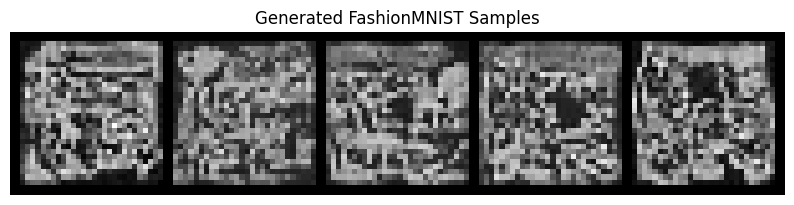

Streaming output truncated to the last 5000 lines.
Shape after adding c_embed: torch.Size([32, 128, 7, 7])
Shapes before adding embeddings: x shape torch.Size([32, 128, 7, 7]), t_embed shape torch.Size([32, 128]), c_embed shape torch.Size([32, 128, 1, 1])
t_embed_reshaped shape: torch.Size([32, 128, 1, 1])
Shape after adding t_embed_reshaped: torch.Size([32, 128, 7, 7])
Shape after adding c_embed: torch.Size([32, 128, 7, 7])
Shapes before adding embeddings: x shape torch.Size([32, 128, 7, 7]), t_embed shape torch.Size([32, 128]), c_embed shape torch.Size([32, 128, 1, 1])
t_embed_reshaped shape: torch.Size([32, 128, 1, 1])
Shape after adding t_embed_reshaped: torch.Size([32, 128, 7, 7])
Shape after adding c_embed: torch.Size([32, 128, 7, 7])
Shapes before adding embeddings: x shape torch.Size([32, 128, 7, 7]), t_embed shape torch.Size([32, 128]), c_embed shape torch.Size([32, 128, 1, 1])
t_embed_reshaped shape: torch.Size([32, 128, 1, 1])
Shape after adding t_embed_reshaped: torch.Size(

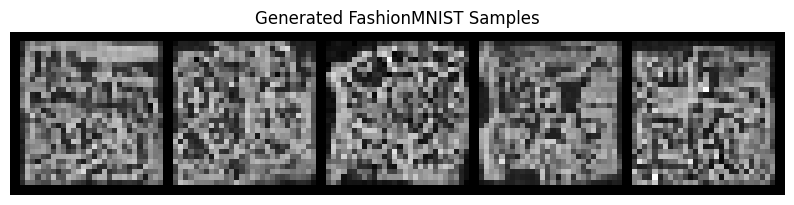

Shapes before adding embeddings: x shape torch.Size([32, 128, 7, 7]), t_embed shape torch.Size([32, 128]), c_embed shape torch.Size([32, 128, 1, 1])
t_embed_reshaped shape: torch.Size([32, 128, 1, 1])
Shape after adding t_embed_reshaped: torch.Size([32, 128, 7, 7])
Shape after adding c_embed: torch.Size([32, 128, 7, 7])
Shapes before adding embeddings: x shape torch.Size([32, 128, 7, 7]), t_embed shape torch.Size([32, 128]), c_embed shape torch.Size([32, 128, 1, 1])
t_embed_reshaped shape: torch.Size([32, 128, 1, 1])
Shape after adding t_embed_reshaped: torch.Size([32, 128, 7, 7])
Shape after adding c_embed: torch.Size([32, 128, 7, 7])
Shapes before adding embeddings: x shape torch.Size([32, 128, 7, 7]), t_embed shape torch.Size([32, 128]), c_embed shape torch.Size([32, 128, 1, 1])
t_embed_reshaped shape: torch.Size([32, 128, 1, 1])
Shape after adding t_embed_reshaped: torch.Size([32, 128, 7, 7])
Shape after adding c_embed: torch.Size([32, 128, 7, 7])
Shapes before adding embeddings: x

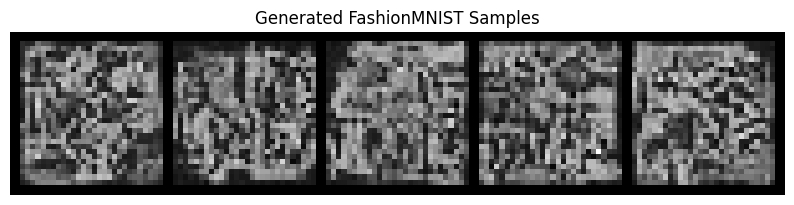

Streaming output truncated to the last 5000 lines.
Shape after adding t_embed_reshaped: torch.Size([32, 128, 7, 7])
Shape after adding c_embed: torch.Size([32, 128, 7, 7])
Shapes before adding embeddings: x shape torch.Size([32, 128, 7, 7]), t_embed shape torch.Size([32, 128]), c_embed shape torch.Size([32, 128, 1, 1])
t_embed_reshaped shape: torch.Size([32, 128, 1, 1])
Shape after adding t_embed_reshaped: torch.Size([32, 128, 7, 7])
Shape after adding c_embed: torch.Size([32, 128, 7, 7])
Shapes before adding embeddings: x shape torch.Size([32, 128, 7, 7]), t_embed shape torch.Size([32, 128]), c_embed shape torch.Size([32, 128, 1, 1])
t_embed_reshaped shape: torch.Size([32, 128, 1, 1])
Shape after adding t_embed_reshaped: torch.Size([32, 128, 7, 7])
Shape after adding c_embed: torch.Size([32, 128, 7, 7])
Shapes before adding embeddings: x shape torch.Size([32, 128, 7, 7]), t_embed shape torch.Size([32, 128]), c_embed shape torch.Size([32, 128, 1, 1])
t_embed_reshaped shape: torch.Size(

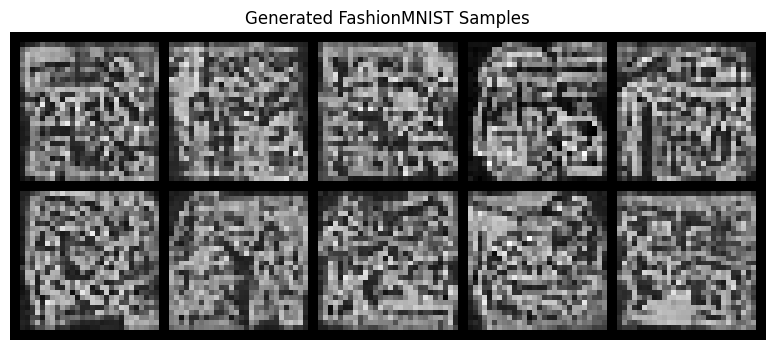

Created backup at best_diffusion_model.pt.backup
Model successfully saved to best_diffusion_model.pt
✓ New best model saved! (Val Loss: 0.1409)

Epoch 12/30
--------------------
Shapes before adding embeddings: x shape torch.Size([32, 128, 7, 7]), t_embed shape torch.Size([32, 128]), c_embed shape torch.Size([32, 128, 1, 1])
t_embed_reshaped shape: torch.Size([32, 128, 1, 1])
Shape after adding t_embed_reshaped: torch.Size([32, 128, 7, 7])
Shape after adding c_embed: torch.Size([32, 128, 7, 7])
  Step 0/1500, Loss: 0.1324
Shapes before adding embeddings: x shape torch.Size([32, 128, 7, 7]), t_embed shape torch.Size([32, 128]), c_embed shape torch.Size([32, 128, 1, 1])
t_embed_reshaped shape: torch.Size([32, 128, 1, 1])
Shape after adding t_embed_reshaped: torch.Size([32, 128, 7, 7])
Shape after adding c_embed: torch.Size([32, 128, 7, 7])
Shapes before adding embeddings: x shape torch.Size([32, 128, 7, 7]), t_embed shape torch.Size([32, 128]), c_embed shape torch.Size([32, 128, 1, 1])
t

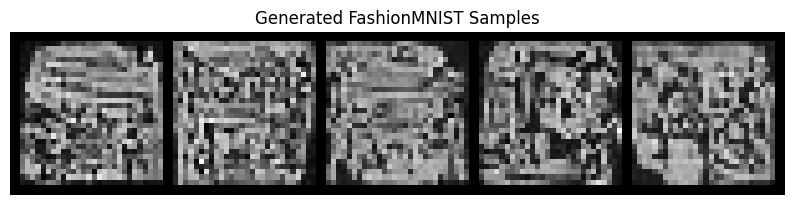

Shapes before adding embeddings: x shape torch.Size([32, 128, 7, 7]), t_embed shape torch.Size([32, 128]), c_embed shape torch.Size([32, 128, 1, 1])
t_embed_reshaped shape: torch.Size([32, 128, 1, 1])
Shape after adding t_embed_reshaped: torch.Size([32, 128, 7, 7])
Shape after adding c_embed: torch.Size([32, 128, 7, 7])
Shapes before adding embeddings: x shape torch.Size([32, 128, 7, 7]), t_embed shape torch.Size([32, 128]), c_embed shape torch.Size([32, 128, 1, 1])
t_embed_reshaped shape: torch.Size([32, 128, 1, 1])
Shape after adding t_embed_reshaped: torch.Size([32, 128, 7, 7])
Shape after adding c_embed: torch.Size([32, 128, 7, 7])
Shapes before adding embeddings: x shape torch.Size([32, 128, 7, 7]), t_embed shape torch.Size([32, 128]), c_embed shape torch.Size([32, 128, 1, 1])
t_embed_reshaped shape: torch.Size([32, 128, 1, 1])
Shape after adding t_embed_reshaped: torch.Size([32, 128, 7, 7])
Shape after adding c_embed: torch.Size([32, 128, 7, 7])
Shapes before adding embeddings: x

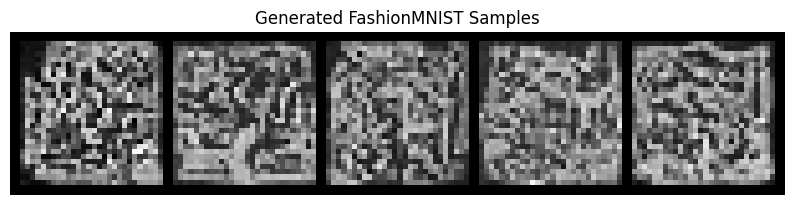

Streaming output truncated to the last 5000 lines.
t_embed_reshaped shape: torch.Size([32, 128, 1, 1])
Shape after adding t_embed_reshaped: torch.Size([32, 128, 7, 7])
Shape after adding c_embed: torch.Size([32, 128, 7, 7])
Shapes before adding embeddings: x shape torch.Size([32, 128, 7, 7]), t_embed shape torch.Size([32, 128]), c_embed shape torch.Size([32, 128, 1, 1])
t_embed_reshaped shape: torch.Size([32, 128, 1, 1])
Shape after adding t_embed_reshaped: torch.Size([32, 128, 7, 7])
Shape after adding c_embed: torch.Size([32, 128, 7, 7])
Shapes before adding embeddings: x shape torch.Size([32, 128, 7, 7]), t_embed shape torch.Size([32, 128]), c_embed shape torch.Size([32, 128, 1, 1])
t_embed_reshaped shape: torch.Size([32, 128, 1, 1])
Shape after adding t_embed_reshaped: torch.Size([32, 128, 7, 7])
Shape after adding c_embed: torch.Size([32, 128, 7, 7])
Shapes before adding embeddings: x shape torch.Size([32, 128, 7, 7]), t_embed shape torch.Size([32, 128]), c_embed shape torch.Size(

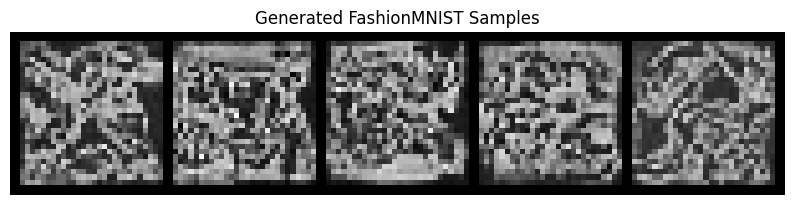

Shapes before adding embeddings: x shape torch.Size([32, 128, 7, 7]), t_embed shape torch.Size([32, 128]), c_embed shape torch.Size([32, 128, 1, 1])
t_embed_reshaped shape: torch.Size([32, 128, 1, 1])
Shape after adding t_embed_reshaped: torch.Size([32, 128, 7, 7])
Shape after adding c_embed: torch.Size([32, 128, 7, 7])
Shapes before adding embeddings: x shape torch.Size([32, 128, 7, 7]), t_embed shape torch.Size([32, 128]), c_embed shape torch.Size([32, 128, 1, 1])
t_embed_reshaped shape: torch.Size([32, 128, 1, 1])
Shape after adding t_embed_reshaped: torch.Size([32, 128, 7, 7])
Shape after adding c_embed: torch.Size([32, 128, 7, 7])
Shapes before adding embeddings: x shape torch.Size([32, 128, 7, 7]), t_embed shape torch.Size([32, 128]), c_embed shape torch.Size([32, 128, 1, 1])
t_embed_reshaped shape: torch.Size([32, 128, 1, 1])
Shape after adding t_embed_reshaped: torch.Size([32, 128, 7, 7])
Shape after adding c_embed: torch.Size([32, 128, 7, 7])
Shapes before adding embeddings: x

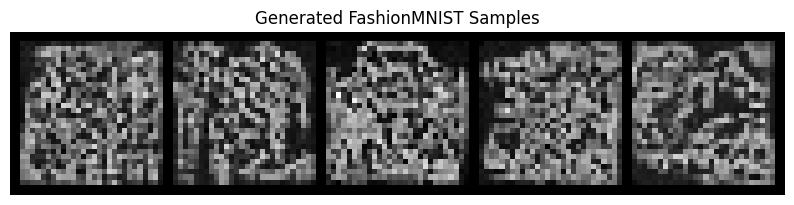

Streaming output truncated to the last 5000 lines.
Shape after adding t_embed_reshaped: torch.Size([32, 128, 7, 7])
Shape after adding c_embed: torch.Size([32, 128, 7, 7])
Shapes before adding embeddings: x shape torch.Size([32, 128, 7, 7]), t_embed shape torch.Size([32, 128]), c_embed shape torch.Size([32, 128, 1, 1])
t_embed_reshaped shape: torch.Size([32, 128, 1, 1])
Shape after adding t_embed_reshaped: torch.Size([32, 128, 7, 7])
Shape after adding c_embed: torch.Size([32, 128, 7, 7])
Shapes before adding embeddings: x shape torch.Size([32, 128, 7, 7]), t_embed shape torch.Size([32, 128]), c_embed shape torch.Size([32, 128, 1, 1])
t_embed_reshaped shape: torch.Size([32, 128, 1, 1])
Shape after adding t_embed_reshaped: torch.Size([32, 128, 7, 7])
Shape after adding c_embed: torch.Size([32, 128, 7, 7])
Shapes before adding embeddings: x shape torch.Size([32, 128, 7, 7]), t_embed shape torch.Size([32, 128]), c_embed shape torch.Size([32, 128, 1, 1])
t_embed_reshaped shape: torch.Size(

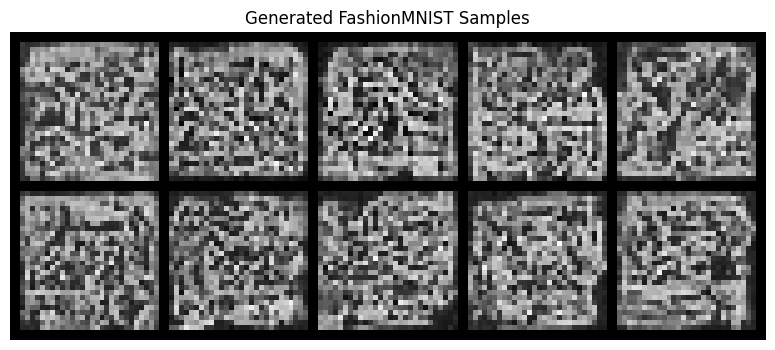

Created backup at best_diffusion_model.pt.backup
Model successfully saved to best_diffusion_model.pt
✓ New best model saved! (Val Loss: 0.1398)

Epoch 14/30
--------------------
Shapes before adding embeddings: x shape torch.Size([32, 128, 7, 7]), t_embed shape torch.Size([32, 128]), c_embed shape torch.Size([32, 128, 1, 1])
t_embed_reshaped shape: torch.Size([32, 128, 1, 1])
Shape after adding t_embed_reshaped: torch.Size([32, 128, 7, 7])
Shape after adding c_embed: torch.Size([32, 128, 7, 7])
  Step 0/1500, Loss: 0.1282
Shapes before adding embeddings: x shape torch.Size([32, 128, 7, 7]), t_embed shape torch.Size([32, 128]), c_embed shape torch.Size([32, 128, 1, 1])
t_embed_reshaped shape: torch.Size([32, 128, 1, 1])
Shape after adding t_embed_reshaped: torch.Size([32, 128, 7, 7])
Shape after adding c_embed: torch.Size([32, 128, 7, 7])
Shapes before adding embeddings: x shape torch.Size([32, 128, 7, 7]), t_embed shape torch.Size([32, 128]), c_embed shape torch.Size([32, 128, 1, 1])
t

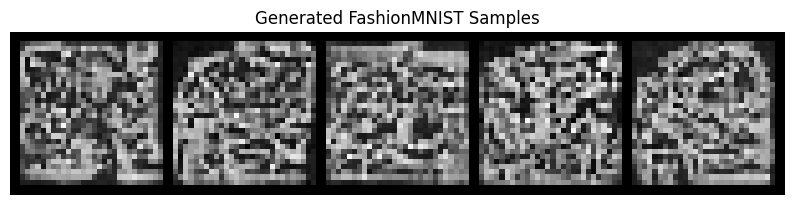

Shapes before adding embeddings: x shape torch.Size([32, 128, 7, 7]), t_embed shape torch.Size([32, 128]), c_embed shape torch.Size([32, 128, 1, 1])
t_embed_reshaped shape: torch.Size([32, 128, 1, 1])
Shape after adding t_embed_reshaped: torch.Size([32, 128, 7, 7])
Shape after adding c_embed: torch.Size([32, 128, 7, 7])
Shapes before adding embeddings: x shape torch.Size([32, 128, 7, 7]), t_embed shape torch.Size([32, 128]), c_embed shape torch.Size([32, 128, 1, 1])
t_embed_reshaped shape: torch.Size([32, 128, 1, 1])
Shape after adding t_embed_reshaped: torch.Size([32, 128, 7, 7])
Shape after adding c_embed: torch.Size([32, 128, 7, 7])
Shapes before adding embeddings: x shape torch.Size([32, 128, 7, 7]), t_embed shape torch.Size([32, 128]), c_embed shape torch.Size([32, 128, 1, 1])
t_embed_reshaped shape: torch.Size([32, 128, 1, 1])
Shape after adding t_embed_reshaped: torch.Size([32, 128, 7, 7])
Shape after adding c_embed: torch.Size([32, 128, 7, 7])
Shapes before adding embeddings: x

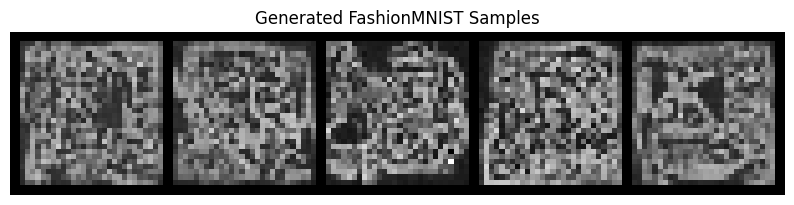

Streaming output truncated to the last 5000 lines.
Shape after adding c_embed: torch.Size([32, 128, 7, 7])
Shapes before adding embeddings: x shape torch.Size([32, 128, 7, 7]), t_embed shape torch.Size([32, 128]), c_embed shape torch.Size([32, 128, 1, 1])
t_embed_reshaped shape: torch.Size([32, 128, 1, 1])
Shape after adding t_embed_reshaped: torch.Size([32, 128, 7, 7])
Shape after adding c_embed: torch.Size([32, 128, 7, 7])
Shapes before adding embeddings: x shape torch.Size([32, 128, 7, 7]), t_embed shape torch.Size([32, 128]), c_embed shape torch.Size([32, 128, 1, 1])
t_embed_reshaped shape: torch.Size([32, 128, 1, 1])
Shape after adding t_embed_reshaped: torch.Size([32, 128, 7, 7])
Shape after adding c_embed: torch.Size([32, 128, 7, 7])
Shapes before adding embeddings: x shape torch.Size([32, 128, 7, 7]), t_embed shape torch.Size([32, 128]), c_embed shape torch.Size([32, 128, 1, 1])
t_embed_reshaped shape: torch.Size([32, 128, 1, 1])
Shape after adding t_embed_reshaped: torch.Size(

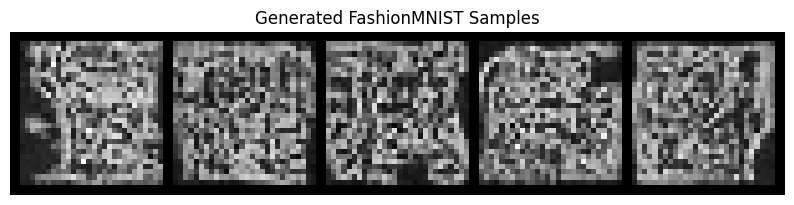

Shapes before adding embeddings: x shape torch.Size([32, 128, 7, 7]), t_embed shape torch.Size([32, 128]), c_embed shape torch.Size([32, 128, 1, 1])
t_embed_reshaped shape: torch.Size([32, 128, 1, 1])
Shape after adding t_embed_reshaped: torch.Size([32, 128, 7, 7])
Shape after adding c_embed: torch.Size([32, 128, 7, 7])
Shapes before adding embeddings: x shape torch.Size([32, 128, 7, 7]), t_embed shape torch.Size([32, 128]), c_embed shape torch.Size([32, 128, 1, 1])
t_embed_reshaped shape: torch.Size([32, 128, 1, 1])
Shape after adding t_embed_reshaped: torch.Size([32, 128, 7, 7])
Shape after adding c_embed: torch.Size([32, 128, 7, 7])
Shapes before adding embeddings: x shape torch.Size([32, 128, 7, 7]), t_embed shape torch.Size([32, 128]), c_embed shape torch.Size([32, 128, 1, 1])
t_embed_reshaped shape: torch.Size([32, 128, 1, 1])
Shape after adding t_embed_reshaped: torch.Size([32, 128, 7, 7])
Shape after adding c_embed: torch.Size([32, 128, 7, 7])
Shapes before adding embeddings: x

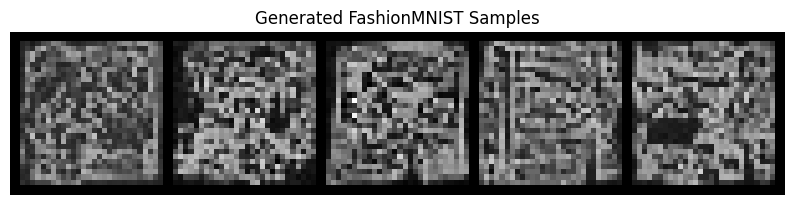

Streaming output truncated to the last 5000 lines.
Shape after adding t_embed_reshaped: torch.Size([32, 128, 7, 7])
Shape after adding c_embed: torch.Size([32, 128, 7, 7])
Shapes before adding embeddings: x shape torch.Size([32, 128, 7, 7]), t_embed shape torch.Size([32, 128]), c_embed shape torch.Size([32, 128, 1, 1])
t_embed_reshaped shape: torch.Size([32, 128, 1, 1])
Shape after adding t_embed_reshaped: torch.Size([32, 128, 7, 7])
Shape after adding c_embed: torch.Size([32, 128, 7, 7])
Shapes before adding embeddings: x shape torch.Size([32, 128, 7, 7]), t_embed shape torch.Size([32, 128]), c_embed shape torch.Size([32, 128, 1, 1])
t_embed_reshaped shape: torch.Size([32, 128, 1, 1])
Shape after adding t_embed_reshaped: torch.Size([32, 128, 7, 7])
Shape after adding c_embed: torch.Size([32, 128, 7, 7])
Shapes before adding embeddings: x shape torch.Size([32, 128, 7, 7]), t_embed shape torch.Size([32, 128]), c_embed shape torch.Size([32, 128, 1, 1])
t_embed_reshaped shape: torch.Size(

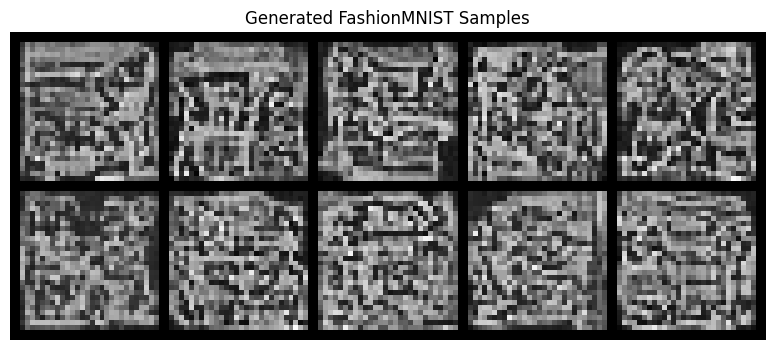

Created backup at best_diffusion_model.pt.backup
Model successfully saved to best_diffusion_model.pt
✓ New best model saved! (Val Loss: 0.1384)

Epoch 16/30
--------------------
Shapes before adding embeddings: x shape torch.Size([32, 128, 7, 7]), t_embed shape torch.Size([32, 128]), c_embed shape torch.Size([32, 128, 1, 1])
t_embed_reshaped shape: torch.Size([32, 128, 1, 1])
Shape after adding t_embed_reshaped: torch.Size([32, 128, 7, 7])
Shape after adding c_embed: torch.Size([32, 128, 7, 7])
  Step 0/1500, Loss: 0.1637
Shapes before adding embeddings: x shape torch.Size([32, 128, 7, 7]), t_embed shape torch.Size([32, 128]), c_embed shape torch.Size([32, 128, 1, 1])
t_embed_reshaped shape: torch.Size([32, 128, 1, 1])
Shape after adding t_embed_reshaped: torch.Size([32, 128, 7, 7])
Shape after adding c_embed: torch.Size([32, 128, 7, 7])
Shapes before adding embeddings: x shape torch.Size([32, 128, 7, 7]), t_embed shape torch.Size([32, 128]), c_embed shape torch.Size([32, 128, 1, 1])
t

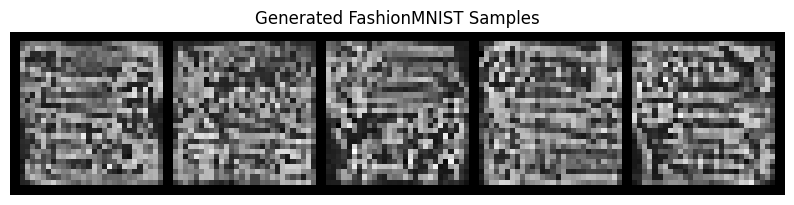

Shapes before adding embeddings: x shape torch.Size([32, 128, 7, 7]), t_embed shape torch.Size([32, 128]), c_embed shape torch.Size([32, 128, 1, 1])
t_embed_reshaped shape: torch.Size([32, 128, 1, 1])
Shape after adding t_embed_reshaped: torch.Size([32, 128, 7, 7])
Shape after adding c_embed: torch.Size([32, 128, 7, 7])
Shapes before adding embeddings: x shape torch.Size([32, 128, 7, 7]), t_embed shape torch.Size([32, 128]), c_embed shape torch.Size([32, 128, 1, 1])
t_embed_reshaped shape: torch.Size([32, 128, 1, 1])
Shape after adding t_embed_reshaped: torch.Size([32, 128, 7, 7])
Shape after adding c_embed: torch.Size([32, 128, 7, 7])
Shapes before adding embeddings: x shape torch.Size([32, 128, 7, 7]), t_embed shape torch.Size([32, 128]), c_embed shape torch.Size([32, 128, 1, 1])
t_embed_reshaped shape: torch.Size([32, 128, 1, 1])
Shape after adding t_embed_reshaped: torch.Size([32, 128, 7, 7])
Shape after adding c_embed: torch.Size([32, 128, 7, 7])
Shapes before adding embeddings: x

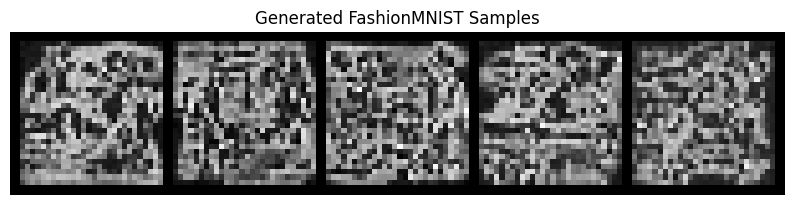

Streaming output truncated to the last 5000 lines.
t_embed_reshaped shape: torch.Size([32, 128, 1, 1])
Shape after adding t_embed_reshaped: torch.Size([32, 128, 7, 7])
Shape after adding c_embed: torch.Size([32, 128, 7, 7])
Shapes before adding embeddings: x shape torch.Size([32, 128, 7, 7]), t_embed shape torch.Size([32, 128]), c_embed shape torch.Size([32, 128, 1, 1])
t_embed_reshaped shape: torch.Size([32, 128, 1, 1])
Shape after adding t_embed_reshaped: torch.Size([32, 128, 7, 7])
Shape after adding c_embed: torch.Size([32, 128, 7, 7])
Shapes before adding embeddings: x shape torch.Size([32, 128, 7, 7]), t_embed shape torch.Size([32, 128]), c_embed shape torch.Size([32, 128, 1, 1])
t_embed_reshaped shape: torch.Size([32, 128, 1, 1])
Shape after adding t_embed_reshaped: torch.Size([32, 128, 7, 7])
Shape after adding c_embed: torch.Size([32, 128, 7, 7])
Shapes before adding embeddings: x shape torch.Size([32, 128, 7, 7]), t_embed shape torch.Size([32, 128]), c_embed shape torch.Size(

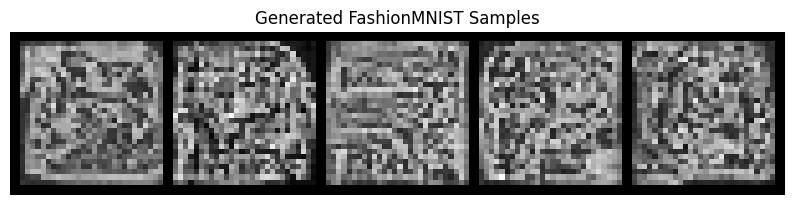

Shapes before adding embeddings: x shape torch.Size([32, 128, 7, 7]), t_embed shape torch.Size([32, 128]), c_embed shape torch.Size([32, 128, 1, 1])
t_embed_reshaped shape: torch.Size([32, 128, 1, 1])
Shape after adding t_embed_reshaped: torch.Size([32, 128, 7, 7])
Shape after adding c_embed: torch.Size([32, 128, 7, 7])
Shapes before adding embeddings: x shape torch.Size([32, 128, 7, 7]), t_embed shape torch.Size([32, 128]), c_embed shape torch.Size([32, 128, 1, 1])
t_embed_reshaped shape: torch.Size([32, 128, 1, 1])
Shape after adding t_embed_reshaped: torch.Size([32, 128, 7, 7])
Shape after adding c_embed: torch.Size([32, 128, 7, 7])
Shapes before adding embeddings: x shape torch.Size([32, 128, 7, 7]), t_embed shape torch.Size([32, 128]), c_embed shape torch.Size([32, 128, 1, 1])
t_embed_reshaped shape: torch.Size([32, 128, 1, 1])
Shape after adding t_embed_reshaped: torch.Size([32, 128, 7, 7])
Shape after adding c_embed: torch.Size([32, 128, 7, 7])
Shapes before adding embeddings: x

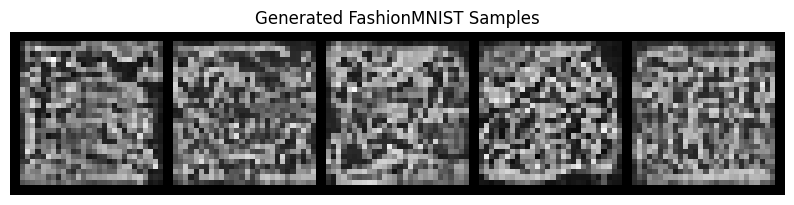

Streaming output truncated to the last 5000 lines.
Shape after adding t_embed_reshaped: torch.Size([32, 128, 7, 7])
Shape after adding c_embed: torch.Size([32, 128, 7, 7])
Shapes before adding embeddings: x shape torch.Size([32, 128, 7, 7]), t_embed shape torch.Size([32, 128]), c_embed shape torch.Size([32, 128, 1, 1])
t_embed_reshaped shape: torch.Size([32, 128, 1, 1])
Shape after adding t_embed_reshaped: torch.Size([32, 128, 7, 7])
Shape after adding c_embed: torch.Size([32, 128, 7, 7])
Shapes before adding embeddings: x shape torch.Size([32, 128, 7, 7]), t_embed shape torch.Size([32, 128]), c_embed shape torch.Size([32, 128, 1, 1])
t_embed_reshaped shape: torch.Size([32, 128, 1, 1])
Shape after adding t_embed_reshaped: torch.Size([32, 128, 7, 7])
Shape after adding c_embed: torch.Size([32, 128, 7, 7])
Shapes before adding embeddings: x shape torch.Size([32, 128, 7, 7]), t_embed shape torch.Size([32, 128]), c_embed shape torch.Size([32, 128, 1, 1])
t_embed_reshaped shape: torch.Size(

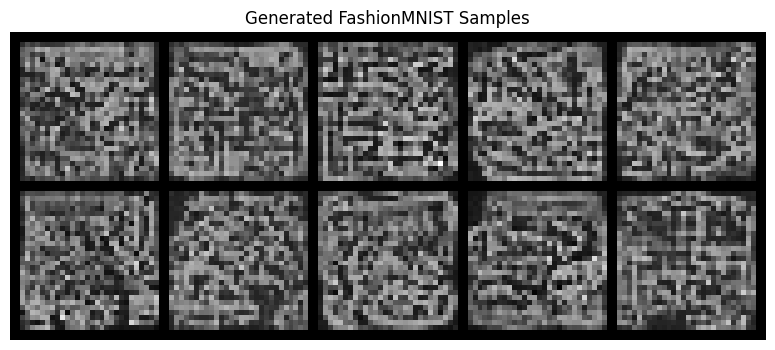

Created backup at best_diffusion_model.pt.backup
Model successfully saved to best_diffusion_model.pt
✓ New best model saved! (Val Loss: 0.1378)

Epoch 18/30
--------------------
Shapes before adding embeddings: x shape torch.Size([32, 128, 7, 7]), t_embed shape torch.Size([32, 128]), c_embed shape torch.Size([32, 128, 1, 1])
t_embed_reshaped shape: torch.Size([32, 128, 1, 1])
Shape after adding t_embed_reshaped: torch.Size([32, 128, 7, 7])
Shape after adding c_embed: torch.Size([32, 128, 7, 7])
  Step 0/1500, Loss: 0.2069
Shapes before adding embeddings: x shape torch.Size([32, 128, 7, 7]), t_embed shape torch.Size([32, 128]), c_embed shape torch.Size([32, 128, 1, 1])
t_embed_reshaped shape: torch.Size([32, 128, 1, 1])
Shape after adding t_embed_reshaped: torch.Size([32, 128, 7, 7])
Shape after adding c_embed: torch.Size([32, 128, 7, 7])
Shapes before adding embeddings: x shape torch.Size([32, 128, 7, 7]), t_embed shape torch.Size([32, 128]), c_embed shape torch.Size([32, 128, 1, 1])
t

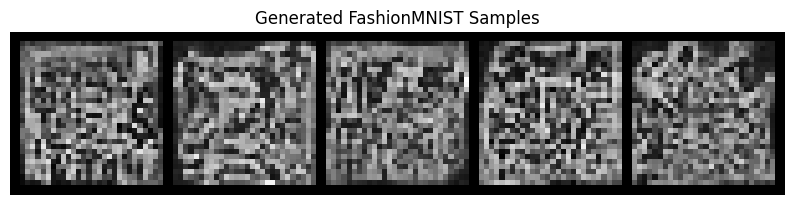

Shapes before adding embeddings: x shape torch.Size([32, 128, 7, 7]), t_embed shape torch.Size([32, 128]), c_embed shape torch.Size([32, 128, 1, 1])
t_embed_reshaped shape: torch.Size([32, 128, 1, 1])
Shape after adding t_embed_reshaped: torch.Size([32, 128, 7, 7])
Shape after adding c_embed: torch.Size([32, 128, 7, 7])
Shapes before adding embeddings: x shape torch.Size([32, 128, 7, 7]), t_embed shape torch.Size([32, 128]), c_embed shape torch.Size([32, 128, 1, 1])
t_embed_reshaped shape: torch.Size([32, 128, 1, 1])
Shape after adding t_embed_reshaped: torch.Size([32, 128, 7, 7])
Shape after adding c_embed: torch.Size([32, 128, 7, 7])
Shapes before adding embeddings: x shape torch.Size([32, 128, 7, 7]), t_embed shape torch.Size([32, 128]), c_embed shape torch.Size([32, 128, 1, 1])
t_embed_reshaped shape: torch.Size([32, 128, 1, 1])
Shape after adding t_embed_reshaped: torch.Size([32, 128, 7, 7])
Shape after adding c_embed: torch.Size([32, 128, 7, 7])
Shapes before adding embeddings: x

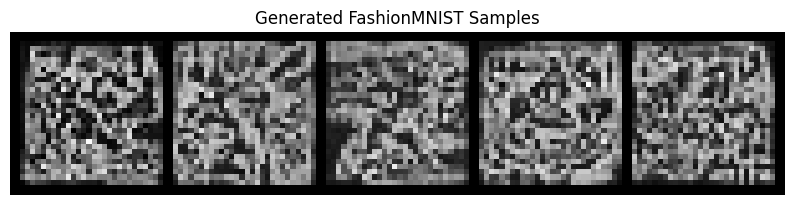

Streaming output truncated to the last 5000 lines.
t_embed_reshaped shape: torch.Size([32, 128, 1, 1])
Shape after adding t_embed_reshaped: torch.Size([32, 128, 7, 7])
Shape after adding c_embed: torch.Size([32, 128, 7, 7])
Shapes before adding embeddings: x shape torch.Size([32, 128, 7, 7]), t_embed shape torch.Size([32, 128]), c_embed shape torch.Size([32, 128, 1, 1])
t_embed_reshaped shape: torch.Size([32, 128, 1, 1])
Shape after adding t_embed_reshaped: torch.Size([32, 128, 7, 7])
Shape after adding c_embed: torch.Size([32, 128, 7, 7])
Shapes before adding embeddings: x shape torch.Size([32, 128, 7, 7]), t_embed shape torch.Size([32, 128]), c_embed shape torch.Size([32, 128, 1, 1])
t_embed_reshaped shape: torch.Size([32, 128, 1, 1])
Shape after adding t_embed_reshaped: torch.Size([32, 128, 7, 7])
Shape after adding c_embed: torch.Size([32, 128, 7, 7])
Shapes before adding embeddings: x shape torch.Size([32, 128, 7, 7]), t_embed shape torch.Size([32, 128]), c_embed shape torch.Size(

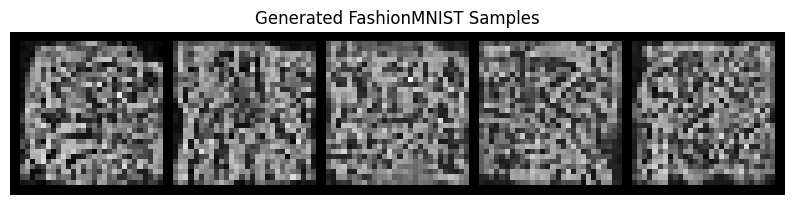

Shapes before adding embeddings: x shape torch.Size([32, 128, 7, 7]), t_embed shape torch.Size([32, 128]), c_embed shape torch.Size([32, 128, 1, 1])
t_embed_reshaped shape: torch.Size([32, 128, 1, 1])
Shape after adding t_embed_reshaped: torch.Size([32, 128, 7, 7])
Shape after adding c_embed: torch.Size([32, 128, 7, 7])
Shapes before adding embeddings: x shape torch.Size([32, 128, 7, 7]), t_embed shape torch.Size([32, 128]), c_embed shape torch.Size([32, 128, 1, 1])
t_embed_reshaped shape: torch.Size([32, 128, 1, 1])
Shape after adding t_embed_reshaped: torch.Size([32, 128, 7, 7])
Shape after adding c_embed: torch.Size([32, 128, 7, 7])
Shapes before adding embeddings: x shape torch.Size([32, 128, 7, 7]), t_embed shape torch.Size([32, 128]), c_embed shape torch.Size([32, 128, 1, 1])
t_embed_reshaped shape: torch.Size([32, 128, 1, 1])
Shape after adding t_embed_reshaped: torch.Size([32, 128, 7, 7])
Shape after adding c_embed: torch.Size([32, 128, 7, 7])
Shapes before adding embeddings: x

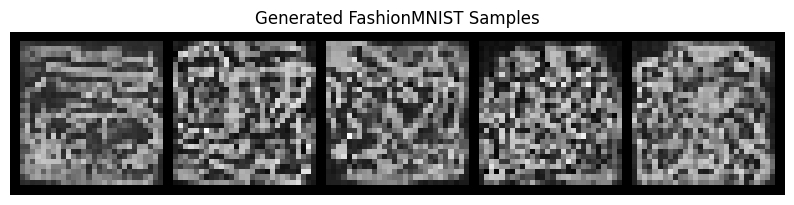

Streaming output truncated to the last 5000 lines.
Shape after adding t_embed_reshaped: torch.Size([32, 128, 7, 7])
Shape after adding c_embed: torch.Size([32, 128, 7, 7])
Shapes before adding embeddings: x shape torch.Size([32, 128, 7, 7]), t_embed shape torch.Size([32, 128]), c_embed shape torch.Size([32, 128, 1, 1])
t_embed_reshaped shape: torch.Size([32, 128, 1, 1])
Shape after adding t_embed_reshaped: torch.Size([32, 128, 7, 7])
Shape after adding c_embed: torch.Size([32, 128, 7, 7])
Shapes before adding embeddings: x shape torch.Size([32, 128, 7, 7]), t_embed shape torch.Size([32, 128]), c_embed shape torch.Size([32, 128, 1, 1])
t_embed_reshaped shape: torch.Size([32, 128, 1, 1])
Shape after adding t_embed_reshaped: torch.Size([32, 128, 7, 7])
Shape after adding c_embed: torch.Size([32, 128, 7, 7])
Shapes before adding embeddings: x shape torch.Size([32, 128, 7, 7]), t_embed shape torch.Size([32, 128]), c_embed shape torch.Size([32, 128, 1, 1])
t_embed_reshaped shape: torch.Size(

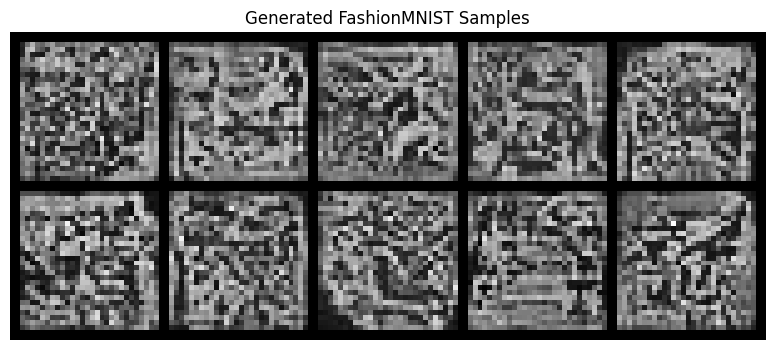

Created backup at best_diffusion_model.pt.backup
Model successfully saved to best_diffusion_model.pt
✓ New best model saved! (Val Loss: 0.1368)

Epoch 20/30
--------------------
Shapes before adding embeddings: x shape torch.Size([32, 128, 7, 7]), t_embed shape torch.Size([32, 128]), c_embed shape torch.Size([32, 128, 1, 1])
t_embed_reshaped shape: torch.Size([32, 128, 1, 1])
Shape after adding t_embed_reshaped: torch.Size([32, 128, 7, 7])
Shape after adding c_embed: torch.Size([32, 128, 7, 7])
  Step 0/1500, Loss: 0.1165
Shapes before adding embeddings: x shape torch.Size([32, 128, 7, 7]), t_embed shape torch.Size([32, 128]), c_embed shape torch.Size([32, 128, 1, 1])
t_embed_reshaped shape: torch.Size([32, 128, 1, 1])
Shape after adding t_embed_reshaped: torch.Size([32, 128, 7, 7])
Shape after adding c_embed: torch.Size([32, 128, 7, 7])
Shapes before adding embeddings: x shape torch.Size([32, 128, 7, 7]), t_embed shape torch.Size([32, 128]), c_embed shape torch.Size([32, 128, 1, 1])
t

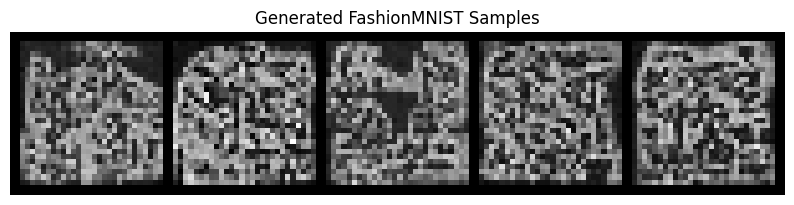

Shapes before adding embeddings: x shape torch.Size([32, 128, 7, 7]), t_embed shape torch.Size([32, 128]), c_embed shape torch.Size([32, 128, 1, 1])
t_embed_reshaped shape: torch.Size([32, 128, 1, 1])
Shape after adding t_embed_reshaped: torch.Size([32, 128, 7, 7])
Shape after adding c_embed: torch.Size([32, 128, 7, 7])
Shapes before adding embeddings: x shape torch.Size([32, 128, 7, 7]), t_embed shape torch.Size([32, 128]), c_embed shape torch.Size([32, 128, 1, 1])
t_embed_reshaped shape: torch.Size([32, 128, 1, 1])
Shape after adding t_embed_reshaped: torch.Size([32, 128, 7, 7])
Shape after adding c_embed: torch.Size([32, 128, 7, 7])
Shapes before adding embeddings: x shape torch.Size([32, 128, 7, 7]), t_embed shape torch.Size([32, 128]), c_embed shape torch.Size([32, 128, 1, 1])
t_embed_reshaped shape: torch.Size([32, 128, 1, 1])
Shape after adding t_embed_reshaped: torch.Size([32, 128, 7, 7])
Shape after adding c_embed: torch.Size([32, 128, 7, 7])
Shapes before adding embeddings: x

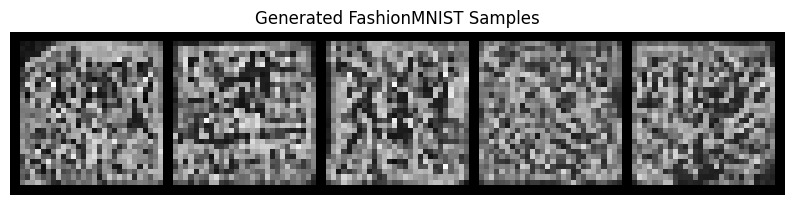

Streaming output truncated to the last 5000 lines.
Shape after adding c_embed: torch.Size([32, 128, 7, 7])
Shapes before adding embeddings: x shape torch.Size([32, 128, 7, 7]), t_embed shape torch.Size([32, 128]), c_embed shape torch.Size([32, 128, 1, 1])
t_embed_reshaped shape: torch.Size([32, 128, 1, 1])
Shape after adding t_embed_reshaped: torch.Size([32, 128, 7, 7])
Shape after adding c_embed: torch.Size([32, 128, 7, 7])
Shapes before adding embeddings: x shape torch.Size([32, 128, 7, 7]), t_embed shape torch.Size([32, 128]), c_embed shape torch.Size([32, 128, 1, 1])
t_embed_reshaped shape: torch.Size([32, 128, 1, 1])
Shape after adding t_embed_reshaped: torch.Size([32, 128, 7, 7])
Shape after adding c_embed: torch.Size([32, 128, 7, 7])
Shapes before adding embeddings: x shape torch.Size([32, 128, 7, 7]), t_embed shape torch.Size([32, 128]), c_embed shape torch.Size([32, 128, 1, 1])
t_embed_reshaped shape: torch.Size([32, 128, 1, 1])
Shape after adding t_embed_reshaped: torch.Size(

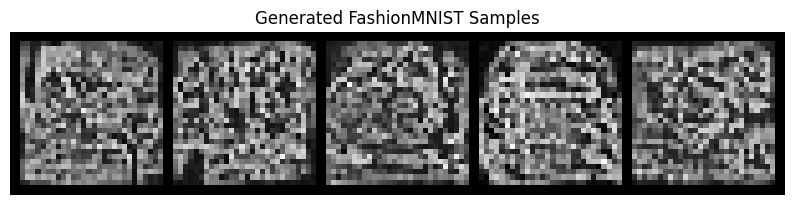

Shapes before adding embeddings: x shape torch.Size([32, 128, 7, 7]), t_embed shape torch.Size([32, 128]), c_embed shape torch.Size([32, 128, 1, 1])
t_embed_reshaped shape: torch.Size([32, 128, 1, 1])
Shape after adding t_embed_reshaped: torch.Size([32, 128, 7, 7])
Shape after adding c_embed: torch.Size([32, 128, 7, 7])
Shapes before adding embeddings: x shape torch.Size([32, 128, 7, 7]), t_embed shape torch.Size([32, 128]), c_embed shape torch.Size([32, 128, 1, 1])
t_embed_reshaped shape: torch.Size([32, 128, 1, 1])
Shape after adding t_embed_reshaped: torch.Size([32, 128, 7, 7])
Shape after adding c_embed: torch.Size([32, 128, 7, 7])
Shapes before adding embeddings: x shape torch.Size([32, 128, 7, 7]), t_embed shape torch.Size([32, 128]), c_embed shape torch.Size([32, 128, 1, 1])
t_embed_reshaped shape: torch.Size([32, 128, 1, 1])
Shape after adding t_embed_reshaped: torch.Size([32, 128, 7, 7])
Shape after adding c_embed: torch.Size([32, 128, 7, 7])
Shapes before adding embeddings: x

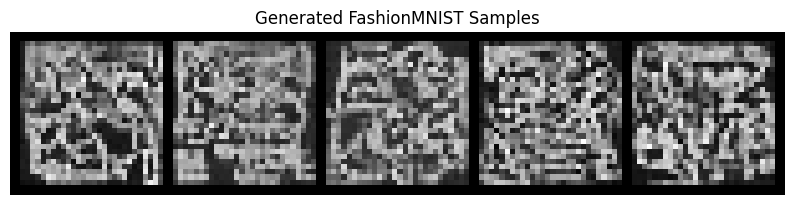

Streaming output truncated to the last 5000 lines.
Shape after adding t_embed_reshaped: torch.Size([32, 128, 7, 7])
Shape after adding c_embed: torch.Size([32, 128, 7, 7])
Shapes before adding embeddings: x shape torch.Size([32, 128, 7, 7]), t_embed shape torch.Size([32, 128]), c_embed shape torch.Size([32, 128, 1, 1])
t_embed_reshaped shape: torch.Size([32, 128, 1, 1])
Shape after adding t_embed_reshaped: torch.Size([32, 128, 7, 7])
Shape after adding c_embed: torch.Size([32, 128, 7, 7])
Shapes before adding embeddings: x shape torch.Size([32, 128, 7, 7]), t_embed shape torch.Size([32, 128]), c_embed shape torch.Size([32, 128, 1, 1])
t_embed_reshaped shape: torch.Size([32, 128, 1, 1])
Shape after adding t_embed_reshaped: torch.Size([32, 128, 7, 7])
Shape after adding c_embed: torch.Size([32, 128, 7, 7])
Shapes before adding embeddings: x shape torch.Size([32, 128, 7, 7]), t_embed shape torch.Size([32, 128]), c_embed shape torch.Size([32, 128, 1, 1])
t_embed_reshaped shape: torch.Size(

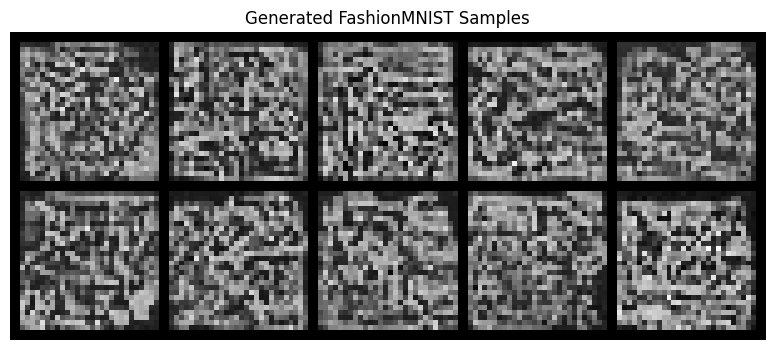

No improvement for 1/10 epochs

Epoch 22/30
--------------------
Shapes before adding embeddings: x shape torch.Size([32, 128, 7, 7]), t_embed shape torch.Size([32, 128]), c_embed shape torch.Size([32, 128, 1, 1])
t_embed_reshaped shape: torch.Size([32, 128, 1, 1])
Shape after adding t_embed_reshaped: torch.Size([32, 128, 7, 7])
Shape after adding c_embed: torch.Size([32, 128, 7, 7])
  Step 0/1500, Loss: 0.1396
Shapes before adding embeddings: x shape torch.Size([32, 128, 7, 7]), t_embed shape torch.Size([32, 128]), c_embed shape torch.Size([32, 128, 1, 1])
t_embed_reshaped shape: torch.Size([32, 128, 1, 1])
Shape after adding t_embed_reshaped: torch.Size([32, 128, 7, 7])
Shape after adding c_embed: torch.Size([32, 128, 7, 7])
Shapes before adding embeddings: x shape torch.Size([32, 128, 7, 7]), t_embed shape torch.Size([32, 128]), c_embed shape torch.Size([32, 128, 1, 1])
t_embed_reshaped shape: torch.Size([32, 128, 1, 1])
Shape after adding t_embed_reshaped: torch.Size([32, 128, 7, 7

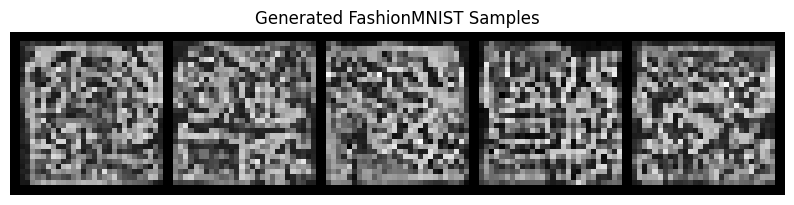

Shapes before adding embeddings: x shape torch.Size([32, 128, 7, 7]), t_embed shape torch.Size([32, 128]), c_embed shape torch.Size([32, 128, 1, 1])
t_embed_reshaped shape: torch.Size([32, 128, 1, 1])
Shape after adding t_embed_reshaped: torch.Size([32, 128, 7, 7])
Shape after adding c_embed: torch.Size([32, 128, 7, 7])
Shapes before adding embeddings: x shape torch.Size([32, 128, 7, 7]), t_embed shape torch.Size([32, 128]), c_embed shape torch.Size([32, 128, 1, 1])
t_embed_reshaped shape: torch.Size([32, 128, 1, 1])
Shape after adding t_embed_reshaped: torch.Size([32, 128, 7, 7])
Shape after adding c_embed: torch.Size([32, 128, 7, 7])
Shapes before adding embeddings: x shape torch.Size([32, 128, 7, 7]), t_embed shape torch.Size([32, 128]), c_embed shape torch.Size([32, 128, 1, 1])
t_embed_reshaped shape: torch.Size([32, 128, 1, 1])
Shape after adding t_embed_reshaped: torch.Size([32, 128, 7, 7])
Shape after adding c_embed: torch.Size([32, 128, 7, 7])
Shapes before adding embeddings: x

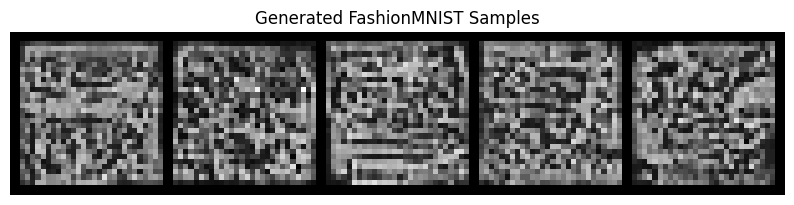

Streaming output truncated to the last 5000 lines.
t_embed_reshaped shape: torch.Size([32, 128, 1, 1])
Shape after adding t_embed_reshaped: torch.Size([32, 128, 7, 7])
Shape after adding c_embed: torch.Size([32, 128, 7, 7])
Shapes before adding embeddings: x shape torch.Size([32, 128, 7, 7]), t_embed shape torch.Size([32, 128]), c_embed shape torch.Size([32, 128, 1, 1])
t_embed_reshaped shape: torch.Size([32, 128, 1, 1])
Shape after adding t_embed_reshaped: torch.Size([32, 128, 7, 7])
Shape after adding c_embed: torch.Size([32, 128, 7, 7])
Shapes before adding embeddings: x shape torch.Size([32, 128, 7, 7]), t_embed shape torch.Size([32, 128]), c_embed shape torch.Size([32, 128, 1, 1])
t_embed_reshaped shape: torch.Size([32, 128, 1, 1])
Shape after adding t_embed_reshaped: torch.Size([32, 128, 7, 7])
Shape after adding c_embed: torch.Size([32, 128, 7, 7])
Shapes before adding embeddings: x shape torch.Size([32, 128, 7, 7]), t_embed shape torch.Size([32, 128]), c_embed shape torch.Size(

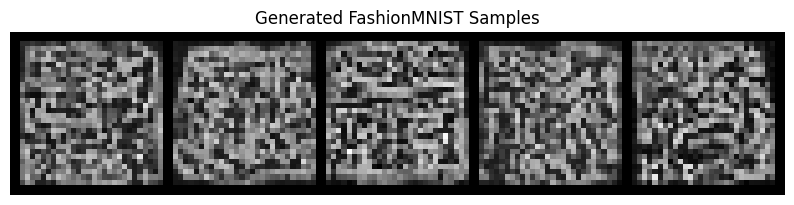

Shapes before adding embeddings: x shape torch.Size([32, 128, 7, 7]), t_embed shape torch.Size([32, 128]), c_embed shape torch.Size([32, 128, 1, 1])
t_embed_reshaped shape: torch.Size([32, 128, 1, 1])
Shape after adding t_embed_reshaped: torch.Size([32, 128, 7, 7])
Shape after adding c_embed: torch.Size([32, 128, 7, 7])
Shapes before adding embeddings: x shape torch.Size([32, 128, 7, 7]), t_embed shape torch.Size([32, 128]), c_embed shape torch.Size([32, 128, 1, 1])
t_embed_reshaped shape: torch.Size([32, 128, 1, 1])
Shape after adding t_embed_reshaped: torch.Size([32, 128, 7, 7])
Shape after adding c_embed: torch.Size([32, 128, 7, 7])
Shapes before adding embeddings: x shape torch.Size([32, 128, 7, 7]), t_embed shape torch.Size([32, 128]), c_embed shape torch.Size([32, 128, 1, 1])
t_embed_reshaped shape: torch.Size([32, 128, 1, 1])
Shape after adding t_embed_reshaped: torch.Size([32, 128, 7, 7])
Shape after adding c_embed: torch.Size([32, 128, 7, 7])
Shapes before adding embeddings: x

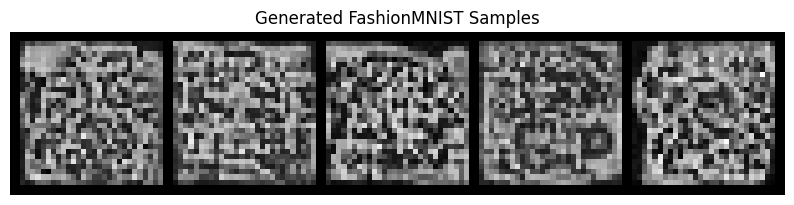

Streaming output truncated to the last 5000 lines.
Shape after adding t_embed_reshaped: torch.Size([32, 128, 7, 7])
Shape after adding c_embed: torch.Size([32, 128, 7, 7])
Shapes before adding embeddings: x shape torch.Size([32, 128, 7, 7]), t_embed shape torch.Size([32, 128]), c_embed shape torch.Size([32, 128, 1, 1])
t_embed_reshaped shape: torch.Size([32, 128, 1, 1])
Shape after adding t_embed_reshaped: torch.Size([32, 128, 7, 7])
Shape after adding c_embed: torch.Size([32, 128, 7, 7])
Shapes before adding embeddings: x shape torch.Size([32, 128, 7, 7]), t_embed shape torch.Size([32, 128]), c_embed shape torch.Size([32, 128, 1, 1])
t_embed_reshaped shape: torch.Size([32, 128, 1, 1])
Shape after adding t_embed_reshaped: torch.Size([32, 128, 7, 7])
Shape after adding c_embed: torch.Size([32, 128, 7, 7])
Shapes before adding embeddings: x shape torch.Size([32, 128, 7, 7]), t_embed shape torch.Size([32, 128]), c_embed shape torch.Size([32, 128, 1, 1])
t_embed_reshaped shape: torch.Size(

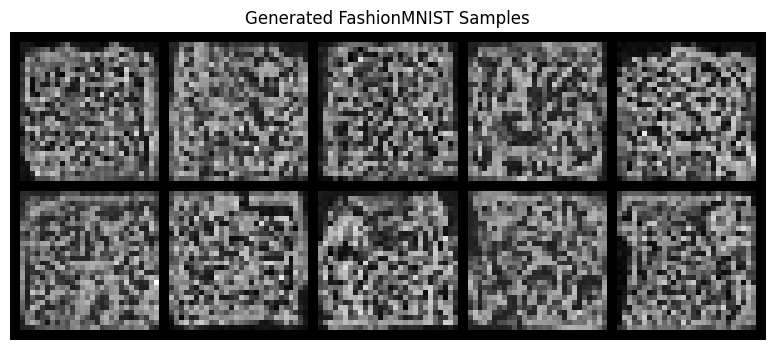

No improvement for 3/10 epochs

Epoch 24/30
--------------------
Shapes before adding embeddings: x shape torch.Size([32, 128, 7, 7]), t_embed shape torch.Size([32, 128]), c_embed shape torch.Size([32, 128, 1, 1])
t_embed_reshaped shape: torch.Size([32, 128, 1, 1])
Shape after adding t_embed_reshaped: torch.Size([32, 128, 7, 7])
Shape after adding c_embed: torch.Size([32, 128, 7, 7])
  Step 0/1500, Loss: 0.1525
Shapes before adding embeddings: x shape torch.Size([32, 128, 7, 7]), t_embed shape torch.Size([32, 128]), c_embed shape torch.Size([32, 128, 1, 1])
t_embed_reshaped shape: torch.Size([32, 128, 1, 1])
Shape after adding t_embed_reshaped: torch.Size([32, 128, 7, 7])
Shape after adding c_embed: torch.Size([32, 128, 7, 7])
Shapes before adding embeddings: x shape torch.Size([32, 128, 7, 7]), t_embed shape torch.Size([32, 128]), c_embed shape torch.Size([32, 128, 1, 1])
t_embed_reshaped shape: torch.Size([32, 128, 1, 1])
Shape after adding t_embed_reshaped: torch.Size([32, 128, 7, 7

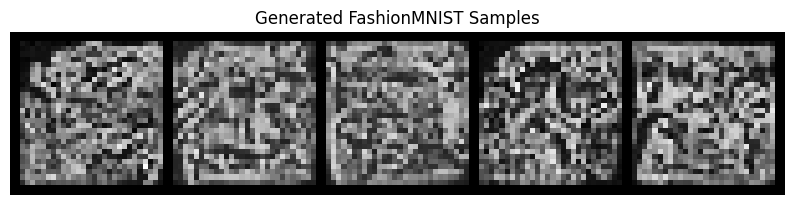

Shapes before adding embeddings: x shape torch.Size([32, 128, 7, 7]), t_embed shape torch.Size([32, 128]), c_embed shape torch.Size([32, 128, 1, 1])
t_embed_reshaped shape: torch.Size([32, 128, 1, 1])
Shape after adding t_embed_reshaped: torch.Size([32, 128, 7, 7])
Shape after adding c_embed: torch.Size([32, 128, 7, 7])
Shapes before adding embeddings: x shape torch.Size([32, 128, 7, 7]), t_embed shape torch.Size([32, 128]), c_embed shape torch.Size([32, 128, 1, 1])
t_embed_reshaped shape: torch.Size([32, 128, 1, 1])
Shape after adding t_embed_reshaped: torch.Size([32, 128, 7, 7])
Shape after adding c_embed: torch.Size([32, 128, 7, 7])
Shapes before adding embeddings: x shape torch.Size([32, 128, 7, 7]), t_embed shape torch.Size([32, 128]), c_embed shape torch.Size([32, 128, 1, 1])
t_embed_reshaped shape: torch.Size([32, 128, 1, 1])
Shape after adding t_embed_reshaped: torch.Size([32, 128, 7, 7])
Shape after adding c_embed: torch.Size([32, 128, 7, 7])
Shapes before adding embeddings: x

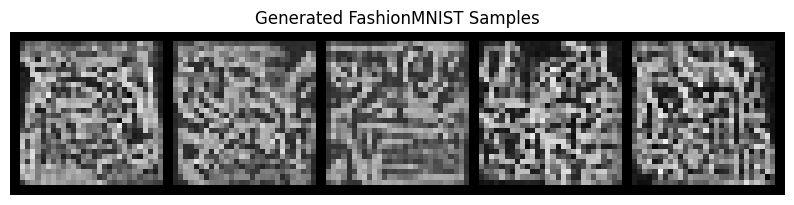

Streaming output truncated to the last 5000 lines.
t_embed_reshaped shape: torch.Size([32, 128, 1, 1])
Shape after adding t_embed_reshaped: torch.Size([32, 128, 7, 7])
Shape after adding c_embed: torch.Size([32, 128, 7, 7])
Shapes before adding embeddings: x shape torch.Size([32, 128, 7, 7]), t_embed shape torch.Size([32, 128]), c_embed shape torch.Size([32, 128, 1, 1])
t_embed_reshaped shape: torch.Size([32, 128, 1, 1])
Shape after adding t_embed_reshaped: torch.Size([32, 128, 7, 7])
Shape after adding c_embed: torch.Size([32, 128, 7, 7])
Shapes before adding embeddings: x shape torch.Size([32, 128, 7, 7]), t_embed shape torch.Size([32, 128]), c_embed shape torch.Size([32, 128, 1, 1])
t_embed_reshaped shape: torch.Size([32, 128, 1, 1])
Shape after adding t_embed_reshaped: torch.Size([32, 128, 7, 7])
Shape after adding c_embed: torch.Size([32, 128, 7, 7])
Shapes before adding embeddings: x shape torch.Size([32, 128, 7, 7]), t_embed shape torch.Size([32, 128]), c_embed shape torch.Size(

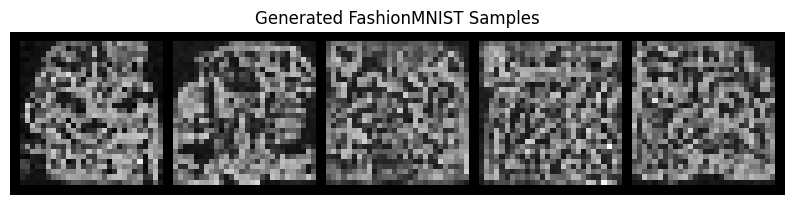

Shapes before adding embeddings: x shape torch.Size([32, 128, 7, 7]), t_embed shape torch.Size([32, 128]), c_embed shape torch.Size([32, 128, 1, 1])
t_embed_reshaped shape: torch.Size([32, 128, 1, 1])
Shape after adding t_embed_reshaped: torch.Size([32, 128, 7, 7])
Shape after adding c_embed: torch.Size([32, 128, 7, 7])
Shapes before adding embeddings: x shape torch.Size([32, 128, 7, 7]), t_embed shape torch.Size([32, 128]), c_embed shape torch.Size([32, 128, 1, 1])
t_embed_reshaped shape: torch.Size([32, 128, 1, 1])
Shape after adding t_embed_reshaped: torch.Size([32, 128, 7, 7])
Shape after adding c_embed: torch.Size([32, 128, 7, 7])
Shapes before adding embeddings: x shape torch.Size([32, 128, 7, 7]), t_embed shape torch.Size([32, 128]), c_embed shape torch.Size([32, 128, 1, 1])
t_embed_reshaped shape: torch.Size([32, 128, 1, 1])
Shape after adding t_embed_reshaped: torch.Size([32, 128, 7, 7])
Shape after adding c_embed: torch.Size([32, 128, 7, 7])
Shapes before adding embeddings: x

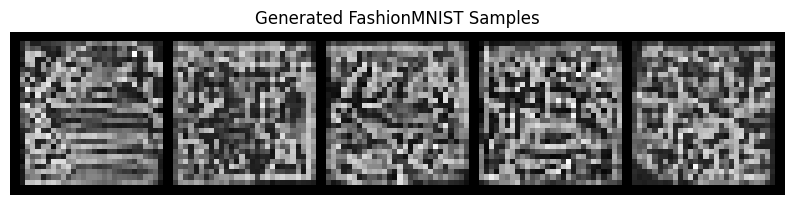

Streaming output truncated to the last 5000 lines.
Shape after adding t_embed_reshaped: torch.Size([32, 128, 7, 7])
Shape after adding c_embed: torch.Size([32, 128, 7, 7])
Shapes before adding embeddings: x shape torch.Size([32, 128, 7, 7]), t_embed shape torch.Size([32, 128]), c_embed shape torch.Size([32, 128, 1, 1])
t_embed_reshaped shape: torch.Size([32, 128, 1, 1])
Shape after adding t_embed_reshaped: torch.Size([32, 128, 7, 7])
Shape after adding c_embed: torch.Size([32, 128, 7, 7])
Shapes before adding embeddings: x shape torch.Size([32, 128, 7, 7]), t_embed shape torch.Size([32, 128]), c_embed shape torch.Size([32, 128, 1, 1])
t_embed_reshaped shape: torch.Size([32, 128, 1, 1])
Shape after adding t_embed_reshaped: torch.Size([32, 128, 7, 7])
Shape after adding c_embed: torch.Size([32, 128, 7, 7])
Shapes before adding embeddings: x shape torch.Size([32, 128, 7, 7]), t_embed shape torch.Size([32, 128]), c_embed shape torch.Size([32, 128, 1, 1])
t_embed_reshaped shape: torch.Size(

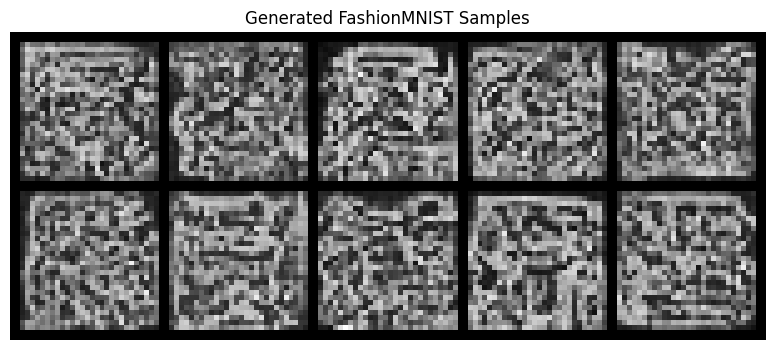

No improvement for 5/10 epochs

Epoch 26/30
--------------------
Shapes before adding embeddings: x shape torch.Size([32, 128, 7, 7]), t_embed shape torch.Size([32, 128]), c_embed shape torch.Size([32, 128, 1, 1])
t_embed_reshaped shape: torch.Size([32, 128, 1, 1])
Shape after adding t_embed_reshaped: torch.Size([32, 128, 7, 7])
Shape after adding c_embed: torch.Size([32, 128, 7, 7])
  Step 0/1500, Loss: 0.1644
Shapes before adding embeddings: x shape torch.Size([32, 128, 7, 7]), t_embed shape torch.Size([32, 128]), c_embed shape torch.Size([32, 128, 1, 1])
t_embed_reshaped shape: torch.Size([32, 128, 1, 1])
Shape after adding t_embed_reshaped: torch.Size([32, 128, 7, 7])
Shape after adding c_embed: torch.Size([32, 128, 7, 7])
Shapes before adding embeddings: x shape torch.Size([32, 128, 7, 7]), t_embed shape torch.Size([32, 128]), c_embed shape torch.Size([32, 128, 1, 1])
t_embed_reshaped shape: torch.Size([32, 128, 1, 1])
Shape after adding t_embed_reshaped: torch.Size([32, 128, 7, 7

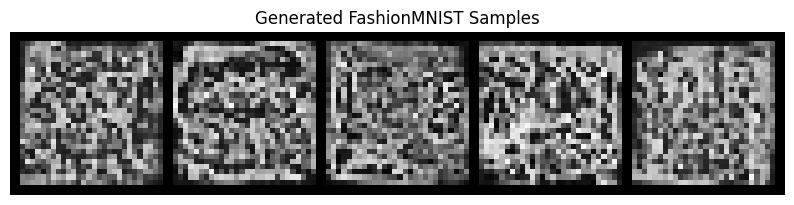

Shapes before adding embeddings: x shape torch.Size([32, 128, 7, 7]), t_embed shape torch.Size([32, 128]), c_embed shape torch.Size([32, 128, 1, 1])
t_embed_reshaped shape: torch.Size([32, 128, 1, 1])
Shape after adding t_embed_reshaped: torch.Size([32, 128, 7, 7])
Shape after adding c_embed: torch.Size([32, 128, 7, 7])
Shapes before adding embeddings: x shape torch.Size([32, 128, 7, 7]), t_embed shape torch.Size([32, 128]), c_embed shape torch.Size([32, 128, 1, 1])
t_embed_reshaped shape: torch.Size([32, 128, 1, 1])
Shape after adding t_embed_reshaped: torch.Size([32, 128, 7, 7])
Shape after adding c_embed: torch.Size([32, 128, 7, 7])
Shapes before adding embeddings: x shape torch.Size([32, 128, 7, 7]), t_embed shape torch.Size([32, 128]), c_embed shape torch.Size([32, 128, 1, 1])
t_embed_reshaped shape: torch.Size([32, 128, 1, 1])
Shape after adding t_embed_reshaped: torch.Size([32, 128, 7, 7])
Shape after adding c_embed: torch.Size([32, 128, 7, 7])
Shapes before adding embeddings: x

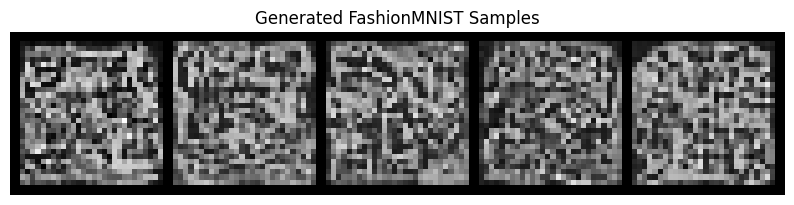

Streaming output truncated to the last 5000 lines.
Shape after adding c_embed: torch.Size([32, 128, 7, 7])
Shapes before adding embeddings: x shape torch.Size([32, 128, 7, 7]), t_embed shape torch.Size([32, 128]), c_embed shape torch.Size([32, 128, 1, 1])
t_embed_reshaped shape: torch.Size([32, 128, 1, 1])
Shape after adding t_embed_reshaped: torch.Size([32, 128, 7, 7])
Shape after adding c_embed: torch.Size([32, 128, 7, 7])
Shapes before adding embeddings: x shape torch.Size([32, 128, 7, 7]), t_embed shape torch.Size([32, 128]), c_embed shape torch.Size([32, 128, 1, 1])
t_embed_reshaped shape: torch.Size([32, 128, 1, 1])
Shape after adding t_embed_reshaped: torch.Size([32, 128, 7, 7])
Shape after adding c_embed: torch.Size([32, 128, 7, 7])
Shapes before adding embeddings: x shape torch.Size([32, 128, 7, 7]), t_embed shape torch.Size([32, 128]), c_embed shape torch.Size([32, 128, 1, 1])
t_embed_reshaped shape: torch.Size([32, 128, 1, 1])
Shape after adding t_embed_reshaped: torch.Size(

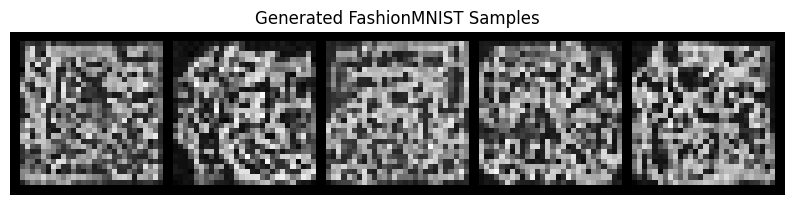

Shapes before adding embeddings: x shape torch.Size([32, 128, 7, 7]), t_embed shape torch.Size([32, 128]), c_embed shape torch.Size([32, 128, 1, 1])
t_embed_reshaped shape: torch.Size([32, 128, 1, 1])
Shape after adding t_embed_reshaped: torch.Size([32, 128, 7, 7])
Shape after adding c_embed: torch.Size([32, 128, 7, 7])
Shapes before adding embeddings: x shape torch.Size([32, 128, 7, 7]), t_embed shape torch.Size([32, 128]), c_embed shape torch.Size([32, 128, 1, 1])
t_embed_reshaped shape: torch.Size([32, 128, 1, 1])
Shape after adding t_embed_reshaped: torch.Size([32, 128, 7, 7])
Shape after adding c_embed: torch.Size([32, 128, 7, 7])
Shapes before adding embeddings: x shape torch.Size([32, 128, 7, 7]), t_embed shape torch.Size([32, 128]), c_embed shape torch.Size([32, 128, 1, 1])
t_embed_reshaped shape: torch.Size([32, 128, 1, 1])
Shape after adding t_embed_reshaped: torch.Size([32, 128, 7, 7])
Shape after adding c_embed: torch.Size([32, 128, 7, 7])
Shapes before adding embeddings: x

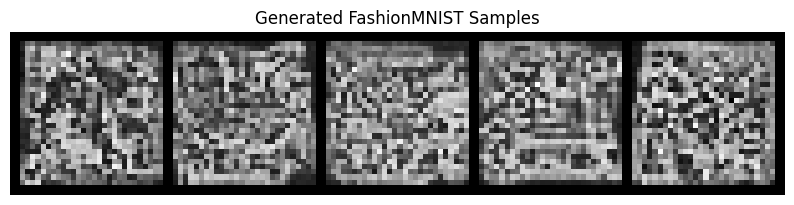

Streaming output truncated to the last 5000 lines.
Shape after adding t_embed_reshaped: torch.Size([32, 128, 7, 7])
Shape after adding c_embed: torch.Size([32, 128, 7, 7])
Shapes before adding embeddings: x shape torch.Size([32, 128, 7, 7]), t_embed shape torch.Size([32, 128]), c_embed shape torch.Size([32, 128, 1, 1])
t_embed_reshaped shape: torch.Size([32, 128, 1, 1])
Shape after adding t_embed_reshaped: torch.Size([32, 128, 7, 7])
Shape after adding c_embed: torch.Size([32, 128, 7, 7])
Shapes before adding embeddings: x shape torch.Size([32, 128, 7, 7]), t_embed shape torch.Size([32, 128]), c_embed shape torch.Size([32, 128, 1, 1])
t_embed_reshaped shape: torch.Size([32, 128, 1, 1])
Shape after adding t_embed_reshaped: torch.Size([32, 128, 7, 7])
Shape after adding c_embed: torch.Size([32, 128, 7, 7])
Shapes before adding embeddings: x shape torch.Size([32, 128, 7, 7]), t_embed shape torch.Size([32, 128]), c_embed shape torch.Size([32, 128, 1, 1])
t_embed_reshaped shape: torch.Size(

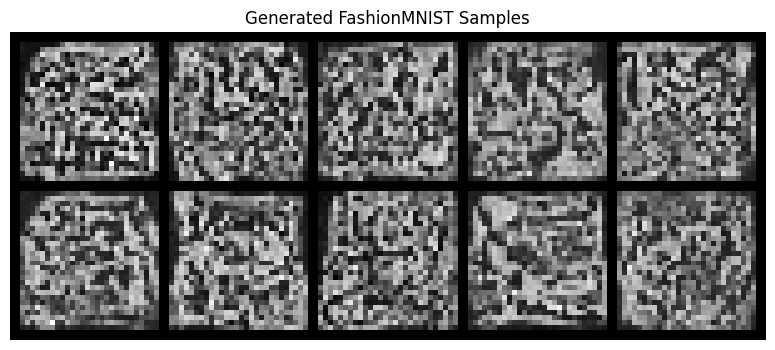

No improvement for 1/10 epochs

Epoch 28/30
--------------------
Shapes before adding embeddings: x shape torch.Size([32, 128, 7, 7]), t_embed shape torch.Size([32, 128]), c_embed shape torch.Size([32, 128, 1, 1])
t_embed_reshaped shape: torch.Size([32, 128, 1, 1])
Shape after adding t_embed_reshaped: torch.Size([32, 128, 7, 7])
Shape after adding c_embed: torch.Size([32, 128, 7, 7])
  Step 0/1500, Loss: 0.1188
Shapes before adding embeddings: x shape torch.Size([32, 128, 7, 7]), t_embed shape torch.Size([32, 128]), c_embed shape torch.Size([32, 128, 1, 1])
t_embed_reshaped shape: torch.Size([32, 128, 1, 1])
Shape after adding t_embed_reshaped: torch.Size([32, 128, 7, 7])
Shape after adding c_embed: torch.Size([32, 128, 7, 7])
Shapes before adding embeddings: x shape torch.Size([32, 128, 7, 7]), t_embed shape torch.Size([32, 128]), c_embed shape torch.Size([32, 128, 1, 1])
t_embed_reshaped shape: torch.Size([32, 128, 1, 1])
Shape after adding t_embed_reshaped: torch.Size([32, 128, 7, 7

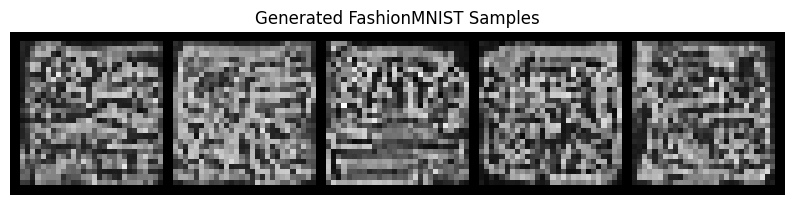

Shapes before adding embeddings: x shape torch.Size([32, 128, 7, 7]), t_embed shape torch.Size([32, 128]), c_embed shape torch.Size([32, 128, 1, 1])
t_embed_reshaped shape: torch.Size([32, 128, 1, 1])
Shape after adding t_embed_reshaped: torch.Size([32, 128, 7, 7])
Shape after adding c_embed: torch.Size([32, 128, 7, 7])
Shapes before adding embeddings: x shape torch.Size([32, 128, 7, 7]), t_embed shape torch.Size([32, 128]), c_embed shape torch.Size([32, 128, 1, 1])
t_embed_reshaped shape: torch.Size([32, 128, 1, 1])
Shape after adding t_embed_reshaped: torch.Size([32, 128, 7, 7])
Shape after adding c_embed: torch.Size([32, 128, 7, 7])
Shapes before adding embeddings: x shape torch.Size([32, 128, 7, 7]), t_embed shape torch.Size([32, 128]), c_embed shape torch.Size([32, 128, 1, 1])
t_embed_reshaped shape: torch.Size([32, 128, 1, 1])
Shape after adding t_embed_reshaped: torch.Size([32, 128, 7, 7])
Shape after adding c_embed: torch.Size([32, 128, 7, 7])
Shapes before adding embeddings: x

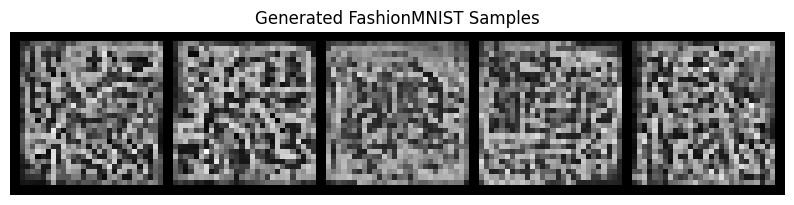

Streaming output truncated to the last 5000 lines.
t_embed_reshaped shape: torch.Size([32, 128, 1, 1])
Shape after adding t_embed_reshaped: torch.Size([32, 128, 7, 7])
Shape after adding c_embed: torch.Size([32, 128, 7, 7])
Shapes before adding embeddings: x shape torch.Size([32, 128, 7, 7]), t_embed shape torch.Size([32, 128]), c_embed shape torch.Size([32, 128, 1, 1])
t_embed_reshaped shape: torch.Size([32, 128, 1, 1])
Shape after adding t_embed_reshaped: torch.Size([32, 128, 7, 7])
Shape after adding c_embed: torch.Size([32, 128, 7, 7])
Shapes before adding embeddings: x shape torch.Size([32, 128, 7, 7]), t_embed shape torch.Size([32, 128]), c_embed shape torch.Size([32, 128, 1, 1])
t_embed_reshaped shape: torch.Size([32, 128, 1, 1])
Shape after adding t_embed_reshaped: torch.Size([32, 128, 7, 7])
Shape after adding c_embed: torch.Size([32, 128, 7, 7])
Shapes before adding embeddings: x shape torch.Size([32, 128, 7, 7]), t_embed shape torch.Size([32, 128]), c_embed shape torch.Size(

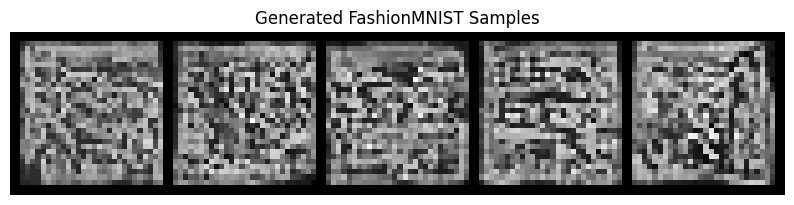

Shapes before adding embeddings: x shape torch.Size([32, 128, 7, 7]), t_embed shape torch.Size([32, 128]), c_embed shape torch.Size([32, 128, 1, 1])
t_embed_reshaped shape: torch.Size([32, 128, 1, 1])
Shape after adding t_embed_reshaped: torch.Size([32, 128, 7, 7])
Shape after adding c_embed: torch.Size([32, 128, 7, 7])
Shapes before adding embeddings: x shape torch.Size([32, 128, 7, 7]), t_embed shape torch.Size([32, 128]), c_embed shape torch.Size([32, 128, 1, 1])
t_embed_reshaped shape: torch.Size([32, 128, 1, 1])
Shape after adding t_embed_reshaped: torch.Size([32, 128, 7, 7])
Shape after adding c_embed: torch.Size([32, 128, 7, 7])
Shapes before adding embeddings: x shape torch.Size([32, 128, 7, 7]), t_embed shape torch.Size([32, 128]), c_embed shape torch.Size([32, 128, 1, 1])
t_embed_reshaped shape: torch.Size([32, 128, 1, 1])
Shape after adding t_embed_reshaped: torch.Size([32, 128, 7, 7])
Shape after adding c_embed: torch.Size([32, 128, 7, 7])
Shapes before adding embeddings: x

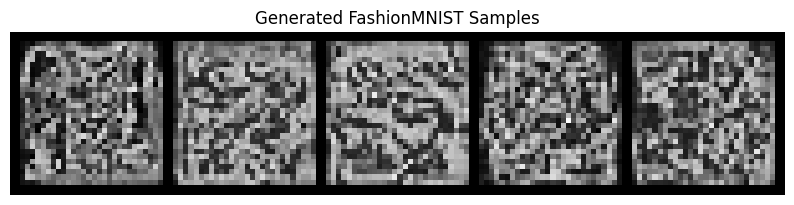

Streaming output truncated to the last 5000 lines.
Shape after adding t_embed_reshaped: torch.Size([32, 128, 7, 7])
Shape after adding c_embed: torch.Size([32, 128, 7, 7])
Shapes before adding embeddings: x shape torch.Size([32, 128, 7, 7]), t_embed shape torch.Size([32, 128]), c_embed shape torch.Size([32, 128, 1, 1])
t_embed_reshaped shape: torch.Size([32, 128, 1, 1])
Shape after adding t_embed_reshaped: torch.Size([32, 128, 7, 7])
Shape after adding c_embed: torch.Size([32, 128, 7, 7])
Shapes before adding embeddings: x shape torch.Size([32, 128, 7, 7]), t_embed shape torch.Size([32, 128]), c_embed shape torch.Size([32, 128, 1, 1])
t_embed_reshaped shape: torch.Size([32, 128, 1, 1])
Shape after adding t_embed_reshaped: torch.Size([32, 128, 7, 7])
Shape after adding c_embed: torch.Size([32, 128, 7, 7])
Shapes before adding embeddings: x shape torch.Size([32, 128, 7, 7]), t_embed shape torch.Size([32, 128]), c_embed shape torch.Size([32, 128, 1, 1])
t_embed_reshaped shape: torch.Size(

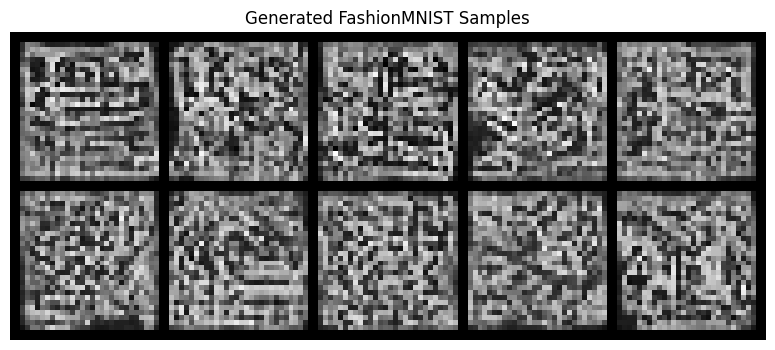

No improvement for 3/10 epochs

Epoch 30/30
--------------------
Shapes before adding embeddings: x shape torch.Size([32, 128, 7, 7]), t_embed shape torch.Size([32, 128]), c_embed shape torch.Size([32, 128, 1, 1])
t_embed_reshaped shape: torch.Size([32, 128, 1, 1])
Shape after adding t_embed_reshaped: torch.Size([32, 128, 7, 7])
Shape after adding c_embed: torch.Size([32, 128, 7, 7])
  Step 0/1500, Loss: 0.1783
Shapes before adding embeddings: x shape torch.Size([32, 128, 7, 7]), t_embed shape torch.Size([32, 128]), c_embed shape torch.Size([32, 128, 1, 1])
t_embed_reshaped shape: torch.Size([32, 128, 1, 1])
Shape after adding t_embed_reshaped: torch.Size([32, 128, 7, 7])
Shape after adding c_embed: torch.Size([32, 128, 7, 7])
Shapes before adding embeddings: x shape torch.Size([32, 128, 7, 7]), t_embed shape torch.Size([32, 128]), c_embed shape torch.Size([32, 128, 1, 1])
t_embed_reshaped shape: torch.Size([32, 128, 1, 1])
Shape after adding t_embed_reshaped: torch.Size([32, 128, 7, 7

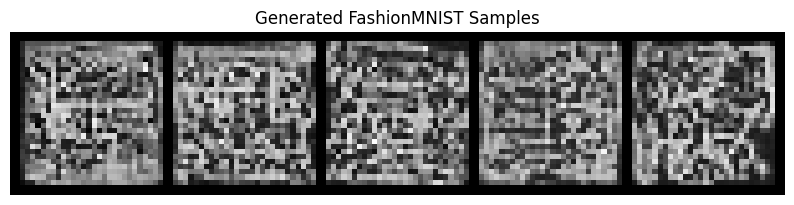

Shapes before adding embeddings: x shape torch.Size([32, 128, 7, 7]), t_embed shape torch.Size([32, 128]), c_embed shape torch.Size([32, 128, 1, 1])
t_embed_reshaped shape: torch.Size([32, 128, 1, 1])
Shape after adding t_embed_reshaped: torch.Size([32, 128, 7, 7])
Shape after adding c_embed: torch.Size([32, 128, 7, 7])
Shapes before adding embeddings: x shape torch.Size([32, 128, 7, 7]), t_embed shape torch.Size([32, 128]), c_embed shape torch.Size([32, 128, 1, 1])
t_embed_reshaped shape: torch.Size([32, 128, 1, 1])
Shape after adding t_embed_reshaped: torch.Size([32, 128, 7, 7])
Shape after adding c_embed: torch.Size([32, 128, 7, 7])
Shapes before adding embeddings: x shape torch.Size([32, 128, 7, 7]), t_embed shape torch.Size([32, 128]), c_embed shape torch.Size([32, 128, 1, 1])
t_embed_reshaped shape: torch.Size([32, 128, 1, 1])
Shape after adding t_embed_reshaped: torch.Size([32, 128, 7, 7])
Shape after adding c_embed: torch.Size([32, 128, 7, 7])
Shapes before adding embeddings: x

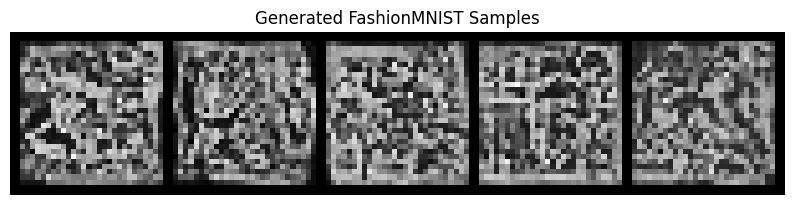

Streaming output truncated to the last 5000 lines.
Shape after adding t_embed_reshaped: torch.Size([32, 128, 7, 7])
Shape after adding c_embed: torch.Size([32, 128, 7, 7])
Shapes before adding embeddings: x shape torch.Size([32, 128, 7, 7]), t_embed shape torch.Size([32, 128]), c_embed shape torch.Size([32, 128, 1, 1])
t_embed_reshaped shape: torch.Size([32, 128, 1, 1])
Shape after adding t_embed_reshaped: torch.Size([32, 128, 7, 7])
Shape after adding c_embed: torch.Size([32, 128, 7, 7])
Shapes before adding embeddings: x shape torch.Size([32, 128, 7, 7]), t_embed shape torch.Size([32, 128]), c_embed shape torch.Size([32, 128, 1, 1])
t_embed_reshaped shape: torch.Size([32, 128, 1, 1])
Shape after adding t_embed_reshaped: torch.Size([32, 128, 7, 7])
Shape after adding c_embed: torch.Size([32, 128, 7, 7])
Shapes before adding embeddings: x shape torch.Size([32, 128, 7, 7]), t_embed shape torch.Size([32, 128]), c_embed shape torch.Size([32, 128, 1, 1])
t_embed_reshaped shape: torch.Size(

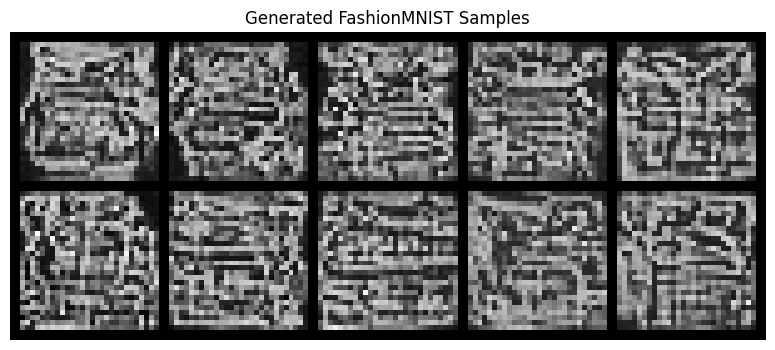

No improvement for 4/10 epochs

TRAINING COMPLETE
Best validation loss: 0.1345
Generating final samples...
Shapes before adding embeddings: x shape torch.Size([1, 128, 7, 7]), t_embed shape torch.Size([1, 128]), c_embed shape torch.Size([1, 128, 1, 1])
t_embed_reshaped shape: torch.Size([1, 128, 1, 1])
Shape after adding t_embed_reshaped: torch.Size([1, 128, 7, 7])
Shape after adding c_embed: torch.Size([1, 128, 7, 7])
Shapes before adding embeddings: x shape torch.Size([1, 128, 7, 7]), t_embed shape torch.Size([1, 128]), c_embed shape torch.Size([1, 128, 1, 1])
t_embed_reshaped shape: torch.Size([1, 128, 1, 1])
Shape after adding t_embed_reshaped: torch.Size([1, 128, 7, 7])
Shape after adding c_embed: torch.Size([1, 128, 7, 7])
Shapes before adding embeddings: x shape torch.Size([1, 128, 7, 7]), t_embed shape torch.Size([1, 128]), c_embed shape torch.Size([1, 128, 1, 1])
t_embed_reshaped shape: torch.Size([1, 128, 1, 1])
Shape after adding t_embed_reshaped: torch.Size([1, 128, 7, 7])


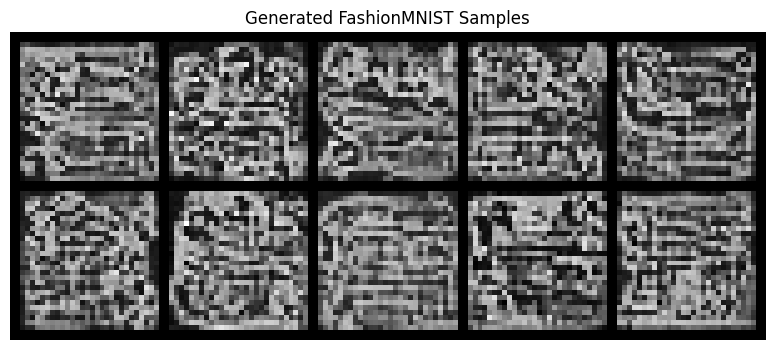

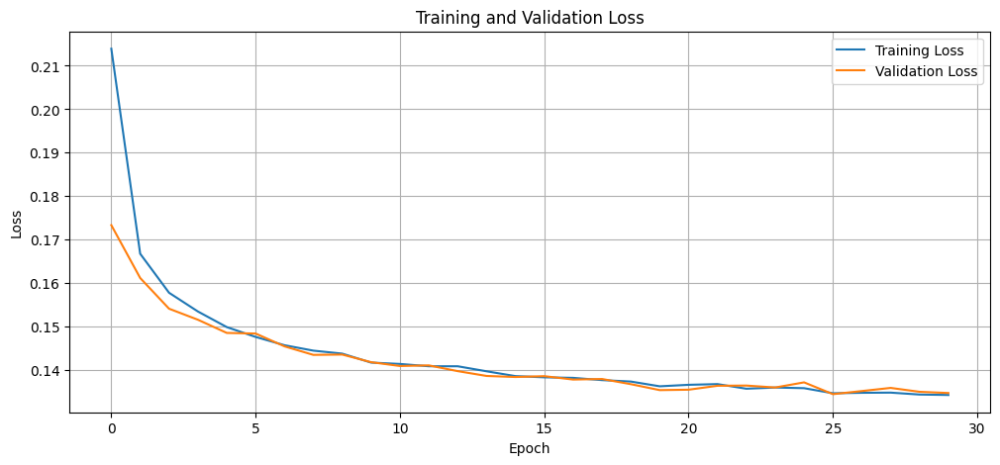

In [70]:
# Implementation of the main training loop
# Training configuration
early_stopping_patience = 10  # Number of epochs without improvement before stopping
gradient_clip_value = 0.5     # Maximum gradient norm for stability
display_frequency = 100       # How often to show progress (in steps)
generate_frequency = 500      # How often to generate samples (in steps)

# Progress tracking variables
best_loss = float('inf')
train_losses = []
val_losses = []
no_improve_epochs = 0

# Training loop
print("\n" + "="*50)
print("STARTING TRAINING")
print("="*50)
model.train()

for epoch in range(EPOCHS):
        print(f"\nEpoch {epoch+1}/{EPOCHS}")
        print("-" * 20)

        # Training phase
        model.train()
        epoch_losses = []

        # Process each batch
        for step, (images, labels) in enumerate(train_dataloader):  # Fixed: dataloader → train_dataloader
            images = images.to(device)
            labels = labels.to(device)

            # Training step
            optimizer.zero_grad()
            loss = train_step(images, labels)
            loss.backward()

            # Add gradient clipping for stability
            torch.nn.utils.clip_grad_norm_(model.parameters(), max_norm=gradient_clip_value)

            optimizer.step()
            epoch_losses.append(loss.item())

            # Show progress at regular intervals
            if step % display_frequency == 0:
                print(f"  Step {step}/{len(train_dataloader)}, Loss: {loss.item():.4f}")

                # Generate samples less frequently to save time
                if step % generate_frequency == 0 and step > 0:
                    print("  Generating samples...")
                    generate_samples(model, n_samples=5)

        # End of epoch - calculate average training loss
        avg_train_loss = sum(epoch_losses) / len(epoch_losses)
        train_losses.append(avg_train_loss)
        print(f"\nTraining - Epoch {epoch+1} average loss: {avg_train_loss:.4f}")

        # Validation phase
        model.eval()
        val_epoch_losses = []
        print("Running validation...")

        with torch.no_grad():  # Disable gradients for validation
            for val_images, val_labels in val_dataloader:
                val_images = val_images.to(device)
                val_labels = val_labels.to(device)

                # Calculate validation loss
                val_loss = train_step(val_images, val_labels)
                val_epoch_losses.append(val_loss.item())

        # Calculate average validation loss
        avg_val_loss = sum(val_epoch_losses) / len(val_epoch_losses)
        val_losses.append(avg_val_loss)
        print(f"Validation - Epoch {epoch+1} average loss: {avg_val_loss:.4f}")

        # Learning rate scheduling based on validation loss
        scheduler.step(avg_val_loss)
        current_lr = scheduler.optimizer.param_groups[0]['lr']
        print(f"Learning rate: {current_lr:.6f}")

        # Generate samples at the end of each epoch
        if epoch % 2 == 0 or epoch == EPOCHS - 1:
            print("\nGenerating samples for visual progress check...")
            generate_samples(model, n_samples=10)

        # Save best model based on validation loss
        if avg_val_loss < best_loss:
            best_loss = avg_val_loss
            # Use safe_save_model instead of just saving state_dict
            safe_save_model(model, 'best_diffusion_model.pt', optimizer, epoch, best_loss)
            print(f"✓ New best model saved! (Val Loss: {best_loss:.4f})")
            no_improve_epochs = 0
        else:
            no_improve_epochs += 1
            print(f"No improvement for {no_improve_epochs}/{early_stopping_patience} epochs")

        # Early stopping
        if no_improve_epochs >= early_stopping_patience:
            print("\nEarly stopping triggered! No improvement in validation loss.")
            break

# Final wrap-up
print("\n" + "="*50)
print("TRAINING COMPLETE")
print("="*50)
print(f"Best validation loss: {best_loss:.4f}")

# Generate final samples
print("Generating final samples...")
generate_samples(model, n_samples=10)

# Display final loss curves
plt.figure(figsize=(12, 5))
plt.plot(train_losses, label='Training Loss')
plt.plot(val_losses, label='Validation Loss')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.title('Training and Validation Loss')
plt.legend()
plt.grid(True)
plt.show()

# Clean up memory
torch.cuda.empty_cache()

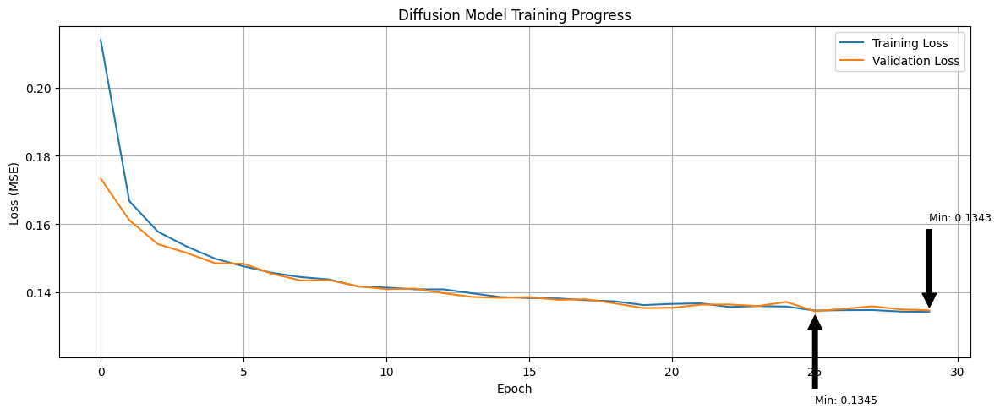


Training Statistics:
------------------------------
Starting training loss:    0.2139
Final training loss:       0.1343
Best training loss:        0.1343
Training loss improvement: 37.2%

Validation Statistics:
------------------------------
Starting validation loss: 0.1733
Final validation loss:    0.1347
Best validation loss:     0.1345


In [71]:
# Plot training progress
plt.figure(figsize=(12, 5))

# Plot training and validation losses for comparison
plt.plot(train_losses, label='Training Loss')
if len(val_losses) > 0:  # Only plot validation if it exists
    plt.plot(val_losses, label='Validation Loss')

# Improve the plot with better labels and styling
plt.title('Diffusion Model Training Progress')
plt.xlabel('Epoch')
plt.ylabel('Loss (MSE)')
plt.legend()
plt.grid(True)

# Add annotations for key points
if len(train_losses) > 1:
    min_train_idx = train_losses.index(min(train_losses))
    plt.annotate(f'Min: {min(train_losses):.4f}',
                 xy=(min_train_idx, min(train_losses)),
                 xytext=(min_train_idx, min(train_losses)*1.2),
                 arrowprops=dict(facecolor='black', shrink=0.05),
                 fontsize=9)

# Add validation min point if available
if len(val_losses) > 1:
    min_val_idx = val_losses.index(min(val_losses))
    plt.annotate(f'Min: {min(val_losses):.4f}',
                xy=(min_val_idx, min(val_losses)),
                xytext=(min_val_idx, min(val_losses)*0.8),
                arrowprops=dict(facecolor='black', shrink=0.05),
                fontsize=9)

# Set y-axis to start from 0 or slightly lower than min value
plt.ylim(bottom=max(0, min(min(train_losses) if train_losses else float('inf'),
                          min(val_losses) if val_losses else float('inf'))*0.9))

plt.tight_layout()
plt.show()

# Add statistics summary for students to analyze
print("\nTraining Statistics:")
print("-" * 30)
if train_losses:
    print(f"Starting training loss:    {train_losses[0]:.4f}")
    print(f"Final training loss:       {train_losses[-1]:.4f}")
    print(f"Best training loss:        {min(train_losses):.4f}")
    print(f"Training loss improvement: {((train_losses[0] - min(train_losses)) / train_losses[0] * 100):.1f}%")

if val_losses:
    print("\nValidation Statistics:")
    print("-" * 30)
    print(f"Starting validation loss: {val_losses[0]:.4f}")
    print(f"Final validation loss:    {val_losses[-1]:.4f}")
    print(f"Best validation loss:     {min(val_losses):.4f}")

# STUDENT EXERCISE:
# 1. Try modifying this plot to show a smoothed version of the losses
# 2. Create a second plot showing the ratio of validation to training loss
#    (which can indicate overfitting when the ratio increases)

## Step 6: Generating New Images

Now that our model is trained, let's generate some new images! We can:
1. Generate specific numbers
2. Generate multiple versions of each number
3. See how the generation process works step by step

Generating 4 versions of number 0...
Shapes before adding embeddings: x shape torch.Size([4, 128, 7, 7]), t_embed shape torch.Size([4, 128]), c_embed shape torch.Size([4, 128, 1, 1])
t_embed_reshaped shape: torch.Size([4, 128, 1, 1])
Shape after adding t_embed_reshaped: torch.Size([4, 128, 7, 7])
Shape after adding c_embed: torch.Size([4, 128, 7, 7])
Shapes before adding embeddings: x shape torch.Size([4, 128, 7, 7]), t_embed shape torch.Size([4, 128]), c_embed shape torch.Size([4, 128, 1, 1])
t_embed_reshaped shape: torch.Size([4, 128, 1, 1])
Shape after adding t_embed_reshaped: torch.Size([4, 128, 7, 7])
Shape after adding c_embed: torch.Size([4, 128, 7, 7])
Shapes before adding embeddings: x shape torch.Size([4, 128, 7, 7]), t_embed shape torch.Size([4, 128]), c_embed shape torch.Size([4, 128, 1, 1])
t_embed_reshaped shape: torch.Size([4, 128, 1, 1])
Shape after adding t_embed_reshaped: torch.Size([4, 128, 7, 7])
Shape after adding c_embed: torch.Size([4, 128, 7, 7])
Shapes before a

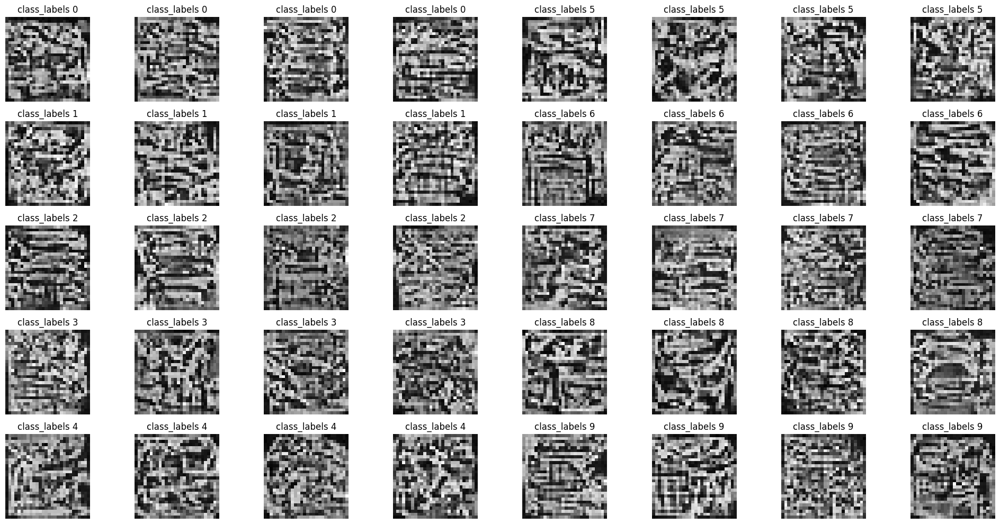


STUDENT ACTIVITY: Generating numbers with different noise seeds


In [72]:
def generate_number(model, number, n_samples=4):
    model.eval()  # Set model to evaluation mode
    with torch.no_grad():  # No need for gradients during generation
        # Start with random noise
        samples = torch.randn(n_samples, IMG_CH, IMG_SIZE, IMG_SIZE).to(device)

        # Set up the number we want to generate
        c = torch.full((n_samples,), number).to(device)
        c_one_hot = F.one_hot(c, N_CLASSES).float().to(device)
        # Correctly sized conditioning mask
        c_mask = torch.ones_like(c.unsqueeze(-1)).to(device)

        # Display progress information
        print(f"Generating {n_samples} versions of number {number}...")

        # Remove noise step by step
        for t in range(n_steps-1, -1, -1):
            t_batch = torch.full((n_samples,), t).to(device)
            samples = remove_noise(samples, t_batch, model, c_one_hot, c_mask)

            # Optional: Display occasional progress updates
            if t % (n_steps // 5) == 0:
                print(f"  Denoising step {n_steps-1-t}/{n_steps-1} completed")

        return samples

class_labels = [
    "T-shirt/top", "Trouser", "Pullover", "Dress", "Coat",
    "Sandal", "Shirt", "Sneaker", "Bag", "Ankle boot"
]

# Generate 4 versions of each number
plt.figure(figsize=(20, 10))
for i in range(10):
    # Generate samples
    samples = generate_number(model, i, n_samples=4)

    # Display each sample
    for j in range(4):
        plt.subplot(5, 8, (i%5)*8 + (i//5)*4 + j + 1)

        # Display the image correctly based on channel configuration
        if IMG_CH == 1:  # Grayscale
            plt.imshow(samples[j][0].cpu(), cmap='gray')
        else:  # Color image
            img = samples[j].permute(1, 2, 0).cpu()
            # Rescale from [-1, 1] to [0, 1] if needed
            if img.min() < 0:
                img = (img + 1) / 2
            plt.imshow(img)

        plt.title(f'class_labels {i}')
        plt.axis('off')

plt.tight_layout()
plt.show()
print("\nSTUDENT ACTIVITY: Generating images with different noise seeds")

# Helper function to generate with seed
def generate_with_seed(number, seed_value=42, n_samples=10):
    torch.manual_seed(seed_value)
    return generate_number(model, number, n_samples)

## Step 7: Watching the Generation Process

Let's see how our model turns random noise into clear images, step by step. This helps us understand how the diffusion process works!


Generating number 0:
Shapes before adding embeddings: x shape torch.Size([1, 128, 7, 7]), t_embed shape torch.Size([1, 128]), c_embed shape torch.Size([1, 128, 1, 1])
t_embed_reshaped shape: torch.Size([1, 128, 1, 1])
Shape after adding t_embed_reshaped: torch.Size([1, 128, 7, 7])
Shape after adding c_embed: torch.Size([1, 128, 7, 7])
Shapes before adding embeddings: x shape torch.Size([1, 128, 7, 7]), t_embed shape torch.Size([1, 128]), c_embed shape torch.Size([1, 128, 1, 1])
t_embed_reshaped shape: torch.Size([1, 128, 1, 1])
Shape after adding t_embed_reshaped: torch.Size([1, 128, 7, 7])
Shape after adding c_embed: torch.Size([1, 128, 7, 7])
Shapes before adding embeddings: x shape torch.Size([1, 128, 7, 7]), t_embed shape torch.Size([1, 128]), c_embed shape torch.Size([1, 128, 1, 1])
t_embed_reshaped shape: torch.Size([1, 128, 1, 1])
Shape after adding t_embed_reshaped: torch.Size([1, 128, 7, 7])
Shape after adding c_embed: torch.Size([1, 128, 7, 7])
Shapes before adding embedding

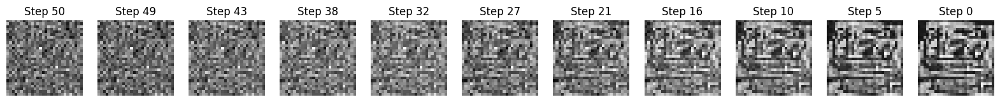


Generating number 3:
Shapes before adding embeddings: x shape torch.Size([1, 128, 7, 7]), t_embed shape torch.Size([1, 128]), c_embed shape torch.Size([1, 128, 1, 1])
t_embed_reshaped shape: torch.Size([1, 128, 1, 1])
Shape after adding t_embed_reshaped: torch.Size([1, 128, 7, 7])
Shape after adding c_embed: torch.Size([1, 128, 7, 7])
Shapes before adding embeddings: x shape torch.Size([1, 128, 7, 7]), t_embed shape torch.Size([1, 128]), c_embed shape torch.Size([1, 128, 1, 1])
t_embed_reshaped shape: torch.Size([1, 128, 1, 1])
Shape after adding t_embed_reshaped: torch.Size([1, 128, 7, 7])
Shape after adding c_embed: torch.Size([1, 128, 7, 7])
Shapes before adding embeddings: x shape torch.Size([1, 128, 7, 7]), t_embed shape torch.Size([1, 128]), c_embed shape torch.Size([1, 128, 1, 1])
t_embed_reshaped shape: torch.Size([1, 128, 1, 1])
Shape after adding t_embed_reshaped: torch.Size([1, 128, 7, 7])
Shape after adding c_embed: torch.Size([1, 128, 7, 7])
Shapes before adding embedding

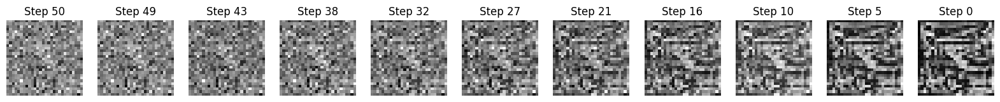


Generating number 7:
Shapes before adding embeddings: x shape torch.Size([1, 128, 7, 7]), t_embed shape torch.Size([1, 128]), c_embed shape torch.Size([1, 128, 1, 1])
t_embed_reshaped shape: torch.Size([1, 128, 1, 1])
Shape after adding t_embed_reshaped: torch.Size([1, 128, 7, 7])
Shape after adding c_embed: torch.Size([1, 128, 7, 7])
Shapes before adding embeddings: x shape torch.Size([1, 128, 7, 7]), t_embed shape torch.Size([1, 128]), c_embed shape torch.Size([1, 128, 1, 1])
t_embed_reshaped shape: torch.Size([1, 128, 1, 1])
Shape after adding t_embed_reshaped: torch.Size([1, 128, 7, 7])
Shape after adding c_embed: torch.Size([1, 128, 7, 7])
Shapes before adding embeddings: x shape torch.Size([1, 128, 7, 7]), t_embed shape torch.Size([1, 128]), c_embed shape torch.Size([1, 128, 1, 1])
t_embed_reshaped shape: torch.Size([1, 128, 1, 1])
Shape after adding t_embed_reshaped: torch.Size([1, 128, 7, 7])
Shape after adding c_embed: torch.Size([1, 128, 7, 7])
Shapes before adding embedding

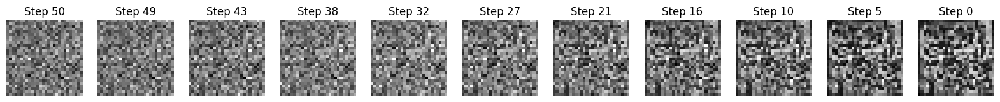

In [73]:
def visualize_generation_steps(model, number, n_preview_steps=10):
    """
    Show how an image evolves from noise to a clear number
    """
    model.eval()
    with torch.no_grad():
        # Start with random noise
        x = torch.randn(1, IMG_CH, IMG_SIZE, IMG_SIZE).to(device)

        # Set up which number to generate
        c = torch.tensor([number]).to(device)
        c_one_hot = F.one_hot(c, N_CLASSES).float().to(device)
        c_mask = torch.tensor([1.0], device=device)

        # Calculate which steps to show
        steps_to_show = torch.linspace(n_steps-1, 0, n_preview_steps).long()

        # Store images for visualization
        images = []
        images.append(x[0].cpu())

        # Remove noise step by step
        for t in range(n_steps-1, -1, -1):
            t_batch = torch.full((1,), t).to(device)
            x = remove_noise(x, t_batch, model, c_one_hot, c_mask)


            if t in steps_to_show:
                images.append(x[0].cpu())

        # Show the progression
        plt.figure(figsize=(20, 3))
        for i, img in enumerate(images):
            plt.subplot(1, len(images), i+1)
            if IMG_CH == 1:
                plt.imshow(img[0], cmap='gray')
            else:
                img = img.permute(1, 2, 0)
                if img.min() < 0:
                    img = (img + 1) / 2
                plt.imshow(img)
            step = n_steps if i == 0 else steps_to_show[i-1]
            plt.title(f'Step {step}')
            plt.axis('off')
        plt.show()

# Show generation process for a few numbers
for number in [0, 3, 7]:
    print(f"\nGenerating number {number}:")
    visualize_generation_steps(model, number)

## Step 8: Adding CLIP Evaluation

[CLIP](https://openai.com/research/clip) is a powerful AI model that can understand both images and text. We'll use it to:
1. Evaluate how realistic our generated images are
2. Score how well they match their intended numbers
3. Help guide the generation process towards better quality

In [74]:
## Step 8: Adding CLIP Evaluation
print("Setting up CLIP (Contrastive Language-Image Pre-training) model...")

# Track installation status
clip_available = False

try:
    # Install dependencies first - these help CLIP process text and images
    print("Installing CLIP dependencies...")
    !pip install -q ftfy regex tqdm

    # Install CLIP from GitHub
    print("Installing CLIP from GitHub repository...")
    !pip install -q git+https://github.com/openai/CLIP.git

    # Import and verify CLIP is working
    print("Importing CLIP...")
    import clip

    # Test that CLIP is functioning
    models = clip.available_models()
    print(f"✓ CLIP installation successful! Available models: {models}")
    clip_available = True

except ImportError:
    print("❌ Error importing CLIP. Installation might have failed.")
    print("Try manually running: !pip install git+https://github.com/openai/CLIP.git")
    print("If you're in a Colab notebook, try restarting the runtime after installation.")

except Exception as e:
    print(f"❌ Error during CLIP setup: {e}")
    print("Some CLIP functionality may not work correctly.")

# Provide guidance based on installation result
if clip_available:
    print("\nCLIP is now available for evaluating your generated images!")
else:
    print("\nWARNING: CLIP installation failed. We'll skip the CLIP evaluation parts.")

# Import necessary libraries
import functools
import torch.nn.functional as F


Setting up CLIP (Contrastive Language-Image Pre-training) model...
Installing CLIP dependencies...
Installing CLIP from GitHub repository...
  Preparing metadata (setup.py) ... done
Importing CLIP...
✓ CLIP installation successful! Available models: ['RN50', 'RN101', 'RN50x4', 'RN50x16', 'RN50x64', 'ViT-B/32', 'ViT-B/16', 'ViT-L/14', 'ViT-L/14@336px']

CLIP is now available for evaluating your generated images!


 Below we are createing  a helper function to manage GPU memory when using CLIP. CLIP can be memory-intensive, so this will help prevent out-of-memory errors:

In [75]:
# Memory management decorator to prevent GPU OOM errors
def manage_gpu_memory(func):
    """
    Decorator that ensures proper GPU memory management.

    This wraps functions that might use large amounts of GPU memory,
    making sure memory is properly freed after function execution.
    """
    @functools.wraps(func)
    def wrapper(*args, **kwargs):
        if torch.cuda.is_available():
            # Clear cache before running function
            torch.cuda.empty_cache()
            try:
                return func(*args, **kwargs)
            except Exception as e:
                # Catch any exception and re-raise after clearing cache
                print(f"An error occurred during {func.__name__}: {e}")
                raise e
            finally:
                # Clear cache after running function regardless of success/failure
                torch.cuda.empty_cache()
        return func(*args, **kwargs)
    return wrapper

❌ Failed to load CLIP model: Model ViT-B/14 not found; available models = ['RN50', 'RN101', 'RN50x4', 'RN50x16', 'RN50x64', 'ViT-B/32', 'ViT-B/16', 'ViT-L/14', 'ViT-L/14@336px']
CLIP evaluation will be skipped. Generated images will still be displayed but without quality scores.

Generating and evaluating T-shirt/top (class 0)...
Generating 4 versions of number 0...
Shapes before adding embeddings: x shape torch.Size([4, 128, 7, 7]), t_embed shape torch.Size([4, 128]), c_embed shape torch.Size([4, 128, 1, 1])
t_embed_reshaped shape: torch.Size([4, 128, 1, 1])
Shape after adding t_embed_reshaped: torch.Size([4, 128, 7, 7])
Shape after adding c_embed: torch.Size([4, 128, 7, 7])
Shapes before adding embeddings: x shape torch.Size([4, 128, 7, 7]), t_embed shape torch.Size([4, 128]), c_embed shape torch.Size([4, 128, 1, 1])
t_embed_reshaped shape: torch.Size([4, 128, 1, 1])
Shape after adding t_embed_reshaped: torch.Size([4, 128, 7, 7])
Shape after adding c_embed: torch.Size([4, 128, 7, 7])

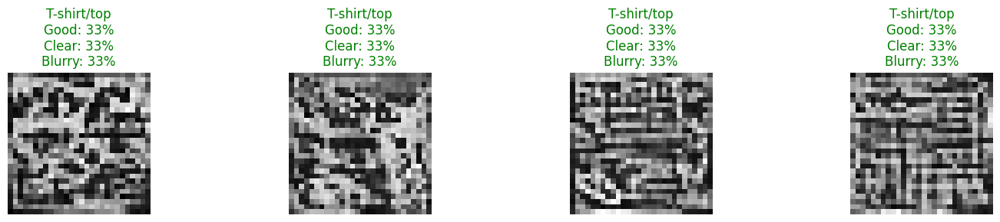


Generating and evaluating Trouser (class 1)...
Generating 4 versions of number 1...
Shapes before adding embeddings: x shape torch.Size([4, 128, 7, 7]), t_embed shape torch.Size([4, 128]), c_embed shape torch.Size([4, 128, 1, 1])
t_embed_reshaped shape: torch.Size([4, 128, 1, 1])
Shape after adding t_embed_reshaped: torch.Size([4, 128, 7, 7])
Shape after adding c_embed: torch.Size([4, 128, 7, 7])
Shapes before adding embeddings: x shape torch.Size([4, 128, 7, 7]), t_embed shape torch.Size([4, 128]), c_embed shape torch.Size([4, 128, 1, 1])
t_embed_reshaped shape: torch.Size([4, 128, 1, 1])
Shape after adding t_embed_reshaped: torch.Size([4, 128, 7, 7])
Shape after adding c_embed: torch.Size([4, 128, 7, 7])
Shapes before adding embeddings: x shape torch.Size([4, 128, 7, 7]), t_embed shape torch.Size([4, 128]), c_embed shape torch.Size([4, 128, 1, 1])
t_embed_reshaped shape: torch.Size([4, 128, 1, 1])
Shape after adding t_embed_reshaped: torch.Size([4, 128, 7, 7])
Shape after adding c_e

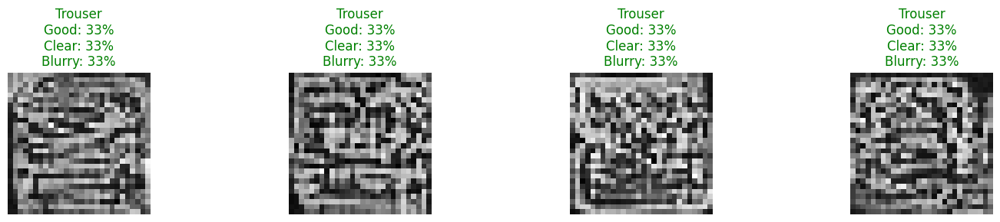


Generating and evaluating Pullover (class 2)...
Generating 4 versions of number 2...
Shapes before adding embeddings: x shape torch.Size([4, 128, 7, 7]), t_embed shape torch.Size([4, 128]), c_embed shape torch.Size([4, 128, 1, 1])
t_embed_reshaped shape: torch.Size([4, 128, 1, 1])
Shape after adding t_embed_reshaped: torch.Size([4, 128, 7, 7])
Shape after adding c_embed: torch.Size([4, 128, 7, 7])
Shapes before adding embeddings: x shape torch.Size([4, 128, 7, 7]), t_embed shape torch.Size([4, 128]), c_embed shape torch.Size([4, 128, 1, 1])
t_embed_reshaped shape: torch.Size([4, 128, 1, 1])
Shape after adding t_embed_reshaped: torch.Size([4, 128, 7, 7])
Shape after adding c_embed: torch.Size([4, 128, 7, 7])
Shapes before adding embeddings: x shape torch.Size([4, 128, 7, 7]), t_embed shape torch.Size([4, 128]), c_embed shape torch.Size([4, 128, 1, 1])
t_embed_reshaped shape: torch.Size([4, 128, 1, 1])
Shape after adding t_embed_reshaped: torch.Size([4, 128, 7, 7])
Shape after adding c_

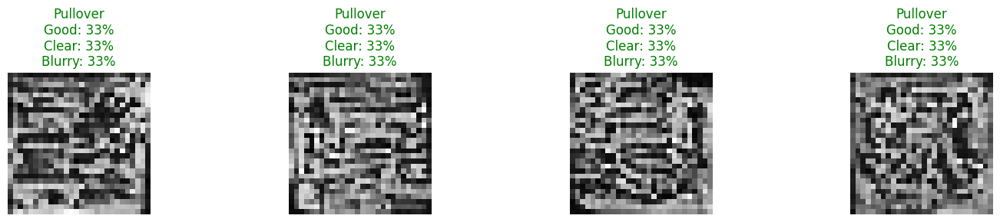


Generating and evaluating Dress (class 3)...
Generating 4 versions of number 3...
Shapes before adding embeddings: x shape torch.Size([4, 128, 7, 7]), t_embed shape torch.Size([4, 128]), c_embed shape torch.Size([4, 128, 1, 1])
t_embed_reshaped shape: torch.Size([4, 128, 1, 1])
Shape after adding t_embed_reshaped: torch.Size([4, 128, 7, 7])
Shape after adding c_embed: torch.Size([4, 128, 7, 7])
Shapes before adding embeddings: x shape torch.Size([4, 128, 7, 7]), t_embed shape torch.Size([4, 128]), c_embed shape torch.Size([4, 128, 1, 1])
t_embed_reshaped shape: torch.Size([4, 128, 1, 1])
Shape after adding t_embed_reshaped: torch.Size([4, 128, 7, 7])
Shape after adding c_embed: torch.Size([4, 128, 7, 7])
Shapes before adding embeddings: x shape torch.Size([4, 128, 7, 7]), t_embed shape torch.Size([4, 128]), c_embed shape torch.Size([4, 128, 1, 1])
t_embed_reshaped shape: torch.Size([4, 128, 1, 1])
Shape after adding t_embed_reshaped: torch.Size([4, 128, 7, 7])
Shape after adding c_emb

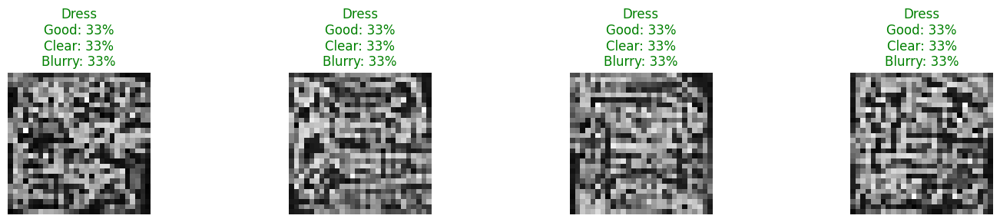


Generating and evaluating Coat (class 4)...
Generating 4 versions of number 4...
Shapes before adding embeddings: x shape torch.Size([4, 128, 7, 7]), t_embed shape torch.Size([4, 128]), c_embed shape torch.Size([4, 128, 1, 1])
t_embed_reshaped shape: torch.Size([4, 128, 1, 1])
Shape after adding t_embed_reshaped: torch.Size([4, 128, 7, 7])
Shape after adding c_embed: torch.Size([4, 128, 7, 7])
Shapes before adding embeddings: x shape torch.Size([4, 128, 7, 7]), t_embed shape torch.Size([4, 128]), c_embed shape torch.Size([4, 128, 1, 1])
t_embed_reshaped shape: torch.Size([4, 128, 1, 1])
Shape after adding t_embed_reshaped: torch.Size([4, 128, 7, 7])
Shape after adding c_embed: torch.Size([4, 128, 7, 7])
Shapes before adding embeddings: x shape torch.Size([4, 128, 7, 7]), t_embed shape torch.Size([4, 128]), c_embed shape torch.Size([4, 128, 1, 1])
t_embed_reshaped shape: torch.Size([4, 128, 1, 1])
Shape after adding t_embed_reshaped: torch.Size([4, 128, 7, 7])
Shape after adding c_embe

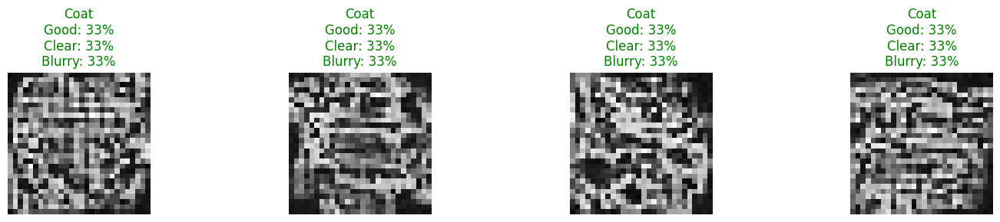


Generating and evaluating Sandal (class 5)...
Generating 4 versions of number 5...
Shapes before adding embeddings: x shape torch.Size([4, 128, 7, 7]), t_embed shape torch.Size([4, 128]), c_embed shape torch.Size([4, 128, 1, 1])
t_embed_reshaped shape: torch.Size([4, 128, 1, 1])
Shape after adding t_embed_reshaped: torch.Size([4, 128, 7, 7])
Shape after adding c_embed: torch.Size([4, 128, 7, 7])
Shapes before adding embeddings: x shape torch.Size([4, 128, 7, 7]), t_embed shape torch.Size([4, 128]), c_embed shape torch.Size([4, 128, 1, 1])
t_embed_reshaped shape: torch.Size([4, 128, 1, 1])
Shape after adding t_embed_reshaped: torch.Size([4, 128, 7, 7])
Shape after adding c_embed: torch.Size([4, 128, 7, 7])
Shapes before adding embeddings: x shape torch.Size([4, 128, 7, 7]), t_embed shape torch.Size([4, 128]), c_embed shape torch.Size([4, 128, 1, 1])
t_embed_reshaped shape: torch.Size([4, 128, 1, 1])
Shape after adding t_embed_reshaped: torch.Size([4, 128, 7, 7])
Shape after adding c_em

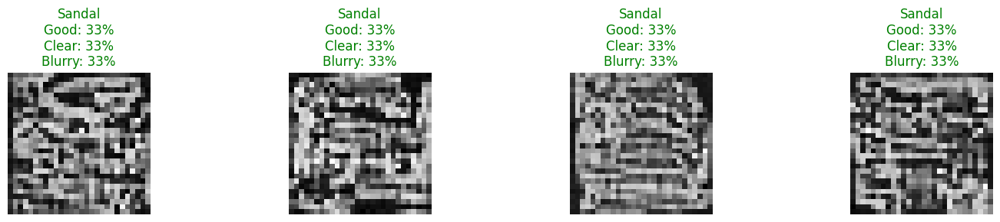


Generating and evaluating Shirt (class 6)...
Generating 4 versions of number 6...
Shapes before adding embeddings: x shape torch.Size([4, 128, 7, 7]), t_embed shape torch.Size([4, 128]), c_embed shape torch.Size([4, 128, 1, 1])
t_embed_reshaped shape: torch.Size([4, 128, 1, 1])
Shape after adding t_embed_reshaped: torch.Size([4, 128, 7, 7])
Shape after adding c_embed: torch.Size([4, 128, 7, 7])
Shapes before adding embeddings: x shape torch.Size([4, 128, 7, 7]), t_embed shape torch.Size([4, 128]), c_embed shape torch.Size([4, 128, 1, 1])
t_embed_reshaped shape: torch.Size([4, 128, 1, 1])
Shape after adding t_embed_reshaped: torch.Size([4, 128, 7, 7])
Shape after adding c_embed: torch.Size([4, 128, 7, 7])
Shapes before adding embeddings: x shape torch.Size([4, 128, 7, 7]), t_embed shape torch.Size([4, 128]), c_embed shape torch.Size([4, 128, 1, 1])
t_embed_reshaped shape: torch.Size([4, 128, 1, 1])
Shape after adding t_embed_reshaped: torch.Size([4, 128, 7, 7])
Shape after adding c_emb

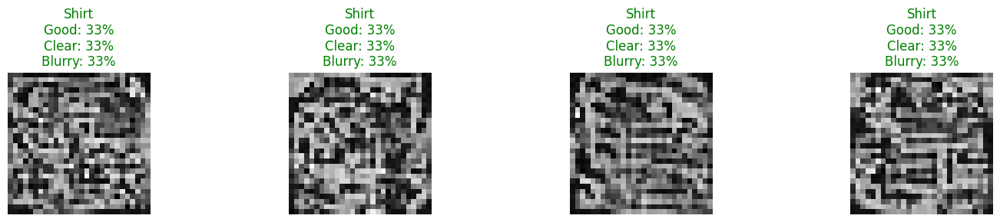


Generating and evaluating Sneaker (class 7)...
Generating 4 versions of number 7...
Shapes before adding embeddings: x shape torch.Size([4, 128, 7, 7]), t_embed shape torch.Size([4, 128]), c_embed shape torch.Size([4, 128, 1, 1])
t_embed_reshaped shape: torch.Size([4, 128, 1, 1])
Shape after adding t_embed_reshaped: torch.Size([4, 128, 7, 7])
Shape after adding c_embed: torch.Size([4, 128, 7, 7])
Shapes before adding embeddings: x shape torch.Size([4, 128, 7, 7]), t_embed shape torch.Size([4, 128]), c_embed shape torch.Size([4, 128, 1, 1])
t_embed_reshaped shape: torch.Size([4, 128, 1, 1])
Shape after adding t_embed_reshaped: torch.Size([4, 128, 7, 7])
Shape after adding c_embed: torch.Size([4, 128, 7, 7])
Shapes before adding embeddings: x shape torch.Size([4, 128, 7, 7]), t_embed shape torch.Size([4, 128]), c_embed shape torch.Size([4, 128, 1, 1])
t_embed_reshaped shape: torch.Size([4, 128, 1, 1])
Shape after adding t_embed_reshaped: torch.Size([4, 128, 7, 7])
Shape after adding c_e

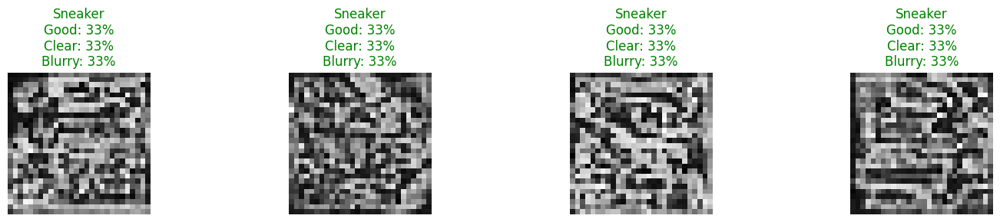


Generating and evaluating Bag (class 8)...
Generating 4 versions of number 8...
Shapes before adding embeddings: x shape torch.Size([4, 128, 7, 7]), t_embed shape torch.Size([4, 128]), c_embed shape torch.Size([4, 128, 1, 1])
t_embed_reshaped shape: torch.Size([4, 128, 1, 1])
Shape after adding t_embed_reshaped: torch.Size([4, 128, 7, 7])
Shape after adding c_embed: torch.Size([4, 128, 7, 7])
Shapes before adding embeddings: x shape torch.Size([4, 128, 7, 7]), t_embed shape torch.Size([4, 128]), c_embed shape torch.Size([4, 128, 1, 1])
t_embed_reshaped shape: torch.Size([4, 128, 1, 1])
Shape after adding t_embed_reshaped: torch.Size([4, 128, 7, 7])
Shape after adding c_embed: torch.Size([4, 128, 7, 7])
Shapes before adding embeddings: x shape torch.Size([4, 128, 7, 7]), t_embed shape torch.Size([4, 128]), c_embed shape torch.Size([4, 128, 1, 1])
t_embed_reshaped shape: torch.Size([4, 128, 1, 1])
Shape after adding t_embed_reshaped: torch.Size([4, 128, 7, 7])
Shape after adding c_embed

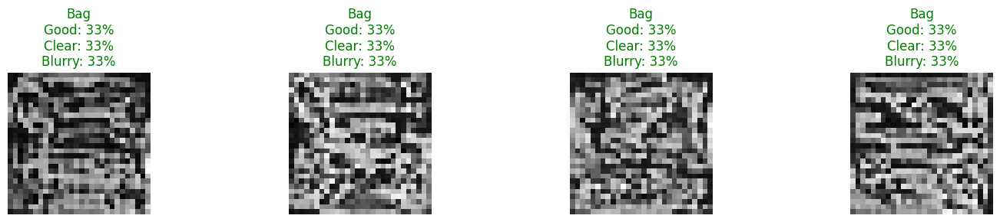


Generating and evaluating Ankle boot (class 9)...
Generating 4 versions of number 9...
Shapes before adding embeddings: x shape torch.Size([4, 128, 7, 7]), t_embed shape torch.Size([4, 128]), c_embed shape torch.Size([4, 128, 1, 1])
t_embed_reshaped shape: torch.Size([4, 128, 1, 1])
Shape after adding t_embed_reshaped: torch.Size([4, 128, 7, 7])
Shape after adding c_embed: torch.Size([4, 128, 7, 7])
Shapes before adding embeddings: x shape torch.Size([4, 128, 7, 7]), t_embed shape torch.Size([4, 128]), c_embed shape torch.Size([4, 128, 1, 1])
t_embed_reshaped shape: torch.Size([4, 128, 1, 1])
Shape after adding t_embed_reshaped: torch.Size([4, 128, 7, 7])
Shape after adding c_embed: torch.Size([4, 128, 7, 7])
Shapes before adding embeddings: x shape torch.Size([4, 128, 7, 7]), t_embed shape torch.Size([4, 128]), c_embed shape torch.Size([4, 128, 1, 1])
t_embed_reshaped shape: torch.Size([4, 128, 1, 1])
Shape after adding t_embed_reshaped: torch.Size([4, 128, 7, 7])
Shape after adding 

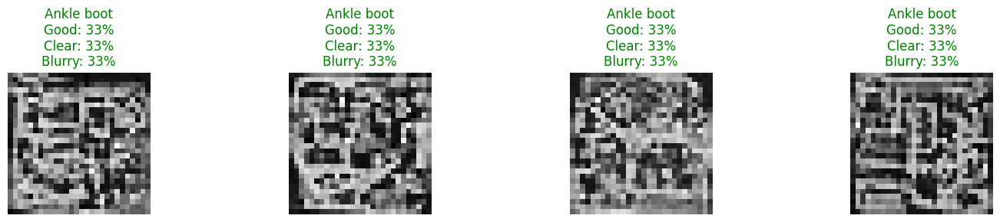


STUDENT ACTIVITY:
Generating 10 versions of number 1...
Shapes before adding embeddings: x shape torch.Size([10, 128, 7, 7]), t_embed shape torch.Size([10, 128]), c_embed shape torch.Size([10, 128, 1, 1])
t_embed_reshaped shape: torch.Size([10, 128, 1, 1])
Shape after adding t_embed_reshaped: torch.Size([10, 128, 7, 7])
Shape after adding c_embed: torch.Size([10, 128, 7, 7])
Shapes before adding embeddings: x shape torch.Size([10, 128, 7, 7]), t_embed shape torch.Size([10, 128]), c_embed shape torch.Size([10, 128, 1, 1])
t_embed_reshaped shape: torch.Size([10, 128, 1, 1])
Shape after adding t_embed_reshaped: torch.Size([10, 128, 7, 7])
Shape after adding c_embed: torch.Size([10, 128, 7, 7])
Shapes before adding embeddings: x shape torch.Size([10, 128, 7, 7]), t_embed shape torch.Size([10, 128]), c_embed shape torch.Size([10, 128, 1, 1])
t_embed_reshaped shape: torch.Size([10, 128, 1, 1])
Shape after adding t_embed_reshaped: torch.Size([10, 128, 7, 7])
Shape after adding c_embed: torch

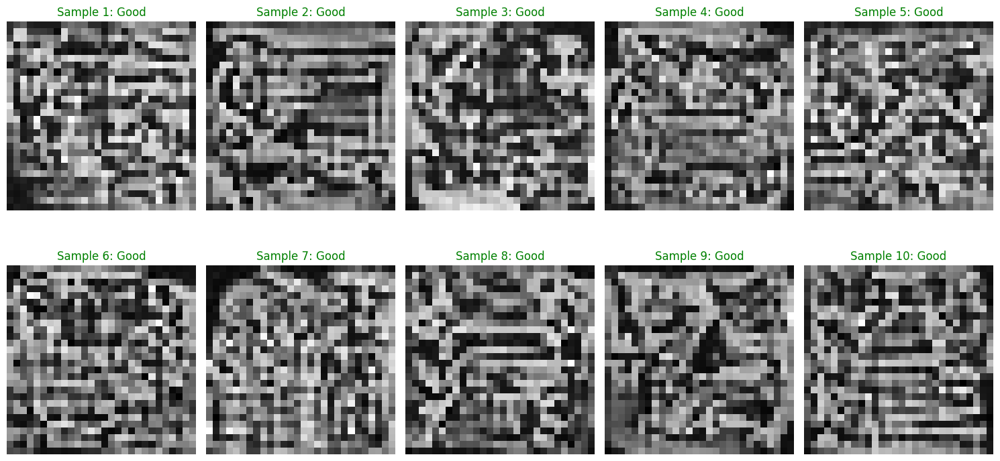

In [84]:
try:
    # Load the ViT-B/32 CLIP model (Vision Transformer-based)
    clip_model, clip_preprocess = clip.load("ViT-B/14", device=device)
    print(f"✓ Successfully loaded CLIP model: {clip_model.visual.__class__.__name__}")
    clip_available = True
except Exception as e:
    print(f"❌ Failed to load CLIP model: {e}")
    clip_available = False
    # Instead of raising an error, we'll continue with degraded functionality
    print("CLIP evaluation will be skipped. Generated images will still be displayed but without quality scores.")

def evaluate_with_clip(images, target_number, max_batch_size=16):
    # Added check for clip_available here, outside the try block
    if not clip_available:
        print("⚠️ CLIP not available. Returning default scores.")
        # Equal probabilities (0.33 for each category)
        return torch.ones(len(images), 3).to(device) / 3

    try:
        # For large batches, we process in chunks to avoid memory issues
        # This is crucial when working with big images or many samples
        if len(images) > max_batch_size:
            all_similarities = []

            # Process images in manageable chunks
            for i in range(0, len(images), max_batch_size):
                print(f"Processing CLIP batch {i//max_batch_size + 1}/{(len(images)-1)//max_batch_size + 1}")
                batch = images[i:i+max_batch_size]

                # Use context managers for efficiency and memory management:
                # - torch.no_grad(): disables gradient tracking (not needed for evaluation)
                # - torch.cuda.amp.autocast(): uses mixed precision to reduce memory usage
                with torch.no_grad(): # Removed autocast for broader compatibility
                    batch_similarities = _process_clip_batch(batch, target_number)
                    all_similarities.append(batch_similarities)

                # Explicitly free GPU memory between batches
                # This helps prevent cumulative memory buildup that could cause crashes
                torch.cuda.empty_cache()

            # Combine results from all batches into a single tensor
            return torch.cat(all_similarities, dim=0)
        else:
            # For small batches, process all at once
            with torch.no_grad(): # Removed autocast for broader compatibility
                return _process_clip_batch(images, target_number)

    except RuntimeError as e:
        # Special handling for CUDA out-of-memory errors
        if "out of memory" in str(e):
            # Free GPU memory immediately
            torch.cuda.empty_cache()

            # If we're already at batch size 1, we can't reduce further
            if len(images) <= 1:
                print("❌ Out of memory even with batch size 1. Cannot process.")
                # Return default scores so the rest of the notebook can continue
                return torch.ones(len(images), 3).to(device) / 3

            # Adaptive batch size reduction - recursively try with smaller batches
            # This is an advanced technique to handle limited GPU memory gracefully
            half_size = len(images) // 2
            print(f"⚠️ Out of memory. Reducing batch size to {half_size}.")

            # Process each half separately and combine results
            # This recursive approach will keep splitting until processing succeeds
            first_half = evaluate_with_clip(images[:half_size], target_number)
            second_half = evaluate_with_clip(images[half_size:], target_number)


            # Combine results from both halves
            return torch.cat([first_half, second_half], dim=0)

        # For other errors, propagate upward
        raise e

def _process_clip_batch(images, target_number):
    # Fashion-MNIST class names for better CLIP evaluation
    fashion_classes = [
        "T-shirt/top", "Trouser", "Pullover", "Dress", "Coat",
        "Sandal", "Shirt", "Sneaker", "Bag", "Ankle boot"
    ]

    try:
        text_inputs = torch.cat([
            clip.tokenize(f"A {fashion_classes[target_number]}"),
            clip.tokenize(f"A clear, well-generated {fashion_classes[target_number]}"),
            clip.tokenize(f"A blurry or unclear clothing item")
        ]).to(device)

        # Process images for CLIP, which requires specific formatting:

        # 1. Handle different channel configurations (dataset-dependent)
        if IMG_CH == 1:
            # CLIP expects RGB images, so we repeat the grayscale channel 3 times
            # For example, MNIST/Fashion-MNIST are grayscale (1-channel)
            images_rgb = images.repeat(1, 3, 1, 1)
        else:
            # For RGB datasets like CIFAR-10/CelebA, we can use as-is
            images_rgb = images

        # 2. Normalize pixel values to [0,1] range if needed
        # Different datasets may have different normalization ranges
        if images_rgb.min() < 0:  # If normalized to [-1,1] range
            images_rgb = (images_rgb + 1) / 2  # Convert to [0,1] range

        # 3. Resize images to CLIP's expected input size (224x224 pixels)
        # CLIP was trained on this specific resolution
        resized_images = F.interpolate(images_rgb, size=(224, 224),
                                      mode='bilinear', align_corners=False)

        # Extract feature embeddings from both images and text prompts
        # These are high-dimensional vectors representing the content
        image_features = clip_model.encode_image(resized_images)
        text_features = clip_model.encode_text(text_inputs)

        # Normalize feature vectors to unit length (for cosine similarity)
        # This ensures we're measuring direction, not magnitude
        image_features = image_features / image_features.norm(dim=-1, keepdim=True)
        text_features = text_features / text_features.norm(dim=-1, keepdim=True)

        # Calculate similarity scores between image and text features
        # The matrix multiplication computes all pairwise dot products at once
        # Multiplying by 100 scales to percentage-like values before applying softmax
        similarity = (100.0 * image_features @ text_features.T).softmax(dim=-1)

        return similarity

    except RuntimeError as e:
        # Special handling for CUDA out-of-memory errors
        if "out of memory" in str(e):
            # Free GPU memory immediately
            torch.cuda.empty_cache()

            # If we're already at batch size 1, we can't reduce further
            if len(images) <= 1:
                print("❌ Out of memory even with batch size 1. Cannot process.")
                # Return default scores so the rest of the notebook can continue
                return torch.ones(len(images), 3).to(device) / 3

            # Adaptive batch size reduction - recursively try with smaller batches
            # This is an advanced technique to handle limited GPU memory gracefully
            half_size = len(images) // 2
            print(f"⚠️ Out of memory. Reducing batch size to {half_size}.")

            # Process each half separately and combine results
            # This recursive approach will keep splitting until processing succeeds
            first_half = evaluate_with_clip(images[:half_size], target_number)
            second_half = evaluate_with_clip(images[half_size:], target_number)


            # Combine results from both halves
            return torch.cat([first_half, second_half], dim=0)

        # For other errors, propagate upward
        raise e

#==============================================================================
# CLIP Evaluation - Generate and Analyze Sample Images
#==============================================================================
# This section demonstrates how to use CLIP to evaluate generated images
# We'll generate examples of all sample images and visualize the quality scores

# Fashion-MNIST class names
fashion_classes = [
    "T-shirt/top", "Trouser", "Pullover", "Dress", "Coat",
    "Sandal", "Shirt", "Sneaker", "Bag", "Ankle boot"
]

try:
    for number in range(10):
        print(f"\nGenerating and evaluating {fashion_classes[number]} (class {number})...")

        # Generate 4 different variations of the images
        samples = generate_number(model, number, n_samples=4)

        # Evaluate quality with CLIP (without tracking gradients for efficiency)
        with torch.no_grad():
            similarities = evaluate_with_clip(samples, number)

        # Create a figure to display results
        plt.figure(figsize=(15, 3))

        # Show each sample with its CLIP quality scores
        for i in range(4):
            plt.subplot(1, 4, i+1)

            # Display the image with appropriate formatting based on dataset type
            if IMG_CH == 1:  # Grayscale images (MNIST, Fashion-MNIST)
                plt.imshow(samples[i][0].cpu(), cmap='gray')
            else:  # Color images (CIFAR-10, CelebA)
                img = samples[i].permute(1, 2, 0).cpu()  # Change format for matplotlib
                if img.min() < 0:  # Handle [-1,1] normalization
                    img = (img + 1) / 2  # Convert to [0,1] range
                plt.imshow(img)

            # Check if similarities were returned (CLIP might have failed to load)
            if similarities is not None and similarities.shape[1] > 2: # Ensure we have at least 3 scores
                # Extract individual quality scores for display
                # These represent how confidently CLIP associates the image with each description
                good_score = similarities[i][0].item() * 100  # Fashion item quality
                clear_score = similarities[i][1].item() * 100  # Clarity quality
                blur_score = similarities[i][2].item() * 100   # Blurriness assessment

                # Color-code the title based on highest score category:
                # - Green: if either "good fashion item" or "clear" score is highest
                # - Red: if "blurry" score is highest (poor quality)
                max_score_idx = torch.argmax(similarities[i]).item()
                title_color = 'green' if max_score_idx < 2 else 'red'

                # Show scores in the plot title
                plt.title(f'{fashion_classes[number]}\nGood: {good_score:.0f}%\nClear: {clear_score:.0f}%\nBlurry: {blur_score:.0f}%',
                          color=title_color)
            else:
                 # Display a generic title if CLIP scores are not available
                 plt.title(f'{fashion_classes[number]}\n(CLIP scores N/A)')


            plt.axis('off')

        plt.tight_layout()
        plt.show()
        plt.close()  # Properly close figure to prevent memory leaks

        # Clean up GPU memory after processing each number
        # This is especially important for resource-constrained environments
        torch.cuda.empty_cache()

except Exception as e:
    # Comprehensive error handling to help students debug issues
    print(f"❌ Error in generation and evaluation loop: {e}")
    print("Detailed error information:")
    import traceback
    traceback.print_exc()

    # Clean up resources even if we encounter an error
    if torch.cuda.is_available():
        print("Clearing GPU cache...")
        torch.cuda.empty_cache()

#==============================================================================
# STUDENT ACTIVITY: Exploring CLIP Evaluation
#==============================================================================
# This section provides code templates for students to experiment with
# evaluating larger batches

print("\nSTUDENT ACTIVITY:")
digit = 1  # Changed to 1 (Trouser) for Fashion-MNIST
samples = generate_number(model, digit, n_samples=10)
similarities = evaluate_with_clip(samples, digit)

# # Calculate what percentage of samples CLIP considers "good quality"
# # (either "good handwritten" or "clear" score exceeds "blurry" score)
if similarities is not None and similarities.shape[1] > 2:
     good_or_clear = (similarities[:,0] + similarities[:,1] > similarities[:,2]).float().mean()
     print(f"CLIP recognized {good_or_clear.item()*100:.1f}% of the samples as good examples of {fashion_classes[digit]}")
else:
     print("CLIP evaluation skipped due to loading error.")

# # Display a grid of samples with their quality scores
plt.figure(figsize=(15, 8))
for i in range(len(samples)):
    plt.subplot(2, 5, i+1)
    # Display based on channel configuration
    if IMG_CH == 1:
        plt.imshow(samples[i][0].cpu(), cmap='gray')
    else:
        img = samples[i].permute(1, 2, 0).cpu()
        if img.min() < 0:
            img = (img + 1) / 2
        plt.imshow(img)

    if similarities is not None and similarities.shape[1] > 2:
        quality = "Good" if similarities[i,0] + similarities[i,1] > similarities[i,2] else "Poor"
        plt.title(f"Sample {i+1}: {quality}", color='green' if quality == "Good" else 'red')
    else:
        plt.title(f"Sample {i+1}: N/A")

    plt.axis('off')
plt.tight_layout()
plt.show()

## Assessment Questions

Now that you've completed the exercise, answer these questions include explanations, observations, and your analysis
Support your answers with specific examples from your experiments:

### 1. Understanding Diffusion
- Explain what happens during the forward diffusion process, using your own words and referencing the visualization examples from your notebook.

- Why do we add noise gradually instead of all at once? How does this affect the learning process?

- Look at the step-by-step visualization - at what point (approximately what percentage through the denoising process) can you first recognize the image? Does this vary by image?

### 2. Model Architecture
- Why is the U-Net architecture particularly well-suited for diffusion models? What advantages does it provide over simpler architectures?

- What are skip connections and why are they important? Explain them in relations to our model

- Describe in detail how our model is conditioned to generate specific images. How does the class conditioning mechanism work?

### 3. Training Analysis (20 points)
- What does the loss value tell of your model tell us?

- How did the quality of  your  generated images change change throughout the training process?

- Why do we need the time embedding in diffusion models? How does it help the model understand where it is in the denoising process?

### 4. CLIP Evaluation (20 points)
- What do the CLIP scores tell you about your generated images? Which  images got  the highest and lowest quality scores?

- Develop a hypothesis explaining why certain images might be easier or harder for the model to generate convincingly.

- How could CLIP scores be used to improve the diffusion model's generation process? Propose a specific technique.

### 5. Practical Applications (20 points)
- How could this type of model be useful in the real world?

- What are the limitations of our current model?

- If you were to continue developing this project, what three specific improvements would you make and why?

### Bonus Challenge (Extra 20 points)
Try one or more of these experiments:
1. If you were to continue developing this project, what three specific improvements would you make and why?

2. Modify the U-Net architecture (e.g., add more layers, increase channel dimensions) and train the model. How do these changes affect training time and generation quality?

3. CLIP-Guided Selection: Generate 10 samples of each image, use CLIP to evaluate them, and select the top 3 highest-quality examples of each. Analyze patterns in what CLIP considers "high quality."

4. tyle Conditioning: Modify the conditioning mechanism to generate multiple styles of the same digit (e.g., slanted, thick, thin). Document your approach and results.


Deliverables:
1. A PDF copy of your notebook with
    - Complete code, outputs, and generated images
    - Include all experiment results, training plots, and generated samples
    - CLIP evaluation scores of ythe images you generated
    - Answers and any interesting findings from the bonus challenges